In [10]:
import requests
import pandas as pd
from bs4 import BeautifulSoup
import os
import json
import requests
import numpy as np
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
import string
import mapclassify
from shapely.ops import unary_union
plt.style.use('ggplot')


# Opening GeoJSONs and exploring data

### Zoning data

In [11]:
zones_geodata = gpd.read_file('CME538_Daniel_Group_Zoning Area - 4326.geojson')
zones_geodata = zones_geodata.set_index(zones_geodata.columns[0])
zones_geodata.head()

,GEN_ZONE,ZN_ZONE,ZN_HOLDING,HOLDING_ID,FRONTAGE,ZN_AREA,UNITS,DENSITY,COVERAGE,FSI_TOTAL,...,ZN_EXCPTN,EXCPTN_NO,STAND_SET,ZN_STATUS,ZN_STRING,AREA_UNITS,ZBL_CHAPT,ZBL_SECTN,ZBL_EXCPTN,geometry
_id,,,,,,,,,,,,,,,,,,,,,
1,2,UT,N,0,-1.0,-1,-1,-1.0,0.0,-1.0,...,N,0,-1,2,UT,-1.0,100,100.10,,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
2,1,ON,N,0,-1.0,-1,-1,-1.0,0.0,-1.0,...,N,0,-1,0,ON,-1.0,90,90.20,,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
3,0,RD,N,0,14.0,510,0,0.0,0.0,-1.0,...,Y,1058,-1,2,RD (f14.0; a510) (x1058),0.0,10,10.20,900.3.10(1058),"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
4,1,O,N,0,-1.0,-1,-1,-1.0,0.0,-1.0,...,N,0,-1,3,O,-1.0,90,90.10,,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
5,0,RD,N,0,0.0,0,0,0.0,0.0,-1.0,...,Y,1040,-1,2,RD (x1040),0.0,10,10.20,900.3.10(1040),"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


From the description of data: 

**ZN_ZONE**

The land use category of the lands within the zone boundary. Each 'zone category' has its own Chapter in the text of By-law 569-2013. Zoned destination of the zone limited by GEN_ZONE. 
- 0 = Residential 
- 1 = Open Space 
- 2 = Utility and Transportation 
- 4 = Employment Industrial 
- 5 = Institutional 
- 6 = Commercial Residential Employment 
- 101 = Residential Apartment 
- 201 = Commercial 
- 202 = Commercial Residential

In [12]:
zones_geodata.GEN_ZONE.unique()

array([  2,   1,   0,   4, 201, 202, 101,   6,   5])

In [13]:
# Only keep zoning type, and geometry, rest is not relevant
zones_geodata_cleaned = zones_geodata[['GEN_ZONE', 'geometry']]

# Rename 'GEN_ZONE' to 'Zone_type'
zones_geodata_cleaned.rename(columns={'GEN_ZONE': 'Zone_type'}, inplace=True)

# Define the mapping for Zone Type values
zone_mapping = {0: 'Residential', 1: 'Open Space', 2: 'Utility and Transportation', 
                4: 'Employment Industrial', 5: 'Institutional',
                6: 'Commercial Residential Employment', 101: 'Residential Apartment', 
                201: 'Commercial', 202: 'Commercial Residential'}

# Replace the values in 'Zone_type' column with the mapped names
zones_geodata_cleaned['Zone_type'] = zones_geodata_cleaned['Zone_type'].replace(zone_mapping)

# Display the first few rows to ensure it worked
zones_geodata_cleaned.head()


C:\Users\aaron\AppData\Local\Temp\ipykernel_15164\1307462323.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  zones_geodata_cleaned.rename(columns={'GEN_ZONE': 'Zone_type'}, inplace=True)
c:\Users\aaron\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,Zone_type,geometry
_id,,
1,Utility and Transportation,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
2,Open Space,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
3,Residential,"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
4,Open Space,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
5,Residential,"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


In [14]:
zones_geodata_cleaned.crs #check crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

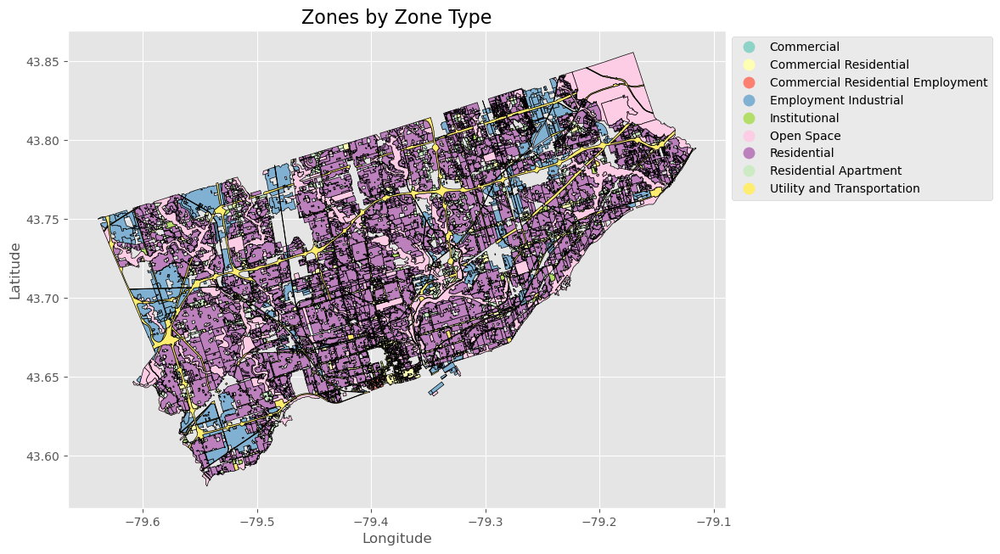

In [15]:
fig, ax = plt.subplots(figsize=(10, 8))

# Plot with categorical coloring based on 'Zone_type'
zones_geodata_cleaned.plot(column='Zone_type', ax=ax, legend=True, 
                           legend_kwds={'bbox_to_anchor': (1, 1), 'loc': 'upper left'}, 
                           cmap='Set3', edgecolor='black')

# Add labels
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)

# Add title
plt.title('Zones by Zone Type', fontsize=16)

# Display the plot
plt.show()

c:\Users\aaron\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


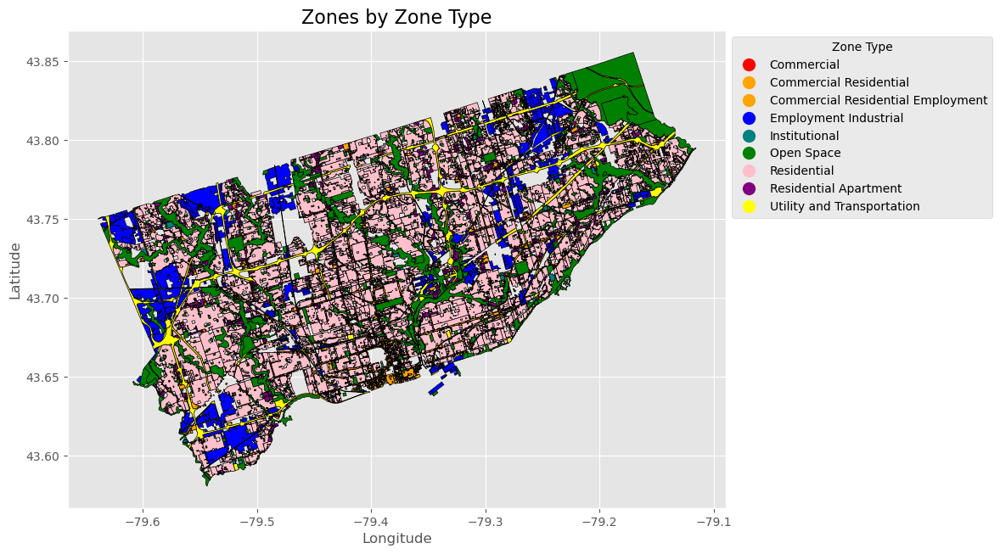

In [16]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Define a dictionary for the specific colors for each Zone_type
custom_colors = {
    'Commercial': 'red',
    'Commercial Residential': 'orange',
    'Commercial Residential Employment': 'orange',
    'Employment Industrial': 'blue',
    'Institutional': 'teal',
    'Open Space': 'green',
    'Residential': 'pink',
    'Residential Apartment': 'purple',
    'Utility and Transportation': 'yellow'
}

# Map Zone_type to colors
zones_geodata_cleaned['color'] = zones_geodata_cleaned['Zone_type'].map(custom_colors)

# Create a custom legend manually
legend_labels = list(custom_colors.keys())
legend_colors = [custom_colors[label] for label in legend_labels]

# Plot with the custom colors
fig, ax = plt.subplots(figsize=(10, 8))
zones_geodata_cleaned.plot(color=zones_geodata_cleaned['color'], ax=ax, edgecolor='black')

# Add custom legend
handles = [plt.Line2D([0], [0], marker='o', color=color, label=label, markersize=10, linestyle='') 
           for label, color in zip(legend_labels, legend_colors)]
ax.legend(handles=handles, title='Zone Type', bbox_to_anchor=(1, 1), loc='upper left')

# Add labels and title
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)
plt.title('Zones by Zone Type', fontsize=16)

# Display the plot
plt.show()


### Greenspace data

In [17]:
greenspace = gpd.read_file('Green Spaces - 4326.geojson')
greenspace = greenspace.set_index(greenspace.columns[0])
greenspace.head()

,AREA_ID,AREA_ATTR_ID,PARENT_AREA_ID,AREA_CLASS_ID,AREA_CLASS,AREA_SHORT_CODE,AREA_LONG_CODE,AREA_NAME,AREA_DESC,OBJECTID,geometry
_id,,,,,,,,,,,
1,1,1,0,890.0,OTHER_CEMETERY,None,4009,ARMADALE FREE METHODIST CEMETERY,ARMADALE FREE METHODIST CEMETERY,1.0,"MULTIPOLYGON (((-79.25752 43.82953, -79.25739 ..."
2,2,2,0,890.0,OTHER_CEMETERY,None,4010,HILLSIDE CEMETERY,HILLSIDE CEMETERY,2.0,"MULTIPOLYGON (((-79.18962 43.82488, -79.18949 ..."
3,3,3,0,890.0,OTHER_CEMETERY,None,4011,HIGHLAND MEMORY GARDENS,HIGHLAND MEMORY GARDENS,3.0,"MULTIPOLYGON (((-79.34758 43.8081, -79.34758 4..."
4,4,4,0,890.0,OTHER_CEMETERY,None,4005,CHRISTIE'S METHODIST CEMETERY,CHRISTIE'S METHODIST CEMETERY,4.0,"MULTIPOLYGON (((-79.31835 43.79902, -79.31851 ..."
5,5,5,0,890.0,OTHER_CEMETERY,None,4012,ST. PAUL'S ANGLICAN CHURCH CEMETERY,ST. PAUL'S ANGLICAN CHURCH CEMETERY,5.0,"MULTIPOLYGON (((-79.31649 43.7964, -79.3165 43..."


In [18]:
greenspace.columns.unique()

Index(['AREA_ID', 'AREA_ATTR_ID', 'PARENT_AREA_ID', 'AREA_CLASS_ID',
       'AREA_CLASS', 'AREA_SHORT_CODE', 'AREA_LONG_CODE', 'AREA_NAME',
       'AREA_DESC', 'OBJECTID', 'geometry'],
      dtype='object')

In [19]:
greenspace_cleaned = greenspace[['AREA_CLASS', 'geometry']]
greenspace_cleaned.rename(columns={'AREA_CLASS': 'Area_type'}, inplace=True)
greenspace_cleaned.head()


C:\Users\aaron\AppData\Local\Temp\ipykernel_15164\3715004460.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  greenspace_cleaned.rename(columns={'AREA_CLASS': 'Area_type'}, inplace=True)


,Area_type,geometry
_id,,
1,OTHER_CEMETERY,"MULTIPOLYGON (((-79.25752 43.82953, -79.25739 ..."
2,OTHER_CEMETERY,"MULTIPOLYGON (((-79.18962 43.82488, -79.18949 ..."
3,OTHER_CEMETERY,"MULTIPOLYGON (((-79.34758 43.8081, -79.34758 4..."
4,OTHER_CEMETERY,"MULTIPOLYGON (((-79.31835 43.79902, -79.31851 ..."
5,OTHER_CEMETERY,"MULTIPOLYGON (((-79.31649 43.7964, -79.3165 43..."


In [20]:
greenspace_cleaned.crs #check crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

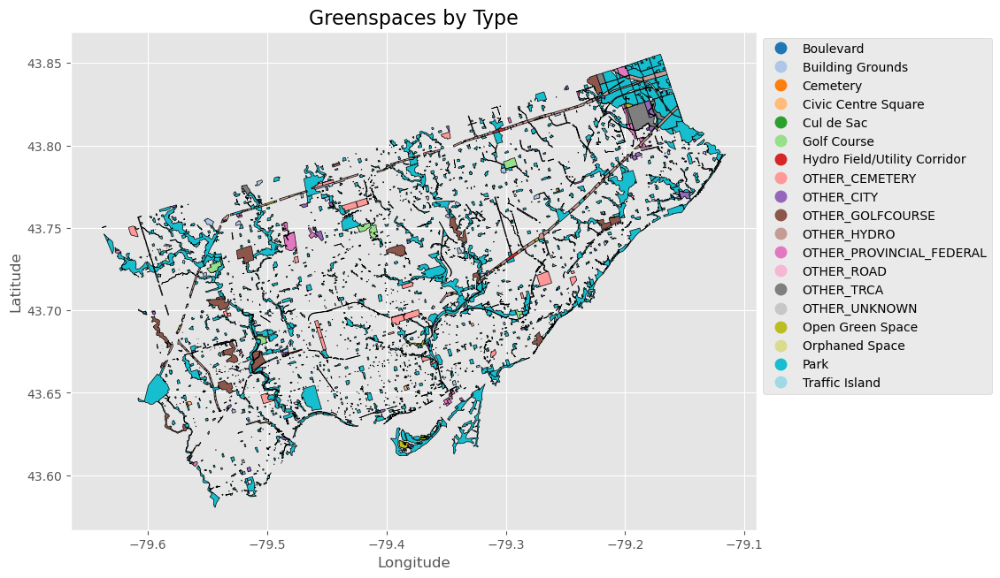

In [21]:
fig, ax = plt.subplots(figsize=(10, 8))

# Plot with categorical coloring based on 'Zone_type'
greenspace_cleaned.plot(column='Area_type', ax=ax, legend=True, 
                           legend_kwds={'bbox_to_anchor': (1, 1), 'loc': 'upper left'}, 
                           cmap='tab20', edgecolor='black')

# Add labels
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)

# Add title
plt.title('Greenspaces by Type', fontsize=16)

# Display the plot
plt.show()

### Flood plains data

In [22]:
flood_plains = gpd.read_file('Floodline GeoJson Format.geojson')
flood_plains = flood_plains.set_index(flood_plains.columns[0])
flood_plains.head()


,FloodPlain,Watershed,Shape__Are,Shape__Len,geometry
OBJECTID,,,,,
3394,Engineered,Don River,0.940918,3.803569,"MULTIPOLYGON (((-79.36482 43.67112, -79.36482 ..."
3395,Engineered,Don River,869.856689,149.201240,"MULTIPOLYGON (((-79.38004 43.67332, -79.38004 ..."
3396,Engineered,Don River,23187.910400,1321.226703,"MULTIPOLYGON (((-79.37672 43.6735, -79.37671 4..."
3397,Engineered,Don River,10895.613037,522.001575,"MULTIPOLYGON (((-79.3784 43.67362, -79.3784 43..."
3406,Engineered,Humber River,0.544922,5.605709,"MULTIPOLYGON (((-79.5036 43.71073, -79.5036 43..."


In [23]:
flood_plains.crs #check crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

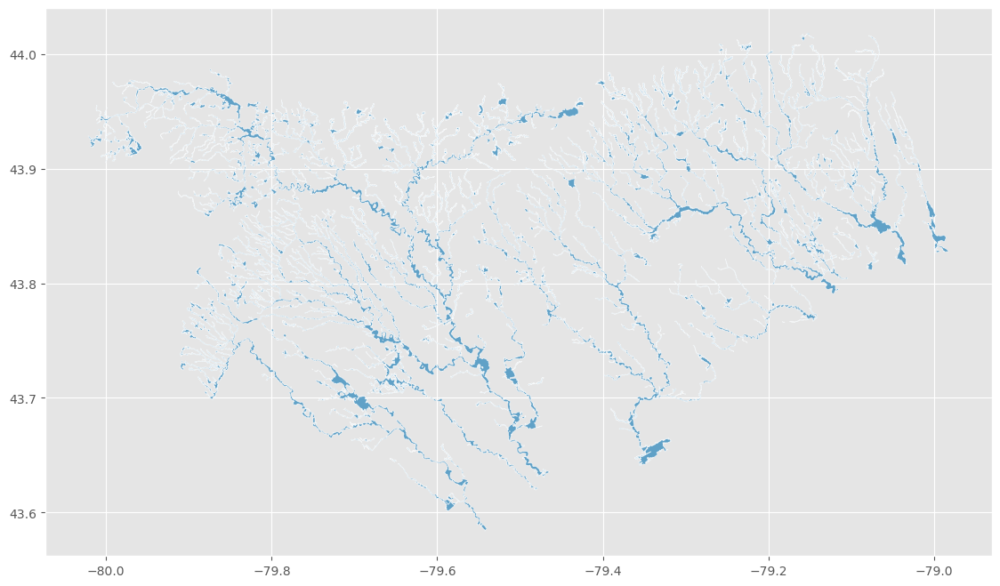

In [24]:
# Test plotting
flood_plains.plot(figsize=(15, 8), edgecolor='w', alpha=0.75);

### Neighbourhood data

In [25]:
neighbourhoods_geodata = gpd.read_file('Neighbourhoods - 4326.geojson')
neighbourhoods_geodata.head()

,_id,AREA_ID,AREA_ATTR_ID,PARENT_AREA_ID,AREA_SHORT_CODE,AREA_LONG_CODE,AREA_NAME,AREA_DESC,CLASSIFICATION,CLASSIFICATION_CODE,OBJECTID,geometry
0,1,2502366,26022881,0,174,174,South Eglinton-Davisville,South Eglinton-Davisville (174),Not an NIA or Emerging Neighbourhood,NA,17824737.0,"MULTIPOLYGON (((-79.38635 43.69783, -79.38623 ..."
1,2,2502365,26022880,0,173,173,North Toronto,North Toronto (173),Not an NIA or Emerging Neighbourhood,NA,17824753.0,"MULTIPOLYGON (((-79.39744 43.70693, -79.39837 ..."
2,3,2502364,26022879,0,172,172,Dovercourt Village,Dovercourt Village (172),Not an NIA or Emerging Neighbourhood,NA,17824769.0,"MULTIPOLYGON (((-79.43411 43.66015, -79.43537 ..."
3,4,2502363,26022878,0,171,171,Junction-Wallace Emerson,Junction-Wallace Emerson (171),Not an NIA or Emerging Neighbourhood,NA,17824785.0,"MULTIPOLYGON (((-79.4387 43.66766, -79.43841 4..."
4,5,2502362,26022877,0,170,170,Yonge-Bay Corridor,Yonge-Bay Corridor (170),Not an NIA or Emerging Neighbourhood,NA,17824801.0,"MULTIPOLYGON (((-79.38404 43.64497, -79.38502 ..."


In [26]:
keep_columns = ['AREA_NAME', 'geometry']                                                #define columns to keep
neighbourhoods_geodata = neighbourhoods_geodata.filter(items=keep_columns)                            #filter df by columns
neighbourhoods_geodata.columns = ['Neighbourhood Name', 'geometry']                                         #rename columns
neighbourhoods_geodata = neighbourhoods_geodata.set_index(neighbourhoods_geodata.columns[0])

# View GeoDataFrame
neighbourhoods_geodata.head()

,geometry
Neighbourhood Name,
South Eglinton-Davisville,"MULTIPOLYGON (((-79.38635 43.69783, -79.38623 ..."
North Toronto,"MULTIPOLYGON (((-79.39744 43.70693, -79.39837 ..."
Dovercourt Village,"MULTIPOLYGON (((-79.43411 43.66015, -79.43537 ..."
Junction-Wallace Emerson,"MULTIPOLYGON (((-79.4387 43.66766, -79.43841 4..."
Yonge-Bay Corridor,"MULTIPOLYGON (((-79.38404 43.64497, -79.38502 ..."


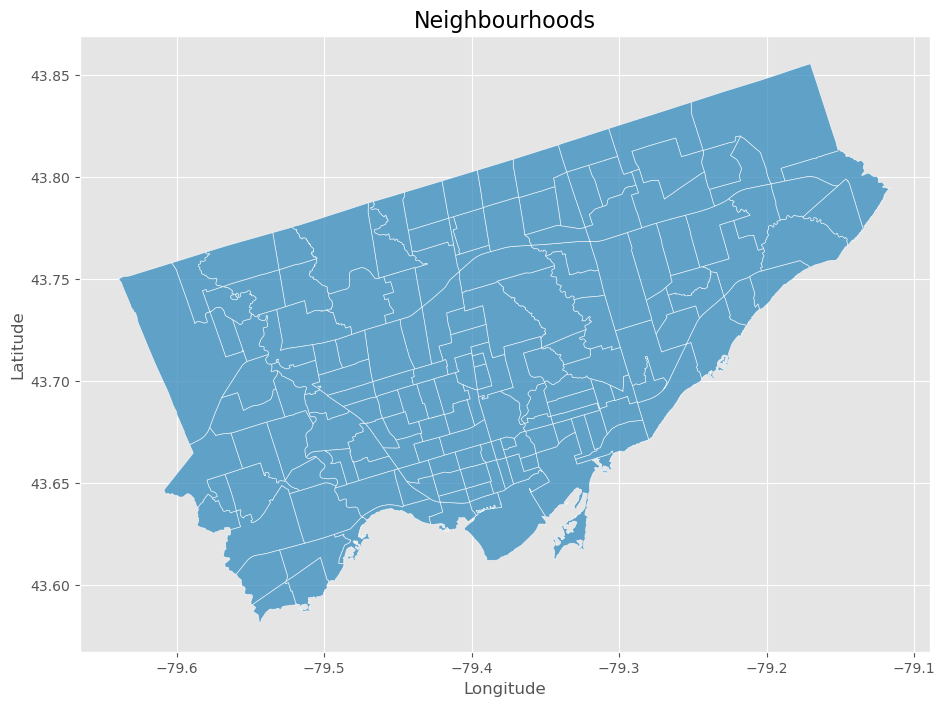

In [27]:
neighbourhoods_geodata.plot(figsize=(15, 8), edgecolor='w', alpha=0.75);
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)

# Add title
plt.title('Neighbourhoods', fontsize=16)

# Display the plot
plt.show()

### Demographics Data

In [28]:
# Read the .xlsx file into a pandas DataFrame
neighbourhood_demographics = pd.read_excel("neighbourhood-profiles-2021-158-model.xlsx", engine="openpyxl")

# Print the DataFrame
neighbourhood_demographics.head()

,Neighbourhood Name,West Humber-Clairville,Mount Olive-Silverstone-Jamestown,Thistletown-Beaumond Heights,Rexdale-Kipling,Elms-Old Rexdale,Kingsview Village-The Westway,Willowridge-Martingrove-Richview,Humber Heights-Westmount,Edenbridge-Humber Valley,...,Harbourfront-CityPlace,St Lawrence-East Bayfront-The Islands,Church-Wellesley,Downtown Yonge East,Bay-Cloverhill,Yonge-Bay Corridor,Junction-Wallace Emerson,Dovercourt Village,North Toronto,South Eglinton-Davisville
0,Neighbourhood Number,1,2,3,4,5,6,7,8,9,...,165,166,167,168,169,170,171,172,173,174
1,TSNS 2020 Designation,Not an NIA or Emerging Neighbourhood,Neighbourhood Improvement Area,Neighbourhood Improvement Area,Not an NIA or Emerging Neighbourhood,Neighbourhood Improvement Area,Neighbourhood Improvement Area,Not an NIA or Emerging Neighbourhood,Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,...,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood
2,Total - Age groups of the population - 25% sam...,33300,31345,9850,10375,9355,22005,22445,10005,15190,...,28135,31285,22320,17700,16670,12645,23180,12380,15885,22735
3,0 to 14 years,4295,5690,1495,1575,1610,3915,3500,1370,2070,...,2065,2285,895,1055,745,970,3075,1365,1315,2190
4,0 to 4 years,1460,1650,505,505,440,1245,1065,395,520,...,1030,1045,495,480,370,500,1135,445,535,910


In [29]:
neighbourhood_demographics = neighbourhood_demographics.set_index(neighbourhood_demographics.columns[0])
neighbourhood_demographics.head()

,West Humber-Clairville,Mount Olive-Silverstone-Jamestown,Thistletown-Beaumond Heights,Rexdale-Kipling,Elms-Old Rexdale,Kingsview Village-The Westway,Willowridge-Martingrove-Richview,Humber Heights-Westmount,Edenbridge-Humber Valley,Princess-Rosethorn,...,Harbourfront-CityPlace,St Lawrence-East Bayfront-The Islands,Church-Wellesley,Downtown Yonge East,Bay-Cloverhill,Yonge-Bay Corridor,Junction-Wallace Emerson,Dovercourt Village,North Toronto,South Eglinton-Davisville
Neighbourhood Name,,,,,,,,,,,,,,,,,,,,,
Neighbourhood Number,1,2,3,4,5,6,7,8,9,10,...,165,166,167,168,169,170,171,172,173,174
TSNS 2020 Designation,Not an NIA or Emerging Neighbourhood,Neighbourhood Improvement Area,Neighbourhood Improvement Area,Not an NIA or Emerging Neighbourhood,Neighbourhood Improvement Area,Neighbourhood Improvement Area,Not an NIA or Emerging Neighbourhood,Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,...,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood,Not an NIA or Emerging Neighbourhood
Total - Age groups of the population - 25% sample data,33300,31345,9850,10375,9355,22005,22445,10005,15190,11170,...,28135,31285,22320,17700,16670,12645,23180,12380,15885,22735
0 to 14 years,4295,5690,1495,1575,1610,3915,3500,1370,2070,1750,...,2065,2285,895,1055,745,970,3075,1365,1315,2190
0 to 4 years,1460,1650,505,505,440,1245,1065,395,520,545,...,1030,1045,495,480,370,500,1135,445,535,910


In [30]:
len(neighbourhood_demographics.columns.tolist())


158

In [31]:
neighbourhood_demographics_transpose = neighbourhood_demographics.T
neighbourhood_demographics_transpose.head()

Neighbourhood Name,Neighbourhood Number,TSNS 2020 Designation,Total - Age groups of the population - 25% sample data,0 to 14 years,0 to 4 years,5 to 9 years,10 to 14 years,15 to 64 years,15 to 19 years,20 to 24 years,...,Between 9 a.m. and 11:59 a.m.,Between 12 p.m. and 4:59 a.m.,Total - Eligibility for instruction in the minority official language for the population in private households born in 2003 or later - 25% sample data,Children eligible for instruction in the minority official language,Children not eligible for instruction in the minority official language,"Total - Eligibility and instruction in the minority official language, for the population in private households born between 2003 and 2015 (inclusive) - 25% sample data",Children eligible for instruction in the minority official language,Eligible children who have been instructed in the minority official language at the primary or secondary level in Canada,Eligible children who have not been instructed in the minority official language at the primary or secondary level in Canada,Children not eligible for instruction in the minority official language
West Humber-Clairville,1,Not an NIA or Emerging Neighbourhood,33300,4295,1460,1345,1485,23640,1860,3175,...,1665,2935,5430,410,5020,3875,335,255,75,3540
Mount Olive-Silverstone-Jamestown,2,Neighbourhood Improvement Area,31345,5690,1650,1860,2175,21490,2280,2675,...,1145,2965,7285,510,6780,5540,395,245,145,5145
Thistletown-Beaumond Heights,3,Neighbourhood Improvement Area,9850,1495,505,540,455,6615,570,745,...,395,635,1860,180,1685,1325,120,75,45,1205
Rexdale-Kipling,4,Not an NIA or Emerging Neighbourhood,10375,1575,505,615,455,6950,515,715,...,425,775,1910,135,1770,1370,90,75,25,1275
Elms-Old Rexdale,5,Neighbourhood Improvement Area,9355,1610,440,480,685,6355,635,685,...,355,675,2015,95,1920,1520,70,60,10,1445


In [32]:
neighbourhood_demographics_transpose.shape

(158, 2603)

### Combining datasets 

In [33]:
merged_neighbourhood_df = pd.merge(neighbourhood_demographics_transpose, neighbourhoods_geodata, left_index=True, right_index=True, how='inner')
merged_neighbourhood_df.head()

,Neighbourhood Number,TSNS 2020 Designation,Total - Age groups of the population - 25% sample data,0 to 14 years,0 to 4 years,5 to 9 years,10 to 14 years,15 to 64 years,15 to 19 years,20 to 24 years,...,Between 12 p.m. and 4:59 a.m.,Total - Eligibility for instruction in the minority official language for the population in private households born in 2003 or later - 25% sample data,Children eligible for instruction in the minority official language,Children not eligible for instruction in the minority official language,"Total - Eligibility and instruction in the minority official language, for the population in private households born between 2003 and 2015 (inclusive) - 25% sample data",Children eligible for instruction in the minority official language,Eligible children who have been instructed in the minority official language at the primary or secondary level in Canada,Eligible children who have not been instructed in the minority official language at the primary or secondary level in Canada,Children not eligible for instruction in the minority official language,geometry
West Humber-Clairville,1,Not an NIA or Emerging Neighbourhood,33300,4295,1460,1345,1485,23640,1860,3175,...,2935,5430,410,5020,3875,335,255,75,3540,"MULTIPOLYGON (((-79.59037 43.73401, -79.58942 ..."
Mount Olive-Silverstone-Jamestown,2,Neighbourhood Improvement Area,31345,5690,1650,1860,2175,21490,2280,2675,...,2965,7285,510,6780,5540,395,245,145,5145,"MULTIPOLYGON (((-79.57938 43.76222, -79.57925 ..."
Thistletown-Beaumond Heights,3,Neighbourhood Improvement Area,9850,1495,505,540,455,6615,570,745,...,635,1860,180,1685,1325,120,75,45,1205,"MULTIPOLYGON (((-79.56226 43.74373, -79.56234 ..."
Rexdale-Kipling,4,Not an NIA or Emerging Neighbourhood,10375,1575,505,615,455,6950,515,715,...,775,1910,135,1770,1370,90,75,25,1275,"MULTIPOLYGON (((-79.56419 43.71229, -79.5667 4..."
Elms-Old Rexdale,5,Neighbourhood Improvement Area,9355,1610,440,480,685,6355,635,685,...,675,2015,95,1920,1520,70,60,10,1445,"MULTIPOLYGON (((-79.54677 43.73156, -79.54632 ..."


In [34]:
merged_neighbourhood_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 151 entries, West Humber-Clairville to South Eglinton-Davisville
Columns: 2604 entries, Neighbourhood Number to geometry
dtypes: geometry(1), object(2603)
memory usage: 3.0+ MB


In [35]:
merged_neighbourhood_df.columns.tolist()

['Neighbourhood Number',
 'TSNS 2020 Designation',
 'Total - Age groups of the population - 25% sample data',
 '  0 to 14 years',
 '    0 to 4 years',
 '    5 to 9 years',
 '    10 to 14 years',
 '  15 to 64 years',
 '    15 to 19 years',
 '    20 to 24 years',
 '    25 to 29 years',
 '    30 to 34 years',
 '    35 to 39 years',
 '    40 to 44 years',
 '    45 to 49 years',
 '    50 to 54 years',
 '    55 to 59 years',
 '    60 to 64 years',
 '  65 years and over',
 '    65 to 69 years',
 '    70 to 74 years',
 '    75 to 79 years',
 '    80 to 84 years',
 '    85 years and over',
 '      85 to 89 years',
 '      90 to 94 years',
 '      95 to 99 years',
 '      100 years and over',
 'Total - Distribution (%) of the population by broad age groups - 25% sample data',
 '  0 to 14 years',
 '  15 to 64 years',
 '  65 years and over',
 '    85 years and over',
 'Average age of the population',
 'Median age of the population',
 'Total - Persons in private households - 25% sample data',
 '  T

In [36]:
# Count occurrences of the column name in the DataFrame columns
column_name = '  $10,000 to $14,999'
count = merged_neighbourhood_df.columns.to_list().count(column_name)

print(f"The column '{column_name}' appears {count} times in merged_neighbourhood_df.")


The column '  $10,000 to $14,999' appears 2 times in merged_neighbourhood_df.


In [37]:
# Rename columns to include their column index
merged_neighbourhood_df.columns = [
    f"{col} ({i})" for i, col in enumerate(merged_neighbourhood_df.columns)
]

# Display the first few renamed columns to verify
print("Renamed columns:")
print(merged_neighbourhood_df.columns[:10])  # Display first 10 columns for verification


Renamed columns:
Index(['Neighbourhood Number (0)', 'TSNS 2020 Designation (1)',
       'Total - Age groups of the population - 25% sample data (2)',
       '  0 to 14 years (3)', '    0 to 4 years (4)', '    5 to 9 years (5)',
       '    10 to 14 years (6)', '  15 to 64 years (7)',
       '    15 to 19 years (8)', '    20 to 24 years (9)'],
      dtype='object')


In [38]:
merged_neighbourhood_df.columns.tolist()

['Neighbourhood Number (0)',
 'TSNS 2020 Designation (1)',
 'Total - Age groups of the population - 25% sample data (2)',
 '  0 to 14 years (3)',
 '    0 to 4 years (4)',
 '    5 to 9 years (5)',
 '    10 to 14 years (6)',
 '  15 to 64 years (7)',
 '    15 to 19 years (8)',
 '    20 to 24 years (9)',
 '    25 to 29 years (10)',
 '    30 to 34 years (11)',
 '    35 to 39 years (12)',
 '    40 to 44 years (13)',
 '    45 to 49 years (14)',
 '    50 to 54 years (15)',
 '    55 to 59 years (16)',
 '    60 to 64 years (17)',
 '  65 years and over (18)',
 '    65 to 69 years (19)',
 '    70 to 74 years (20)',
 '    75 to 79 years (21)',
 '    80 to 84 years (22)',
 '    85 years and over (23)',
 '      85 to 89 years (24)',
 '      90 to 94 years (25)',
 '      95 to 99 years (26)',
 '      100 years and over (27)',
 'Total - Distribution (%) of the population by broad age groups - 25% sample data (28)',
 '  0 to 14 years (29)',
 '  15 to 64 years (30)',
 '  65 years and over (31)',
 '    85

In [39]:
merged_neighbourhood_df.tail()

,Neighbourhood Number (0),TSNS 2020 Designation (1),Total - Age groups of the population - 25% sample data (2),0 to 14 years (3),0 to 4 years (4),5 to 9 years (5),10 to 14 years (6),15 to 64 years (7),15 to 19 years (8),20 to 24 years (9),...,Between 12 p.m. and 4:59 a.m. (2594),Total - Eligibility for instruction in the minority official language for the population in private households born in 2003 or later - 25% sample data (2595),Children eligible for instruction in the minority official language (2596),Children not eligible for instruction in the minority official language (2597),"Total - Eligibility and instruction in the minority official language, for the population in private households born between 2003 and 2015 (inclusive) - 25% sample data (2598)",Children eligible for instruction in the minority official language (2599),Eligible children who have been instructed in the minority official language at the primary or secondary level in Canada (2600),Eligible children who have not been instructed in the minority official language at the primary or secondary level in Canada (2601),Children not eligible for instruction in the minority official language (2602),geometry (2603)
Yonge-Bay Corridor,170,Not an NIA or Emerging Neighbourhood,12645,970,500,270,200,10820,340,1825,...,330,1075,50,1020,555,30,10,20,520,"MULTIPOLYGON (((-79.38404 43.64497, -79.38502 ..."
Junction-Wallace Emerson,171,Not an NIA or Emerging Neighbourhood,23180,3075,1135,1020,925,17200,750,1185,...,1105,3580,410,3170,2375,305,190,115,2075,"MULTIPOLYGON (((-79.4387 43.66766, -79.43841 4..."
Dovercourt Village,172,Not an NIA or Emerging Neighbourhood,12380,1365,445,430,490,9040,460,640,...,570,1665,175,1490,1190,130,95,35,1060,"MULTIPOLYGON (((-79.43411 43.66015, -79.43537 ..."
North Toronto,173,Not an NIA or Emerging Neighbourhood,15885,1315,535,390,390,12780,465,960,...,550,1620,145,1470,1050,95,65,30,955,"MULTIPOLYGON (((-79.39744 43.70693, -79.39837 ..."
South Eglinton-Davisville,174,Not an NIA or Emerging Neighbourhood,22735,2190,910,670,610,17495,575,1115,...,730,2570,265,2300,1580,155,105,45,1420,"MULTIPOLYGON (((-79.38635 43.69783, -79.38623 ..."


Dataframe is now combined and ready for feature analysis

In [40]:
intersection = gpd.overlay(flood_line, neighbourhoods_geodata, how='intersection')

# Create the plot
fig, ax = plt.subplots(figsize=(15, 8))

# Plot the neighbourhoods
neighbourhoods_geodata.plot(ax=ax, edgecolor='w', alpha=0.75)

# Plot the flood line only if it intersects the neighbourhoods
if not intersection.empty:
    intersection.plot(ax=ax, color='orange', edgecolor='k', label='Flood Plains Intersection')

# Labeling the axes
plt.xlabel('Latitude', fontsize=18)
plt.ylabel('Longitude', fontsize=18)

# Add title
plt.title('Flood Plains and Neighbourhoods', fontsize=20)

# Show the plot
plt.show()

NameError: name 'flood_line' is not defined

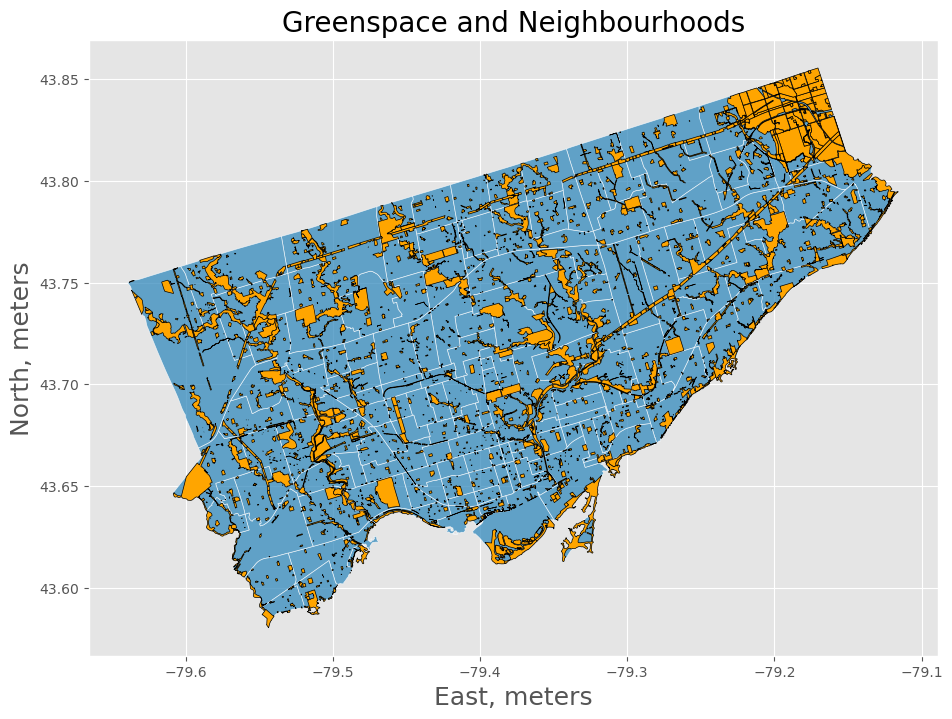

In [41]:
ax = neighbourhoods_geodata.plot(figsize=(15, 8), edgecolor='w', alpha=0.75)                       #plot size and colour
greenspace.plot(ax=ax, color='orange', edgecolor='k', label='Flood Plains')  
plt.xlabel('East, meters', fontsize=18)                                                    #axses labels
plt.ylabel('North, meters', fontsize=18) 
plt.title('Greenspace and Neighbourhoods', fontsize=20)                          #title
plt.show()

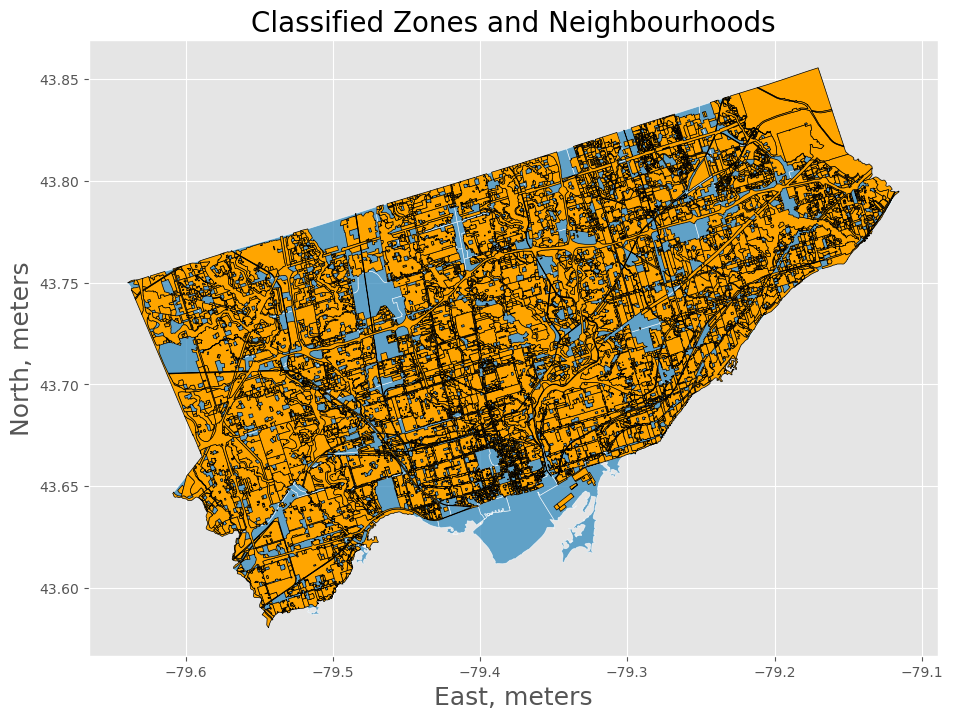

In [42]:
ax = neighbourhoods_geodata.plot(figsize=(15, 8), edgecolor='w', alpha=0.75)                       #plot size and colour
zones_geodata.plot(ax=ax, color='orange', edgecolor='k', label='Flood Plains')  
plt.xlabel('East, meters', fontsize=18)                                                    #axses labels
plt.ylabel('North, meters', fontsize=18) 
plt.title('Classified Zones and Neighbourhoods', fontsize=20)                          #title
plt.show()

c:\Users\aaron\anaconda3\Lib\site-packages\mapclassify\classifiers.py:462: RuntimeWarning: invalid value encountered in greater
  binIds += (x > _l) * (x <= r) * k
c:\Users\aaron\anaconda3\Lib\site-packages\mapclassify\classifiers.py:462: RuntimeWarning: invalid value encountered in less_equal
  binIds += (x > _l) * (x <= r) * k


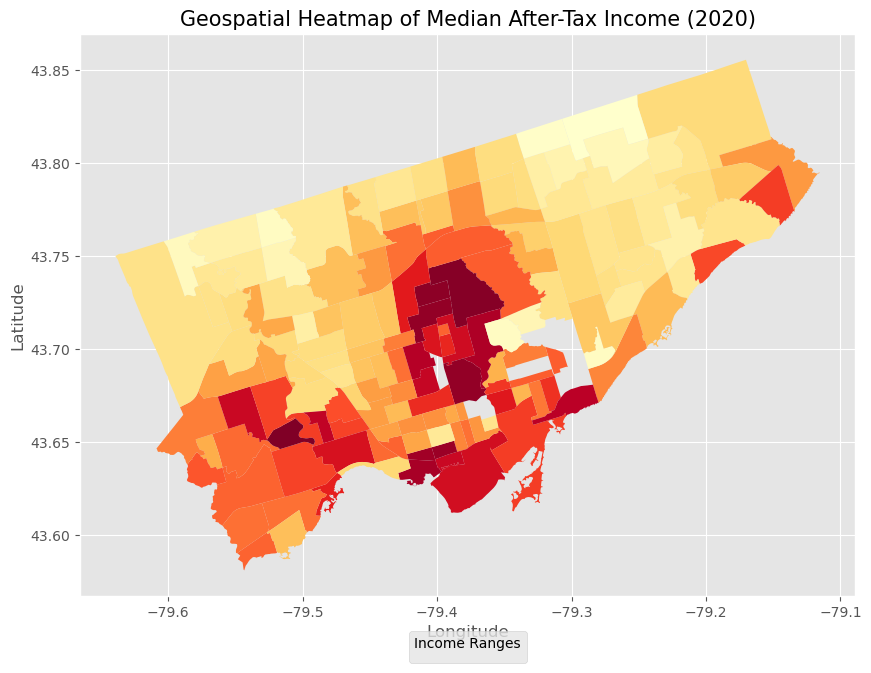

In [43]:
income_data = neighbourhood_demographics_transpose[["    Median total income in 2020  among recipients ($)"]]
merged_gdf = neighbourhoods_geodata.join(income_data)

classifier = mapclassify.Quantiles(merged_gdf["    Median total income in 2020  among recipients ($)"], k=4)
merged_gdf["income_bins"] = classifier.yb  # Add the classification to the GeoDataFrame


fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Plot the GeoDataFrame with the selected income column for color mapping
merged_gdf.plot(column="    Median total income in 2020  among recipients ($)",
                ax=ax,
                cmap='YlOrRd',  # Choose the color map, e.g., 'viridis', 'coolwarm', etc.
                legend_kwds={
                    'label': "Median After-Tax Income ($)",  # Label for the legend
                    'orientation': "horizontal",  # Orientation of the legend
                    'bbox_to_anchor': (0.5, -0.05),  # Position the legend
                    'loc': 'upper center'  # Position legend in the center
                })

# Customize the legend
# Create a list of the bin labels based on the classification
bin_labels = [f"{round(classifier.bins[i], 2)} - {round(classifier.bins[i + 1], 2)}"
              for i in range(len(classifier.bins) - 1)]

# Add a legend with the appropriate bin ranges
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, bin_labels, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=4, title="Income Ranges")

# Add title and labels
ax.set_title("Geospatial Heatmap of Median After-Tax Income (2020)", fontsize=15)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Show the plot
plt.show()


Now we shall only retrieve the columns that pertain to the vulnerability index.

In [ ]:
# Define the complete grouped columns (replace with your full column lists)
grouped_columns = {
    "Demographics": [
        'Total - Age groups of the population - 25% sample data (2)',
        '  0 to 14 years (3)',
        '  15 to 64 years (7)',
        '  65 years and over (18)',
        'Average age of the population (33)',

    ],
    "Family Composition": [
        'Total - Persons in private households - 25% sample data (35)',
        '  Total - Persons in census families (36)',
        '    Married spouses or common-law partners (37)',
        '    Parents in one-parent families (38)',
        '    Children (39)',
        '      In a two-parent family (40)',
        '      In a one-parent family (41)',
        '  Total - Persons not in census families in private households - 25% sample data (42)',

    ],
    "Income": [
        'Total - Income statistics in 2020 for the population aged 15 years and over in private households - 25% sample data (60)',
        '  Number of after-tax income recipients aged 15 years and over in private households in 2020 - 25% sample data (64)',
        '    Median after-tax income in 2020 among recipients ($) (65)',
        '    Average after-tax income in 2020 among recipients ($) (66)',
        'Total - After-tax income groups in 2020 for the population aged 15 years and over in private households - 25% sample data (105)',
        '  Without after-tax income (106)',
        '  With after-tax income (107)',
        '    Under $10,000 (including loss) (108)',
        '    $10,000 to $19,999 (109)',
        '    $20,000 to $29,999 (110)',
        '    $30,000 to $39,999 (111)',
        '    $40,000 to $49,999 (112)',
        '    $50,000 to $59,999 (113)',
        '    $60,000 to $69,999 (114)',
        '    $70,000 to $79,999 (115)',
        '    $80,000 to $89,999 (116)',
        '    $90,000 to $99,999 (117)',
        '    $100,000 and over (118)',
        '      $100,000 to $124,999 (119)',
        '      $125,000 and over (120)',
    ],
    "Housing": [
        'Total - Private households by tenure - 25% sample data (298)',
        '  Owner (299)',
        '  Renter (300)',
        '  Dwelling provided by the local government, First Nation or Indian band (301)',
        'Total - Occupied private dwellings by condominium status - 25% sample data (302)',
        '  Condominium (303)',
        '  Not condominium (304)',
        'Total - Occupied private dwellings by number of rooms - 25% sample data (311)',
        '  1 to 4 rooms (312)',
        '  5 rooms (313)',
        '  6 rooms (314)',
        '  7 rooms (315)',
        '  8 or more rooms (316)',
        'Average number of rooms per dwelling (317)',
    ],
    "Condition": [
        'Total - Private households by housing suitability - 25% sample data (321)',
        '  Suitable (322)',
        '  Not suitable (323)',
        'Total - Occupied private dwellings by period of construction - 25% sample data (324)',
        '  1960 or before (325)',
        '  1961 to 1980 (326)',
        '  1981 to 1990 (327)',
        '  1991 to 2000 (328)',
        '  2001 to 2005 (329)',
        '  2006 to 2010 (330)',
        '  2011 to 2015 (331)',
        '  2016 to 2021 (332)',
        'Total - Occupied private dwellings by dwelling condition - 25% sample data (333)',
        '  Only regular maintenance and minor repairs needed (334)',
        '  Major repairs needed (335)'
        "  Total - Households 'spending 30% or more of income on shelter costs' or 'not suitable' or 'major repairs needed' (350)",
            ],
    "Language": [
        'Total - Knowledge of official languages for the population in private households - 25% sample data (426)',
        '  English only (427)',
        '  French only (428)',
        '  English and French (429)',
        '  Neither English nor French (430)'
    ],
    
}

# Ensure the required columns are included in all DataFrames
common_columns = ['Neighbourhood Number (0)', 'TSNS 2020 Designation (1)', 'geometry (2603)']

# Create DataFrames for each group
dataframes = {}
for group_name, columns in grouped_columns.items():
    # Combine common columns with group-specific ones
    selected_columns = common_columns + columns
    # Ensure the selected columns exist in the DataFrame
    selected_columns = [col for col in selected_columns if col in merged_neighbourhood_df.columns]
    # Create the DataFrame
    dataframes[group_name] = merged_neighbourhood_df[selected_columns]

# Example: Access a specific group DataFrame
print("Demographics DataFrame:")
dataframes["Demographics"].head()


Demographics DataFrame:


,Neighbourhood Number (0),TSNS 2020 Designation (1),geometry (2603),Total - Age groups of the population - 25% sample data (2),0 to 14 years (3),15 to 64 years (7),65 years and over (18),Average age of the population (33)
West Humber-Clairville,1,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.59037 43.73401, -79.58942 ...",33300,4295,23640,5360,40.5
Mount Olive-Silverstone-Jamestown,2,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.57938 43.76222, -79.57925 ...",31345,5690,21490,4170,37.8
Thistletown-Beaumond Heights,3,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.56226 43.74373, -79.56234 ...",9850,1495,6615,1740,41
Rexdale-Kipling,4,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.56419 43.71229, -79.5667 4...",10375,1575,6950,1850,41.9
Elms-Old Rexdale,5,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.54677 43.73156, -79.54632 ...",9355,1610,6355,1390,39.6


In [74]:
# Ensure the required columns are included in all DataFrames
common_columns = ['Neighbourhood Number (0)', 'TSNS 2020 Designation (1)', 'geometry (2603)']

# Initialize a DataFrame with the common columns
big_dataframe = merged_neighbourhood_df[common_columns].copy()

# Iterate over the grouped columns and merge into the big DataFrame
for group_name, columns in grouped_columns.items():
    # Select only the columns present in merged_neighbourhood_df
    selected_columns = [col for col in columns if col in merged_neighbourhood_df.columns]
    # Extract the group-specific DataFrame
    group_df = merged_neighbourhood_df[selected_columns]
    # Concatenate the group DataFrame along columns
    big_dataframe = pd.concat([big_dataframe, group_df], axis=1)

# Output the combined big DataFrame
print("Big DataFrame:")
big_dataframe.head()


Big DataFrame:


,Neighbourhood Number (0),TSNS 2020 Designation (1),geometry (2603),Total - Age groups of the population - 25% sample data (2),0 to 14 years (3),15 to 64 years (7),65 years and over (18),Average age of the population (33),Total - Persons in private households - 25% sample data (35),Total - Persons in census families (36),...,2006 to 2010 (330),2011 to 2015 (331),2016 to 2021 (332),Total - Occupied private dwellings by dwelling condition - 25% sample data (333),Only regular maintenance and minor repairs needed (334),Total - Knowledge of official languages for the population in private households - 25% sample data (426),English only (427),French only (428),English and French (429),Neither English nor French (430)
West Humber-Clairville,1,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.59037 43.73401, -79.58942 ...",33300,4295,23640,5360,40.5,33300,26490,...,810,350,380,10700,10230,33295,30720,0,1235,1340
Mount Olive-Silverstone-Jamestown,2,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.57938 43.76222, -79.57925 ...",31345,5690,21490,4170,37.8,31345,26335,...,75,100,100,9740,8650,31345,28150,20,895,2285
Thistletown-Beaumond Heights,3,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.56226 43.74373, -79.56234 ...",9850,1495,6615,1740,41,9850,8045,...,40,50,30,3245,3045,9850,8935,0,425,490
Rexdale-Kipling,4,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.56419 43.71229, -79.5667 4...",10375,1575,6950,1850,41.9,10375,8235,...,80,35,15,3945,3655,10380,9655,0,425,295
Elms-Old Rexdale,5,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.54677 43.73156, -79.54632 ...",9355,1610,6355,1390,39.6,9355,7800,...,0,10,0,3195,2810,9355,8505,25,500,320


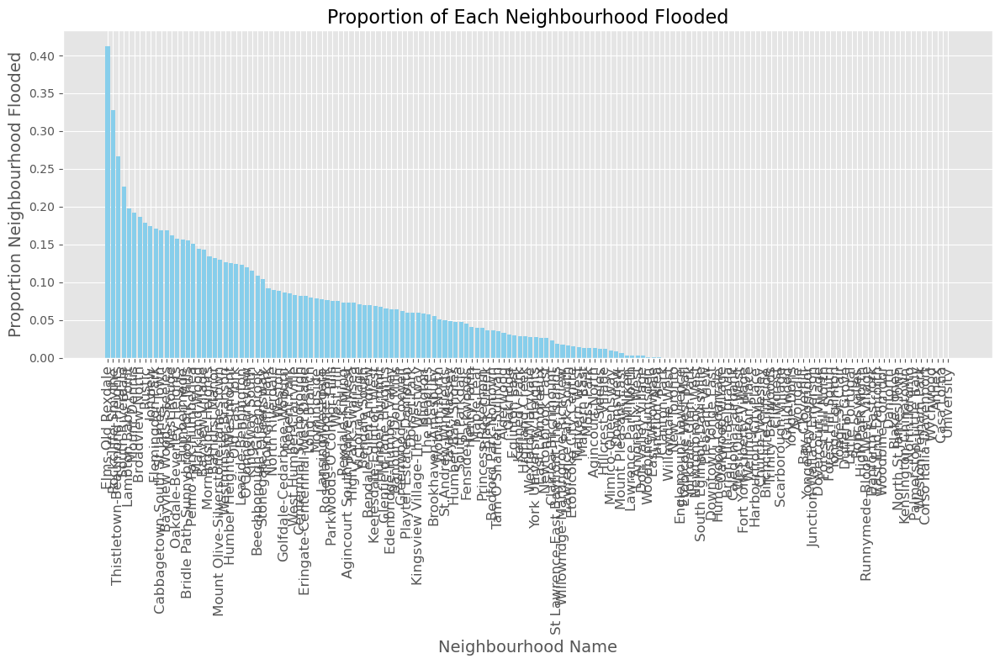

In [68]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Replace this with the path to your GeoJSON file
file_path = r"Neighbourhoods and Flooding.geojson"

# Load the GeoJSON file into a GeoDataFrame
flood_df = gpd.read_file(file_path)

# Create a bar chart of 'Neighbourhood_name' and 'Proportion Neighbourhood flooded'
plt.figure(figsize=(12, 8))
plt.bar(flood_df['Neighbourhood_name'], flood_df['Proportion Neighbourhood flooded'], color='skyblue')

# Customize the plot
plt.title('Proportion of Each Neighbourhood Flooded', fontsize=16)
plt.xlabel('Neighbourhood Name', fontsize=14)
plt.ylabel('Proportion Neighbourhood Flooded', fontsize=14)
plt.xticks(rotation=90, fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()


In [69]:
flood_df.head()

,Neighbourhood_name,Area,flood_intersection_area,Proportion Neighbourhood flooded,Proportion of flood that is Neighbourhood,geometry
0,Elms-Old Rexdale,5.616154,2.316251,0.412427,0.028786,"MULTIPOLYGON (((-8855105.833 5423993.698, -885..."
1,Rockcliffe-Smythe,9.701005,3.176384,0.327428,0.039476,"MULTIPOLYGON (((-8847133.6 5416231.647, -88470..."
2,Thistletown-Beaumond Heights,6.402351,1.705209,0.266341,0.021192,"MULTIPOLYGON (((-8856830.229 5425869.333, -885..."
3,South Riverdale,21.081810,4.780673,0.226768,0.059413,"MULTIPOLYGON (((-8830807.123 5412872.663, -883..."
4,Lambton Baby Point,3.407414,0.672654,0.197409,0.008360,"MULTIPOLYGON (((-8849813.365 5413870.667, -884..."


In [75]:
# Check if the required columns exist in flood_df
if 'Neighbourhood_name' in flood_df.columns and 'Proportion Neighbourhood flooded' in flood_df.columns:
    # Merge the Proportion Neighbourhood flooded column into the big DataFrame
    big_dataframe = big_dataframe.merge(
        flood_df[['Neighbourhood_name', 'Proportion Neighbourhood flooded']],
        how='left',
        left_index=True,  # Match based on the index of big_dataframe
        right_on='Neighbourhood_name'  # Match with Neighbourhood_name in flood_df
    )
    # Drop the redundant Neighbourhood_name column from flood_df
    big_dataframe = big_dataframe.drop(columns=['Neighbourhood_name'])
else:
    print("Error: flood_df does not have the required columns.")

# Output the updated big DataFrame
print("Big DataFrame with Proportion Neighbourhood flooded column:")
big_dataframe.head()


Big DataFrame with Proportion Neighbourhood flooded column:


,Neighbourhood Number (0),TSNS 2020 Designation (1),geometry (2603),Total - Age groups of the population - 25% sample data (2),0 to 14 years (3),15 to 64 years (7),65 years and over (18),Average age of the population (33),Total - Persons in private households - 25% sample data (35),Total - Persons in census families (36),...,2011 to 2015 (331),2016 to 2021 (332),Total - Occupied private dwellings by dwelling condition - 25% sample data (333),Only regular maintenance and minor repairs needed (334),Total - Knowledge of official languages for the population in private households - 25% sample data (426),English only (427),French only (428),English and French (429),Neither English nor French (430),Proportion Neighbourhood flooded
35,1,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.59037 43.73401, -79.58942 ...",33300,4295,23640,5360,40.5,33300,26490,...,350,380,10700,10230,33295,30720,0,1235,1340,0.082658
21,2,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.57938 43.76222, -79.57925 ...",31345,5690,21490,4170,37.8,31345,26335,...,100,100,9740,8650,31345,28150,20,895,2285,0.130259
2,3,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.56226 43.74373, -79.56234 ...",9850,1495,6615,1740,41,9850,8045,...,50,30,3245,3045,9850,8935,0,425,490,0.266341
44,4,Not an NIA or Emerging Neighbourhood,"MULTIPOLYGON (((-79.56419 43.71229, -79.5667 4...",10375,1575,6950,1850,41.9,10375,8235,...,35,15,3945,3655,10380,9655,0,425,295,0.073437
0,5,Neighbourhood Improvement Area,"MULTIPOLYGON (((-79.54677 43.73156, -79.54632 ...",9355,1610,6355,1390,39.6,9355,7800,...,10,0,3195,2810,9355,8505,25,500,320,0.412427


In [78]:
# Check which columns are numeric
numeric_columns = big_dataframe.select_dtypes(include=[np.number]).columns
print("Numeric columns in the DataFrame:", numeric_columns)

# If numeric columns exist, calculate correlations
if len(numeric_columns) > 1:  # More than just 'Proportion Neighbourhood flooded'
    correlation_with_flooded = big_dataframe[numeric_columns].corr()['Proportion Neighbourhood flooded'].sort_values(ascending=False)
    
    # Convert to DataFrame for readability
    correlation_table = correlation_with_flooded.reset_index()
    correlation_table.columns = ['Column', 'Correlation with Proportion Neighbourhood Flooded']
    
    print(correlation_table)
else:
    print("No additional numeric columns found for correlation analysis.")


Numeric columns in the DataFrame: Index(['Proportion Neighbourhood flooded'], dtype='object')
No additional numeric columns found for correlation analysis.


In [81]:
# Attempt to convert all object columns to float
for col in big_dataframe.select_dtypes(include=['object']).columns:
    try:
        # Convert to float in place
        big_dataframe[col] = big_dataframe[col].astype(float)
    except ValueError:
        print(f"Column '{col}' contains non-numeric data and could not be converted to float.")

# Check the data types of the updated DataFrame
print("Updated DataFrame data types:")
print(big_dataframe.dtypes)

big_dataframe.info()

Column 'TSNS 2020 Designation (1)' contains non-numeric data and could not be converted to float.
Updated DataFrame data types:
Neighbourhood Number (0)                                       float64
TSNS 2020 Designation (1)                                       object
geometry (2603)                                               geometry
Total - Age groups of the population - 25% sample data (2)     float64
  0 to 14 years (3)                                            float64
                                                                ...   
  English only (427)                                           float64
  French only (428)                                            float64
  English and French (429)                                     float64
  Neither English nor French (430)                             float64
Proportion Neighbourhood flooded                               float64
Length: 70, dtype: object
<class 'pandas.core.frame.DataFrame'>
Index: 151 entries, 35 to 1

C:\Users\aaron\AppData\Local\Temp\ipykernel_15164\1229513085.py:23: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


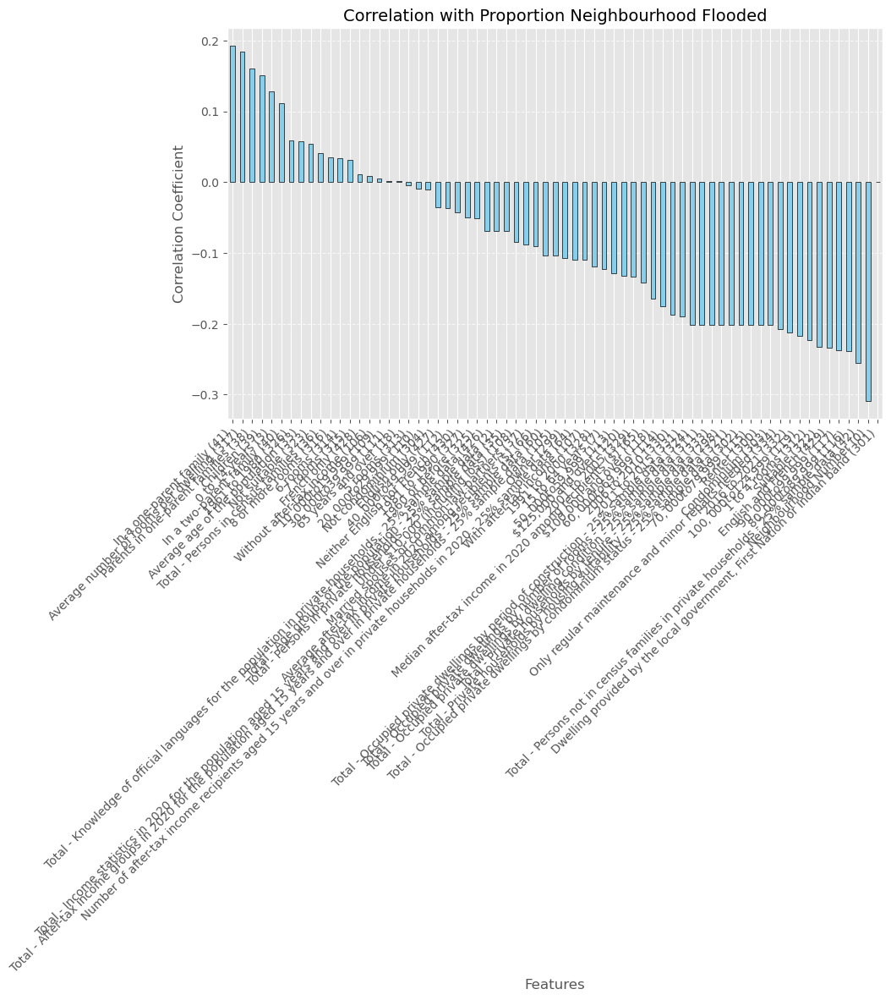

In [85]:
import matplotlib.pyplot as plt

# Ensure 'Proportion Neighbourhood flooded' exists in the DataFrame
if 'Proportion Neighbourhood flooded' in big_dataframe.columns:
    # Select only numeric columns
    numeric_columns = big_dataframe.select_dtypes(include=[np.number])
    
    if 'Proportion Neighbourhood flooded' in numeric_columns.columns:
        # Calculate correlations with 'Proportion Neighbourhood flooded'
        correlation_with_flooded = numeric_columns.corr()['Proportion Neighbourhood flooded'].sort_values(ascending=False)
        
        # Drop self-correlation for better visualization
        correlation_with_flooded = correlation_with_flooded.drop('Proportion Neighbourhood flooded', errors='ignore')
        
        # Plot the correlations as a bar chart
        plt.figure(figsize=(10, 6))
        correlation_with_flooded.plot(kind='bar', color='skyblue', edgecolor='black')
        plt.title('Correlation with Proportion Neighbourhood Flooded', fontsize=14)
        plt.ylabel('Correlation Coefficient', fontsize=12)
        plt.xlabel('Features', fontsize=12)
        plt.xticks(rotation=45, ha='right', fontsize=10)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
    else:
        print("The column 'Proportion Neighbourhood flooded' is not numeric.")
else:
    print("The column 'Proportion Neighbourhood flooded' does not exist in the DataFrame.")


Plotting comparison bar charts for group: Demographics


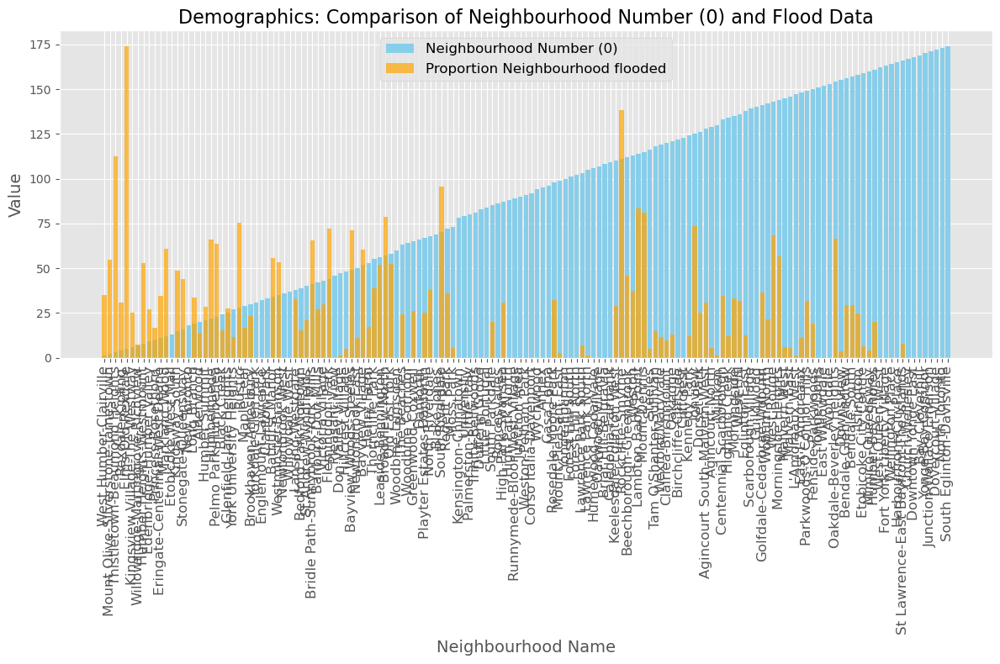

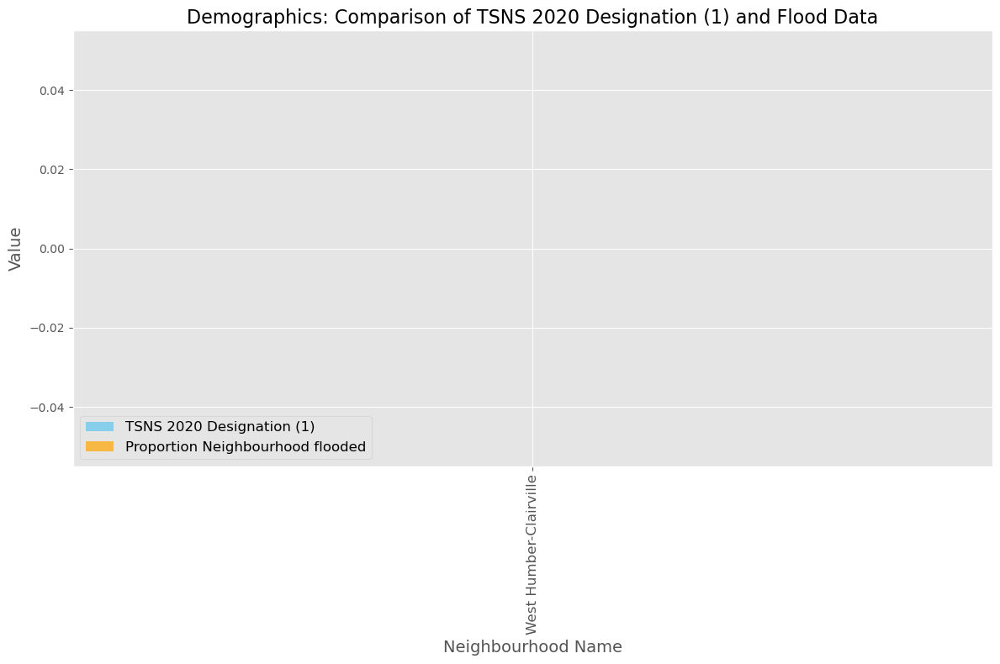

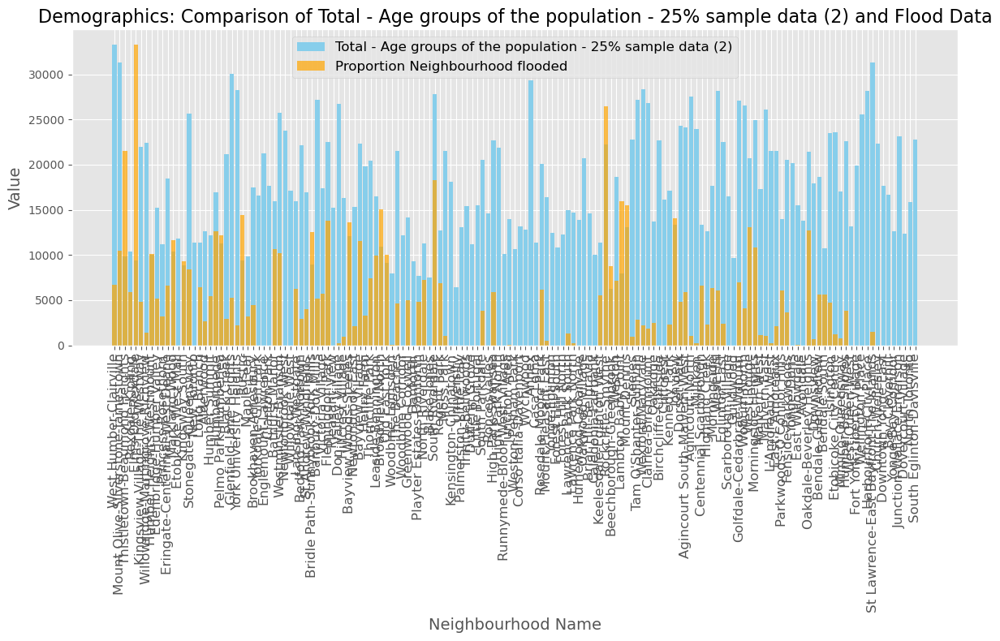

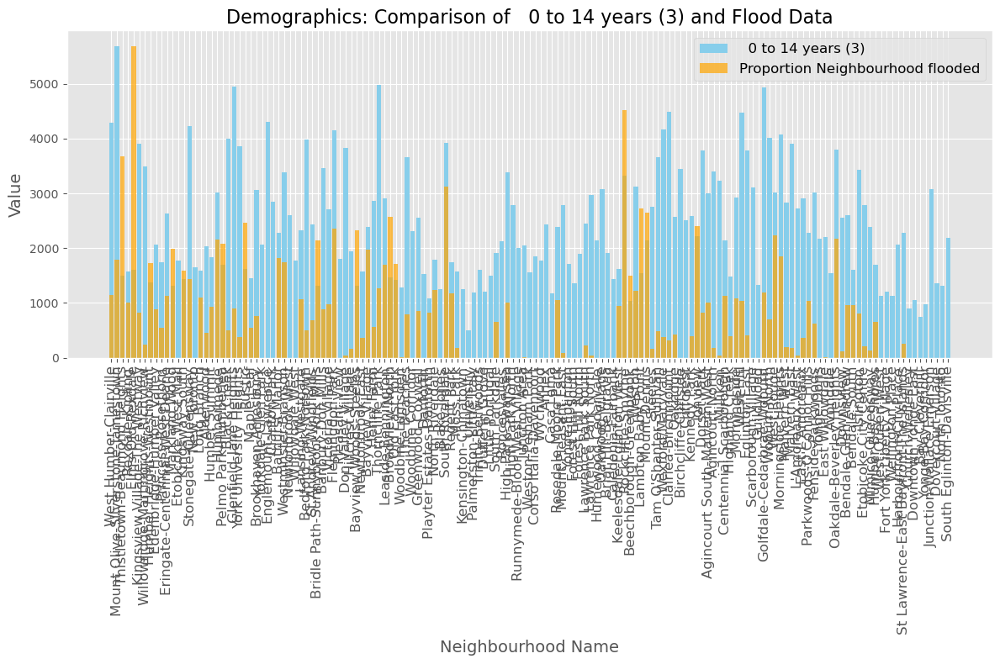

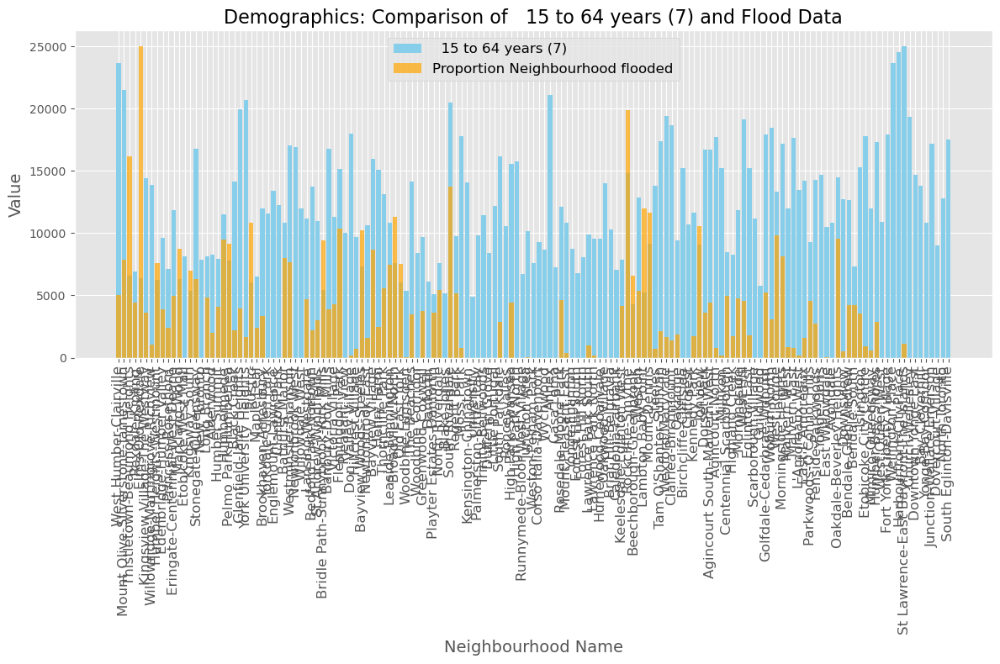

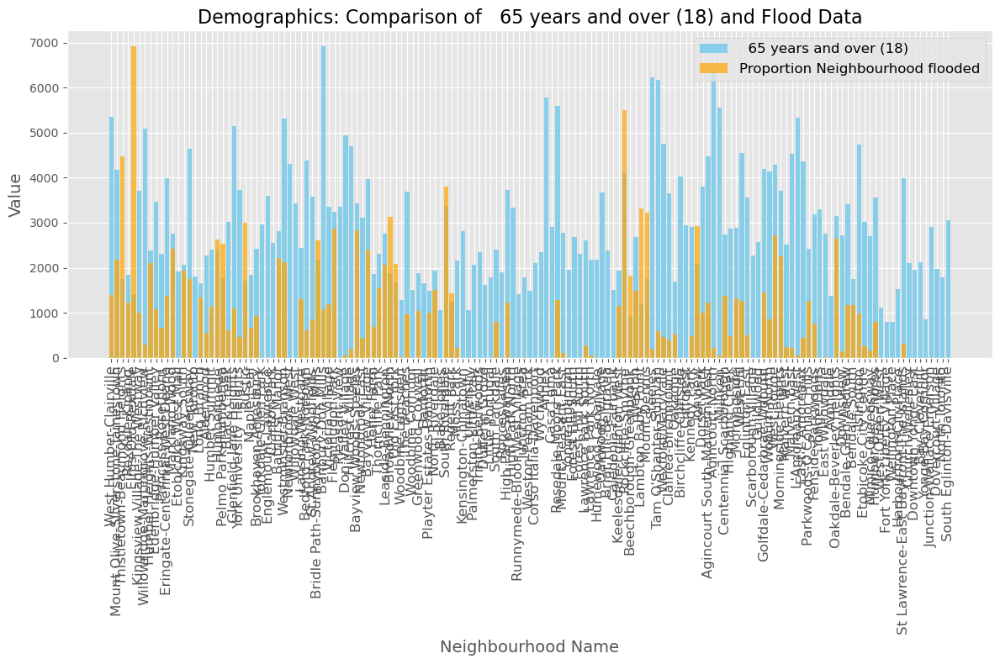

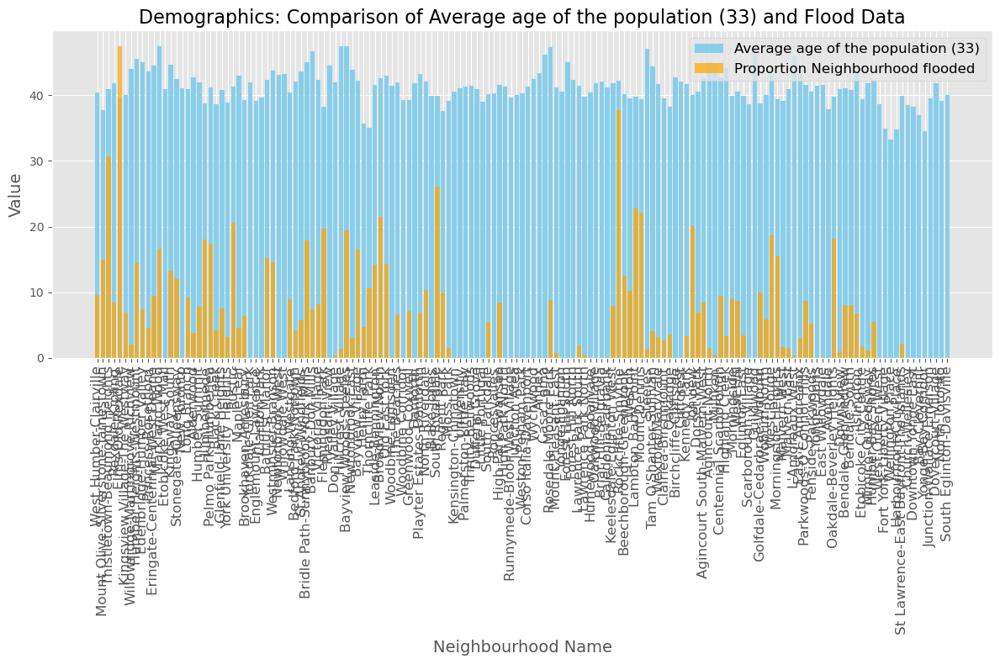

Plotting comparison bar charts for group: Family Composition


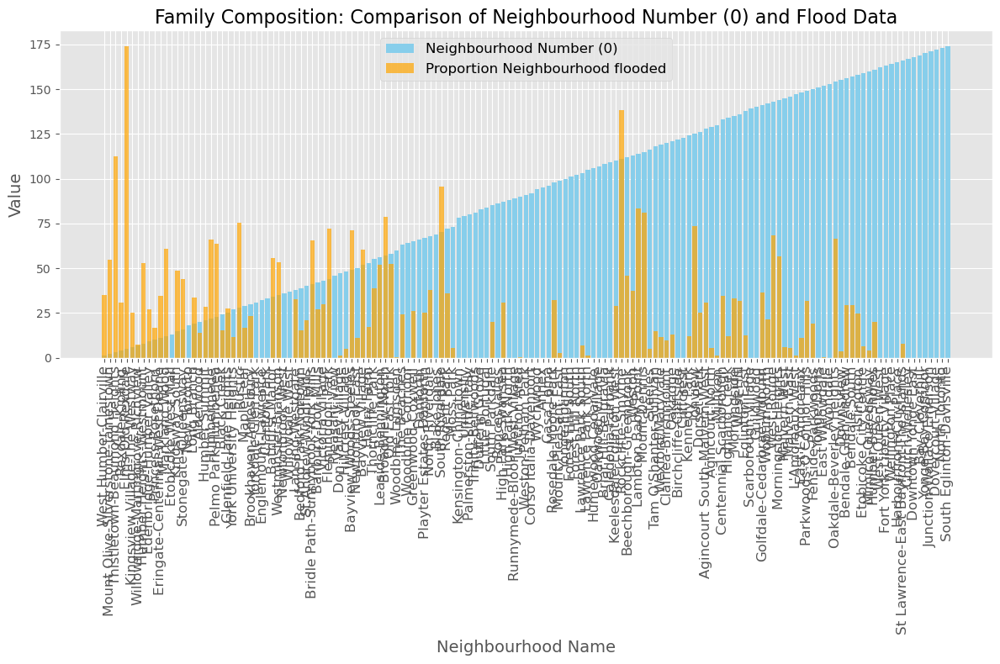

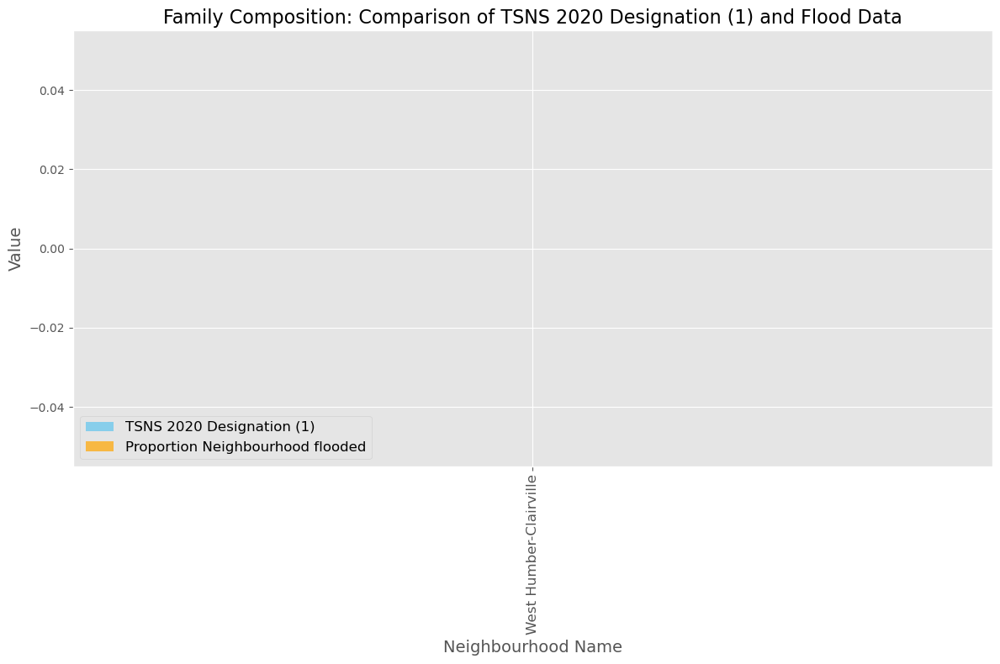

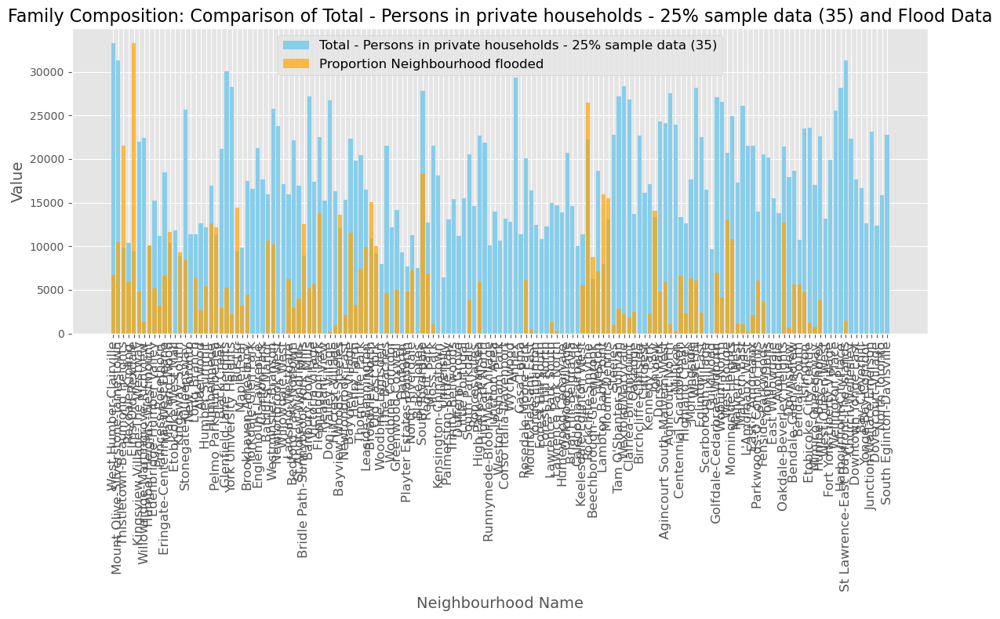

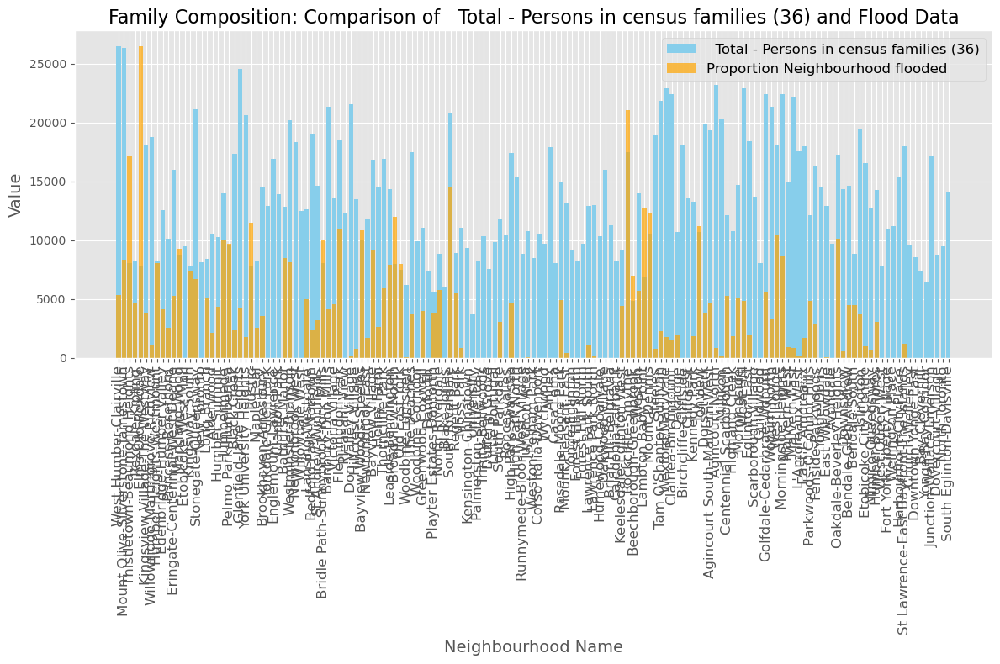

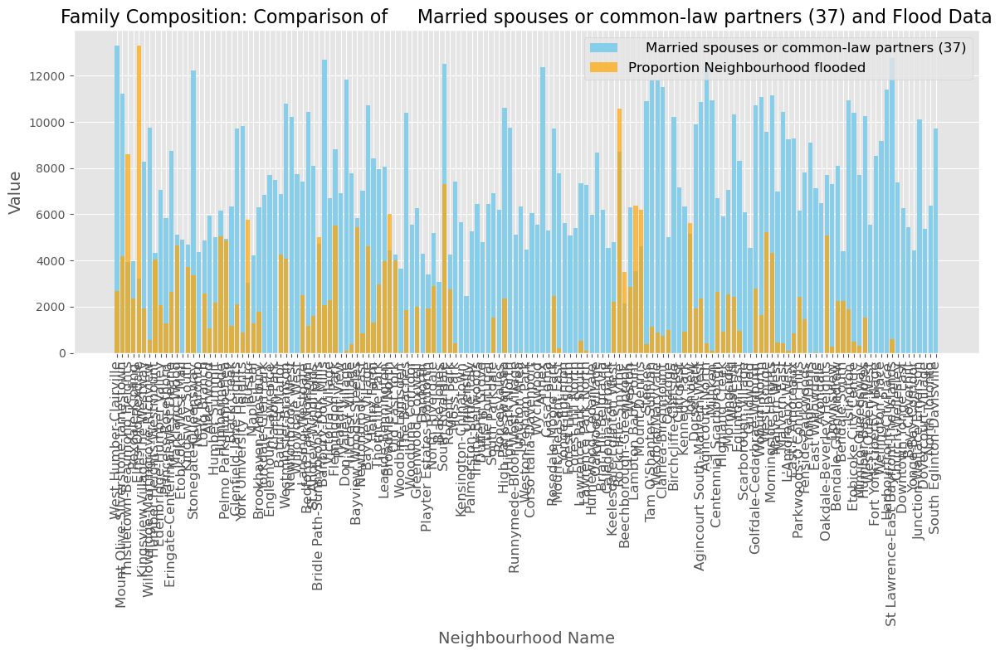

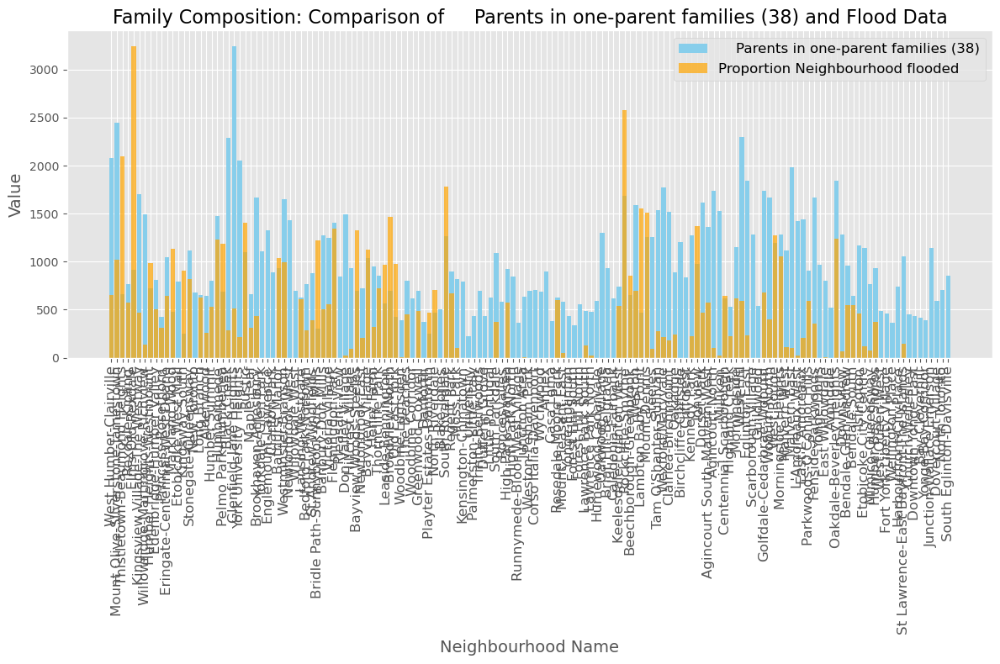

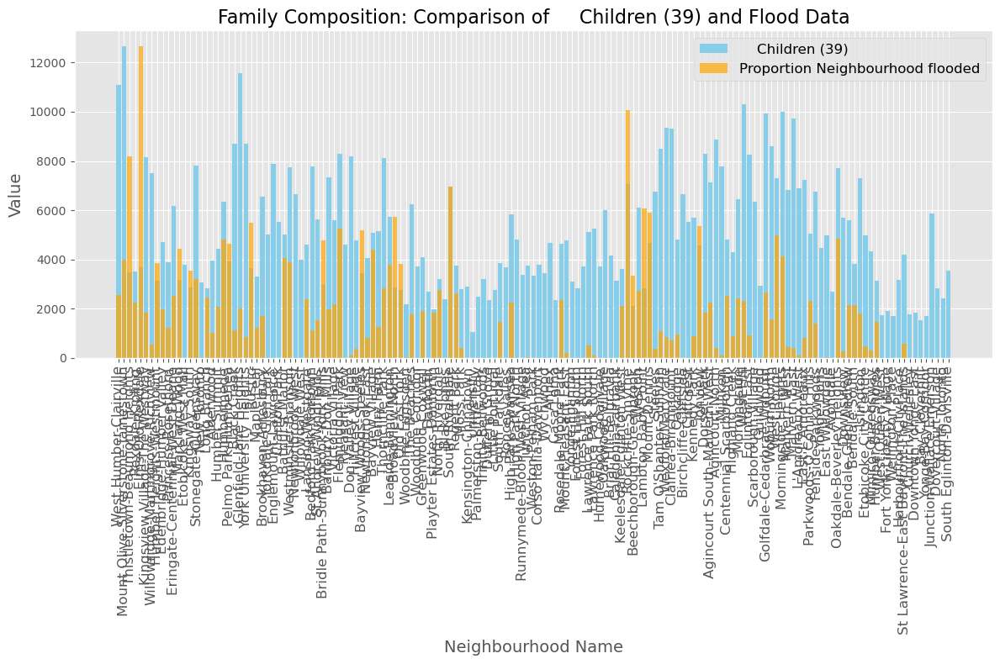

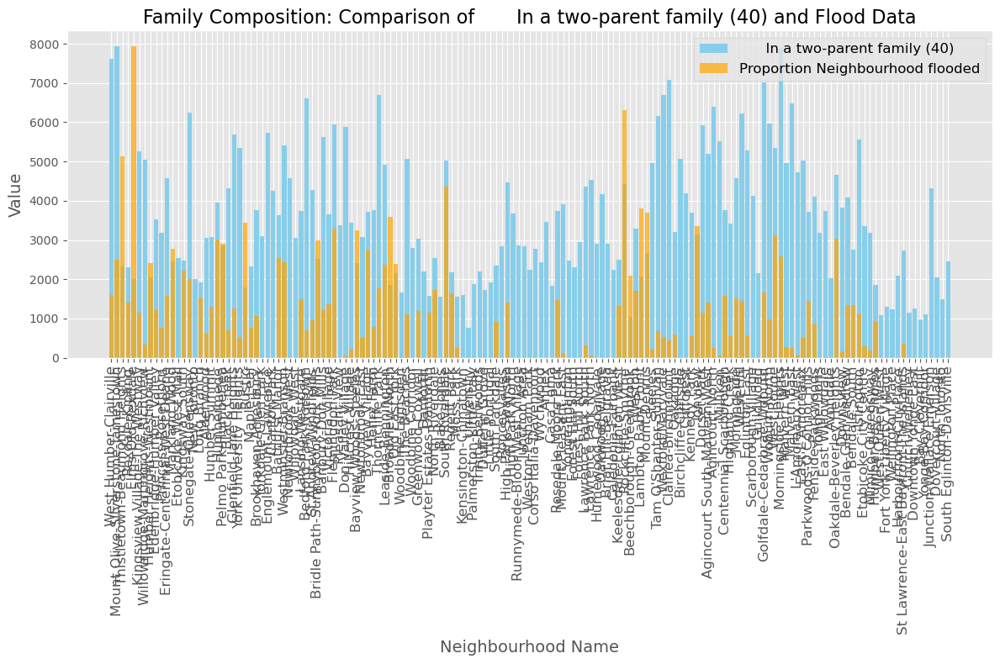

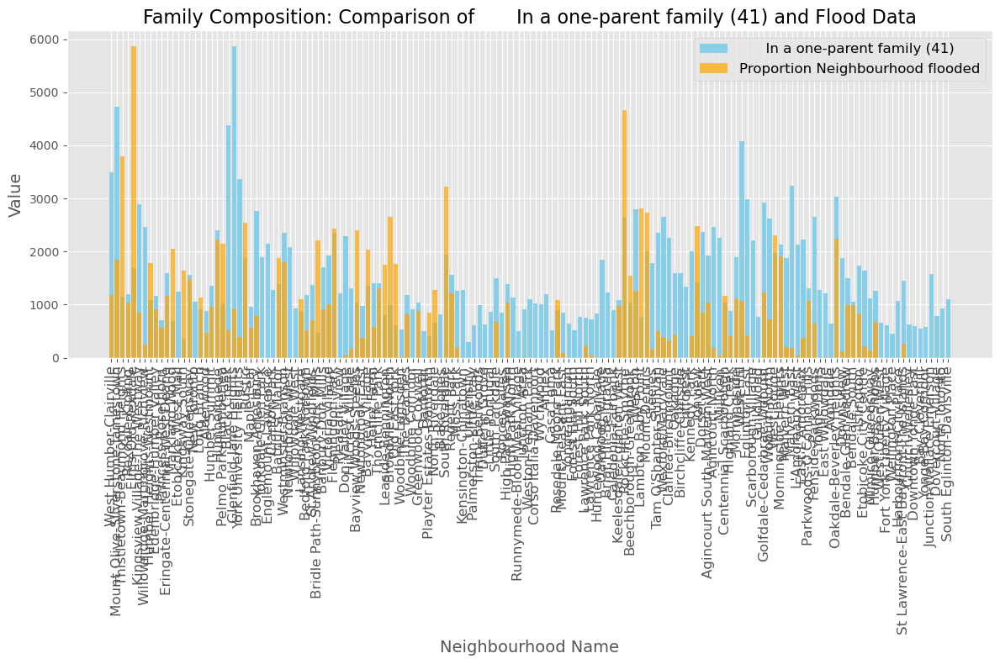

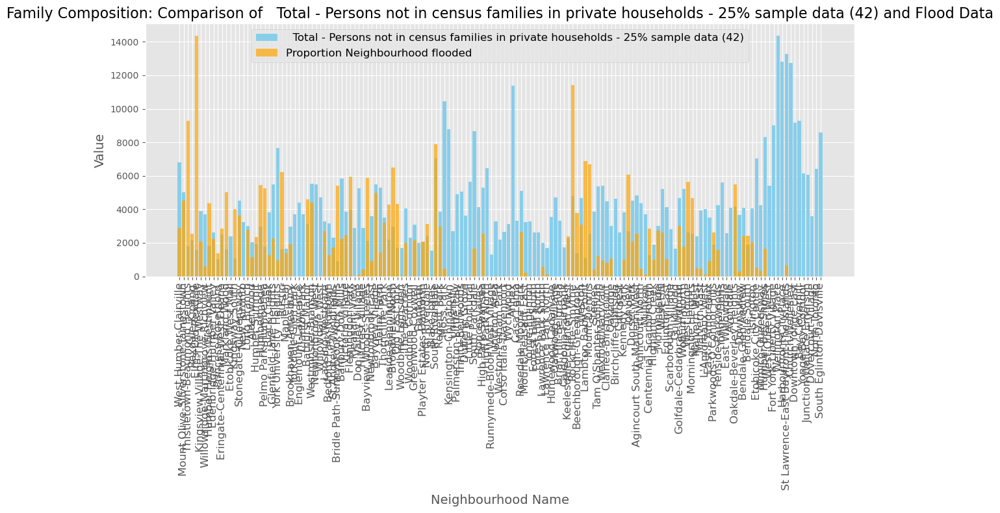

Plotting comparison bar charts for group: Income


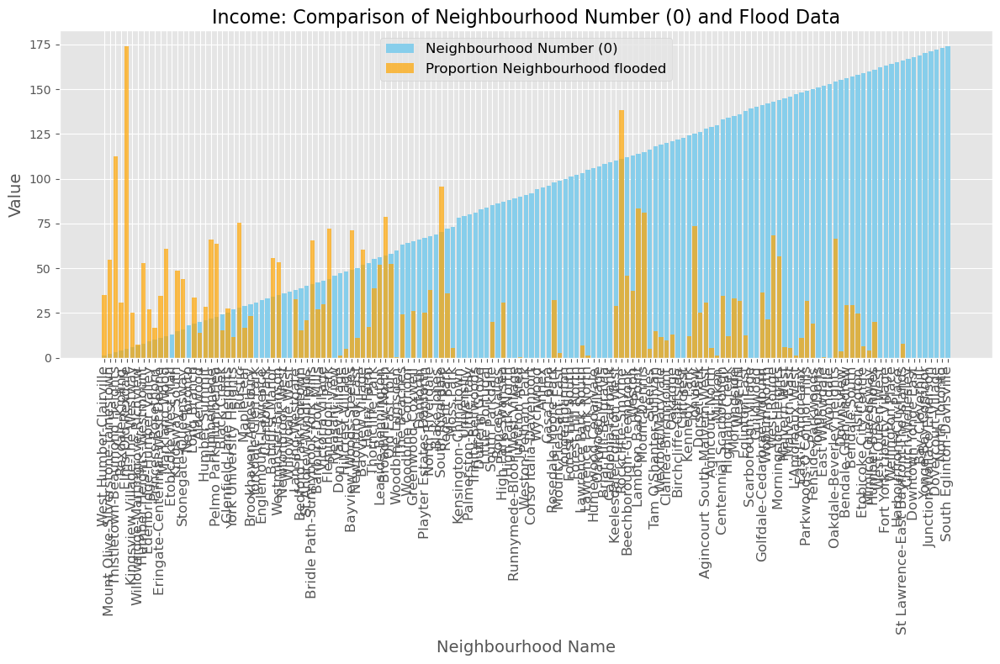

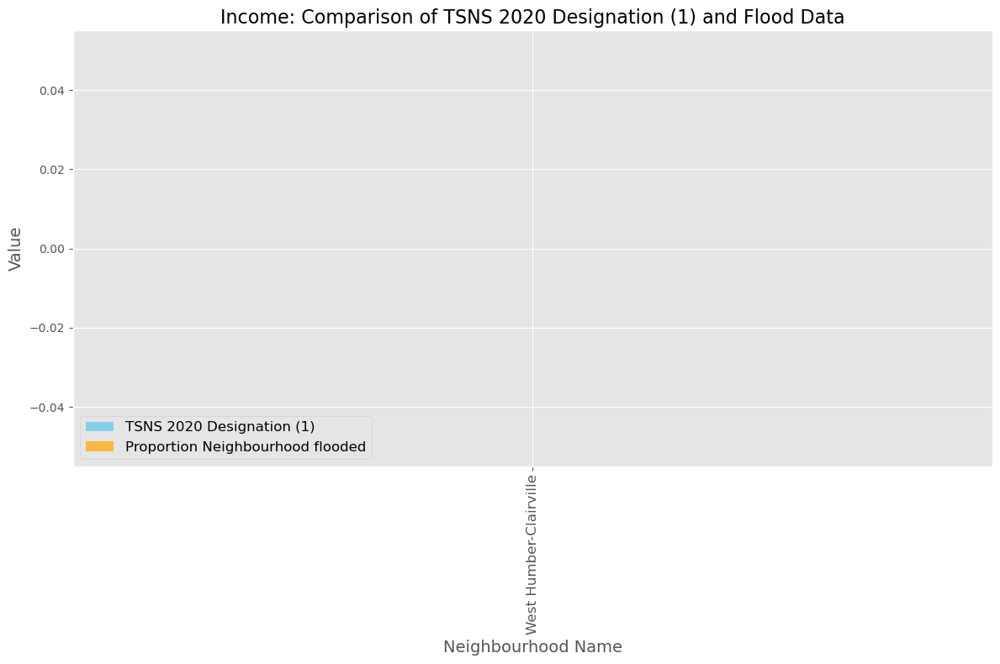

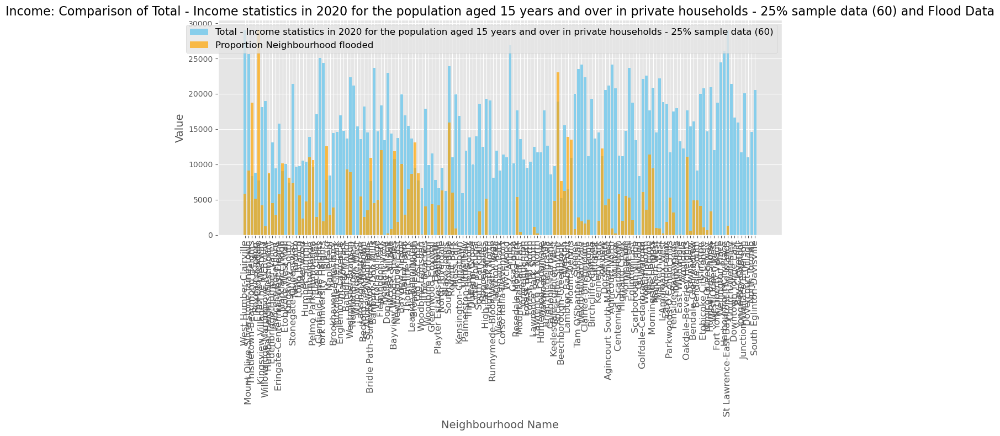

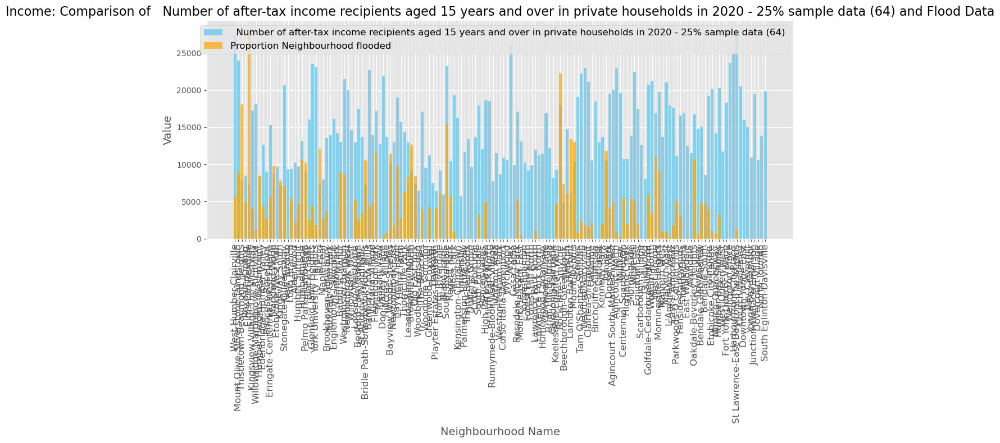

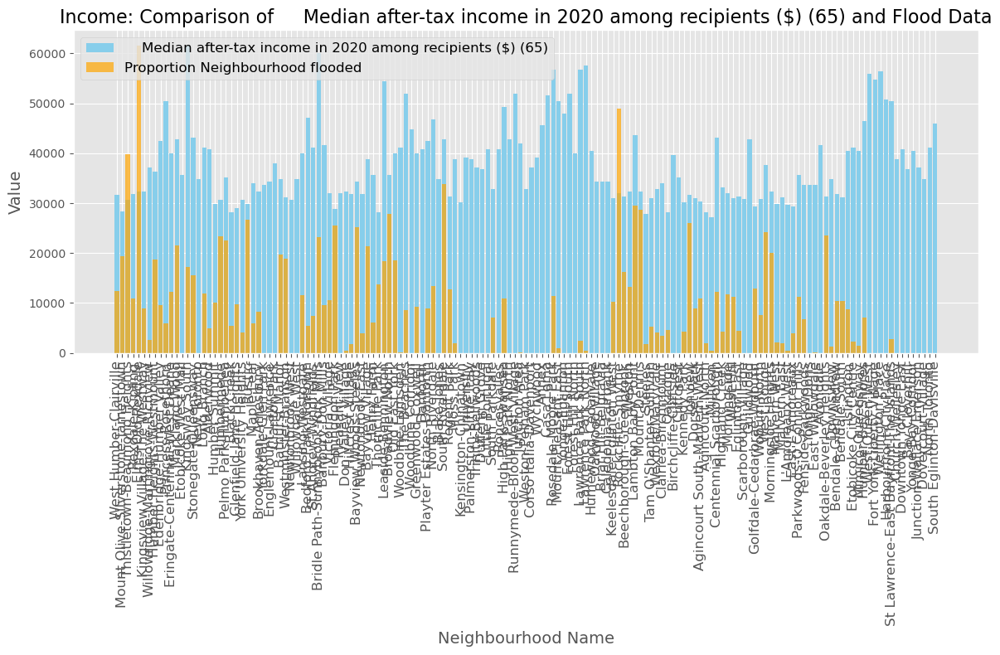

...

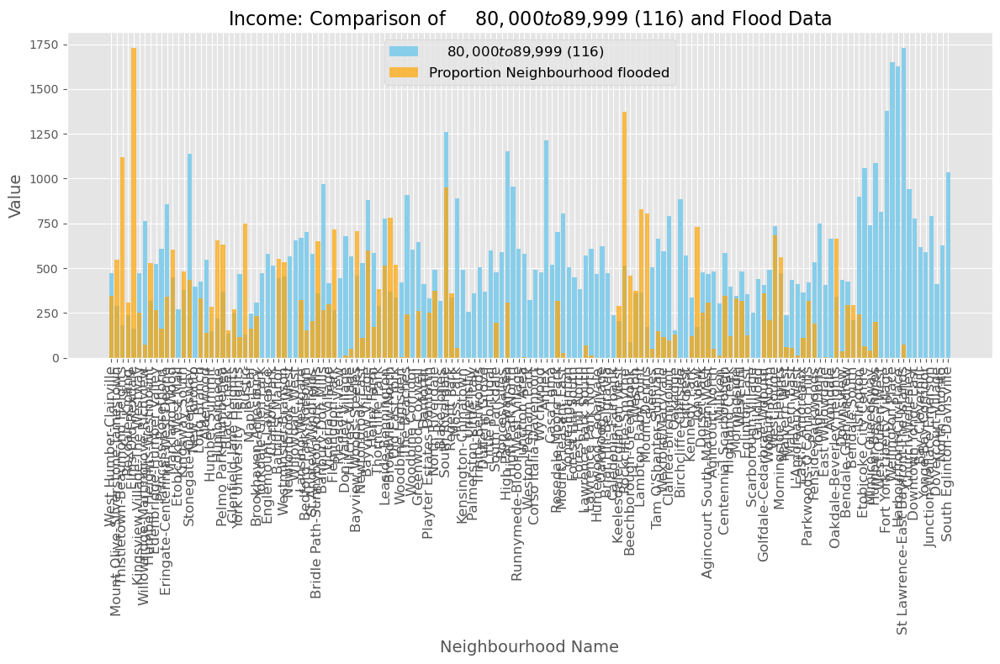

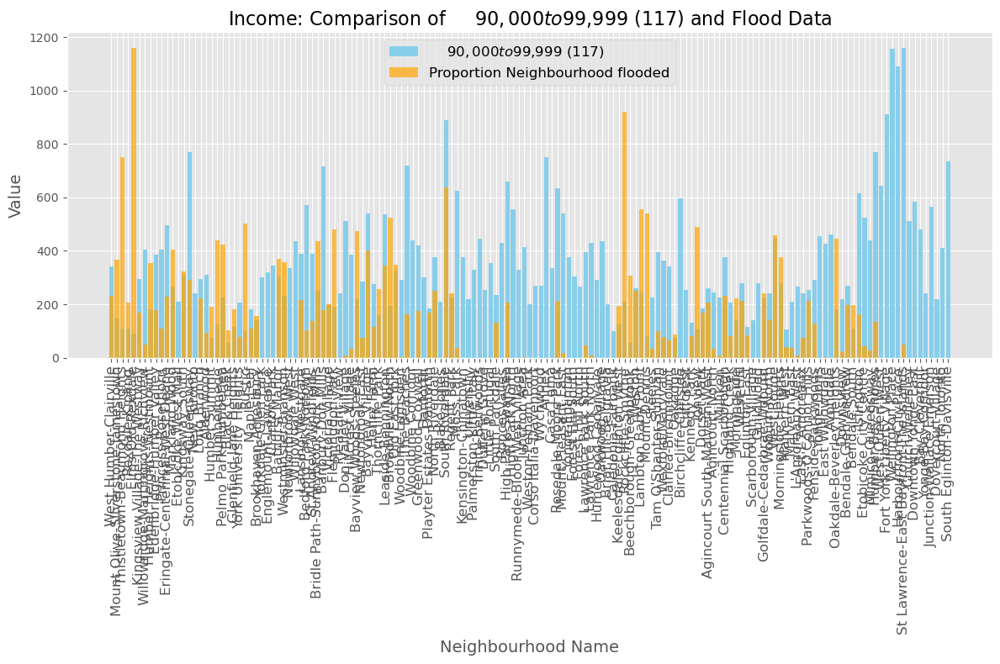

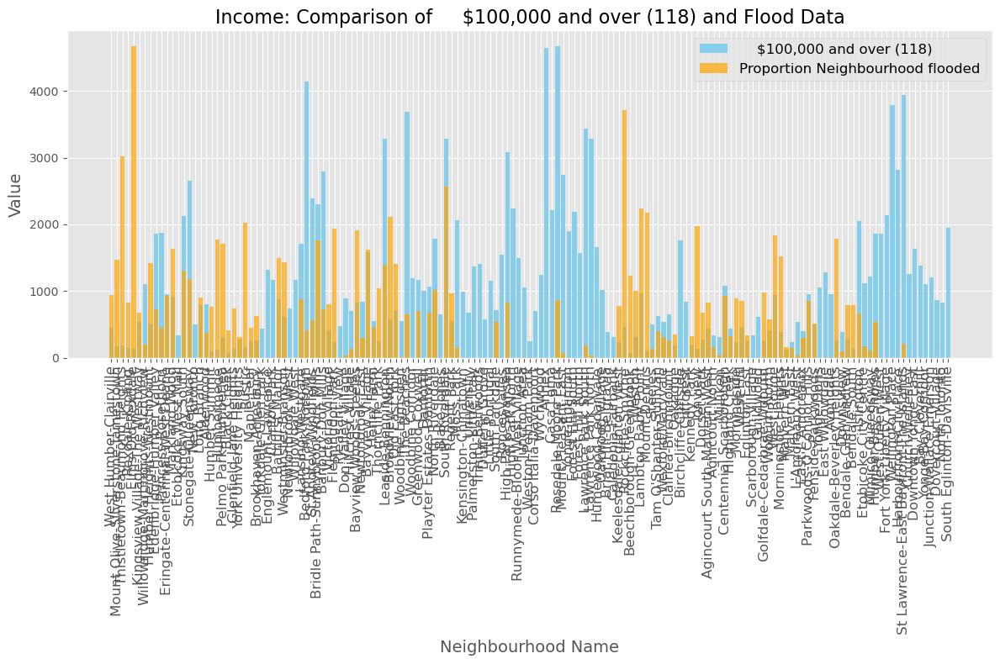

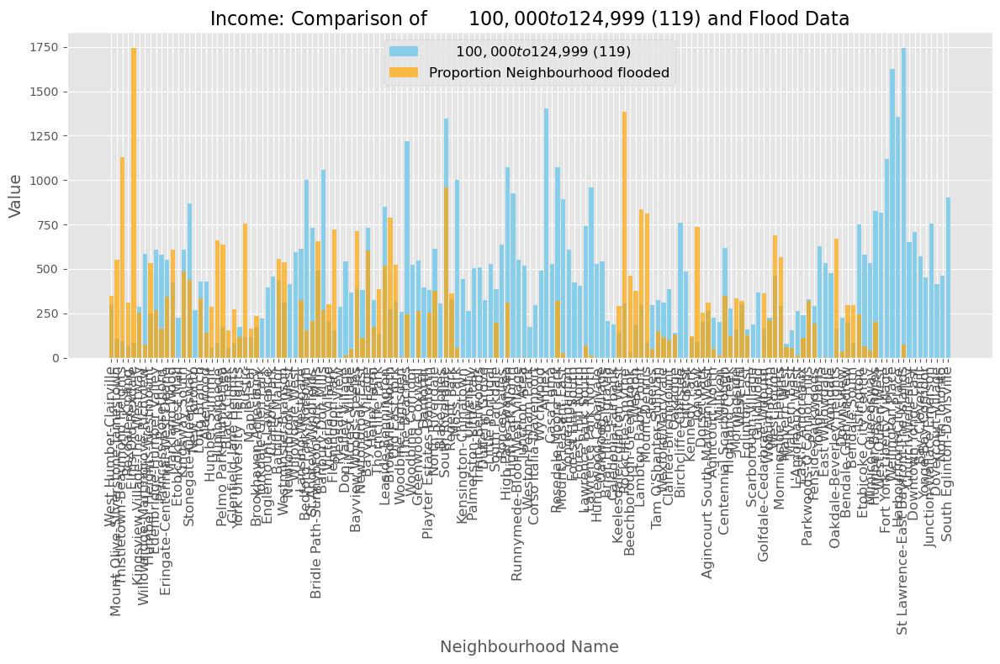

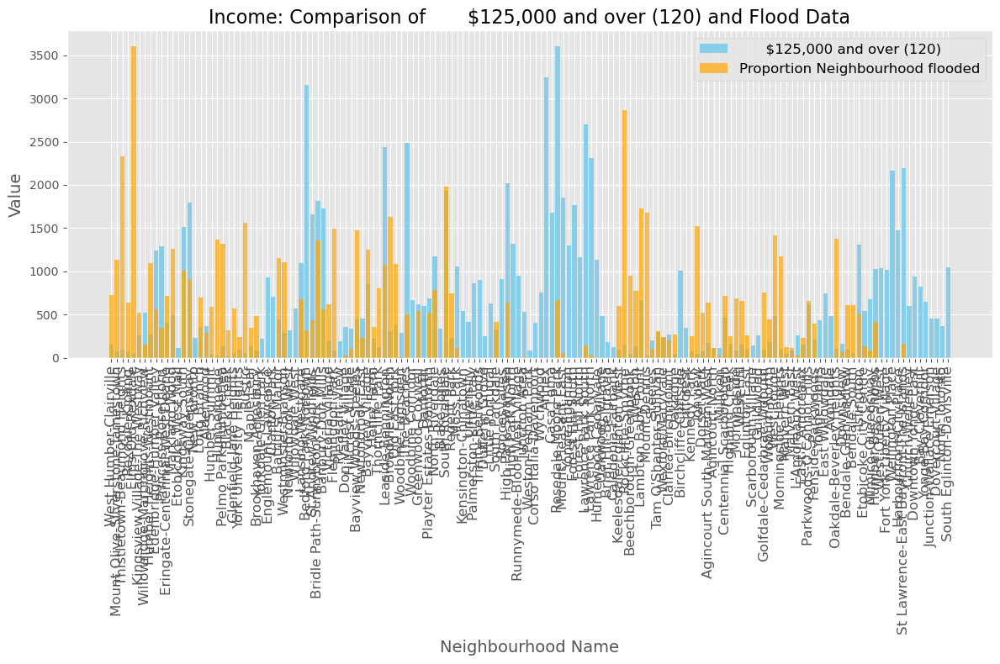

Plotting comparison bar charts for group: Housing


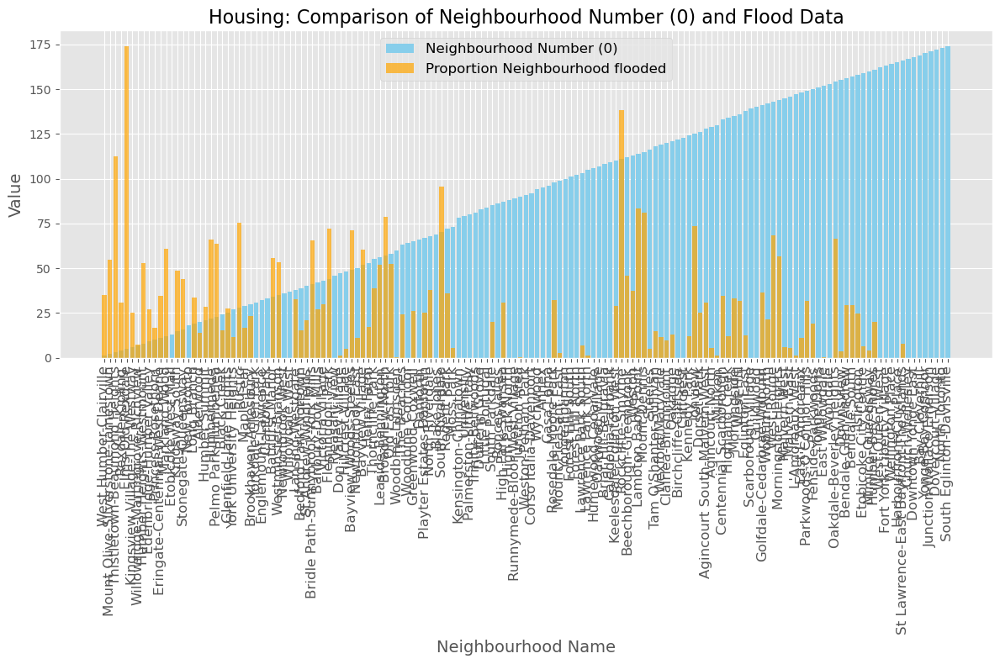

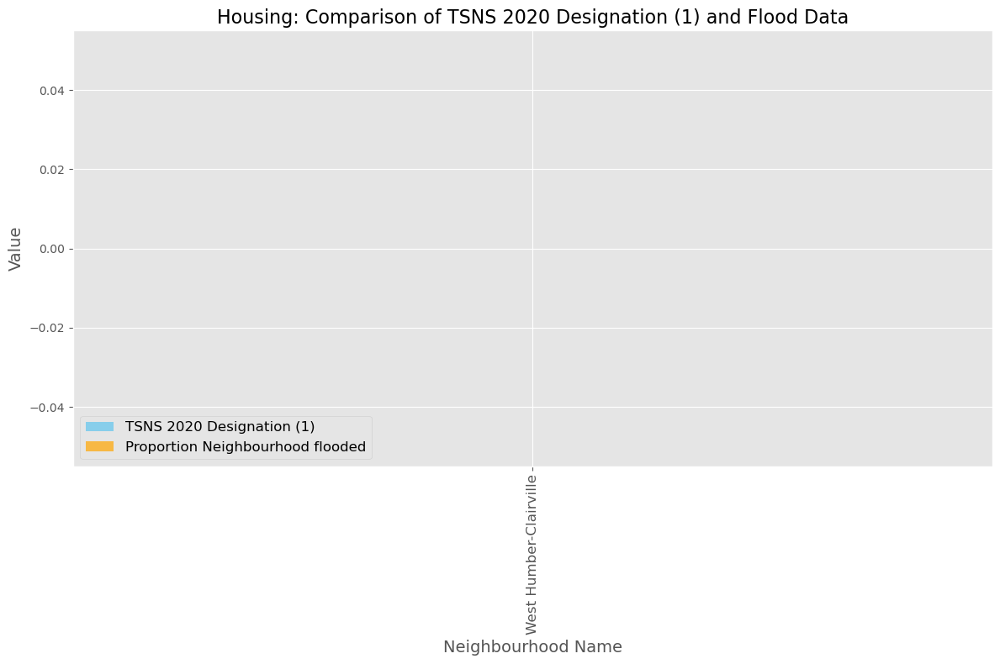

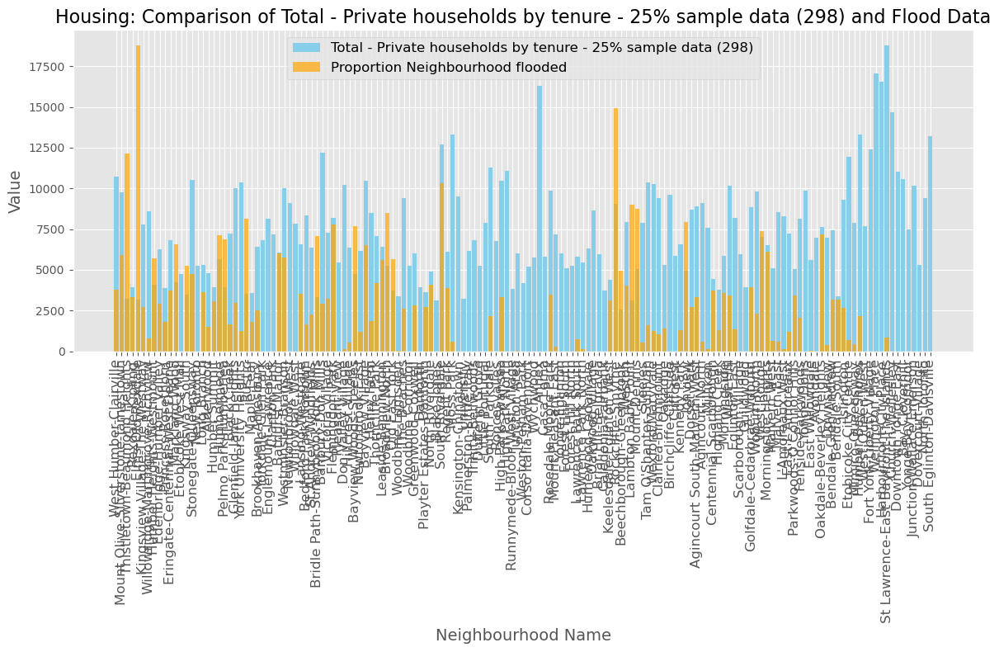

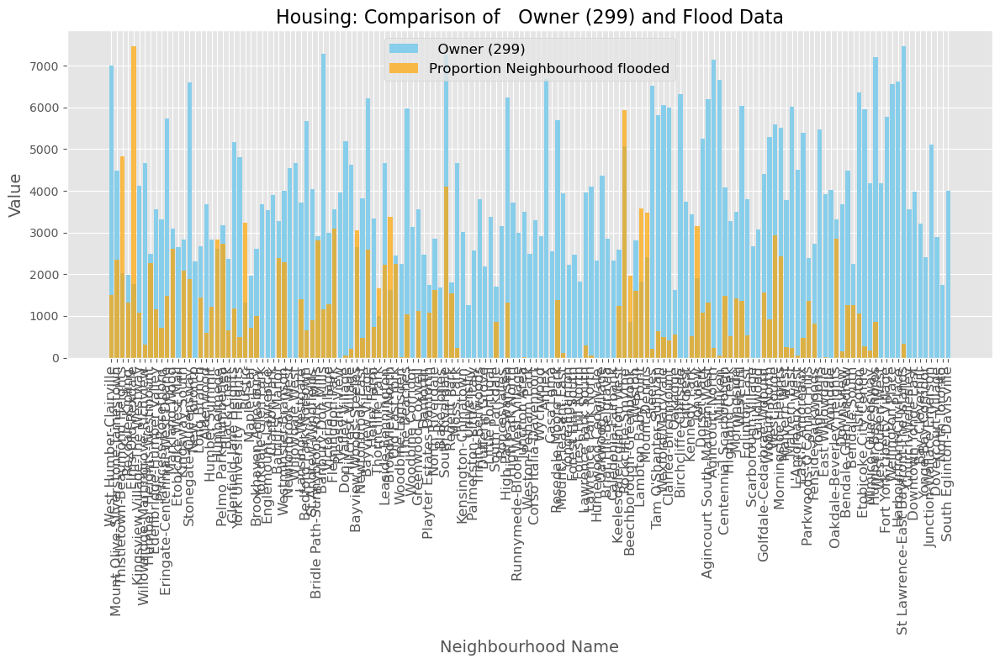

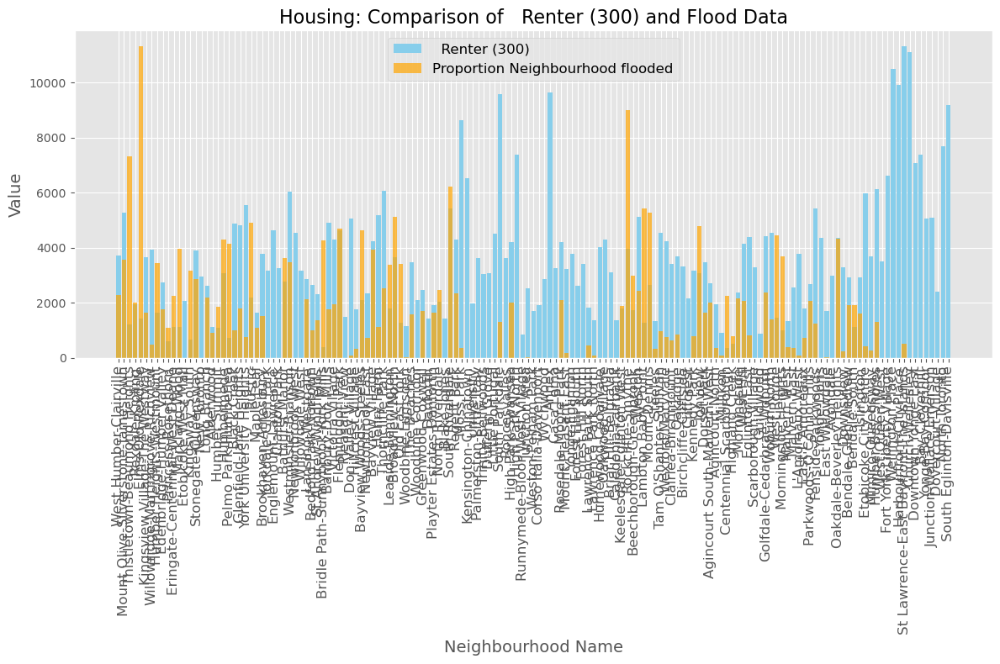

...

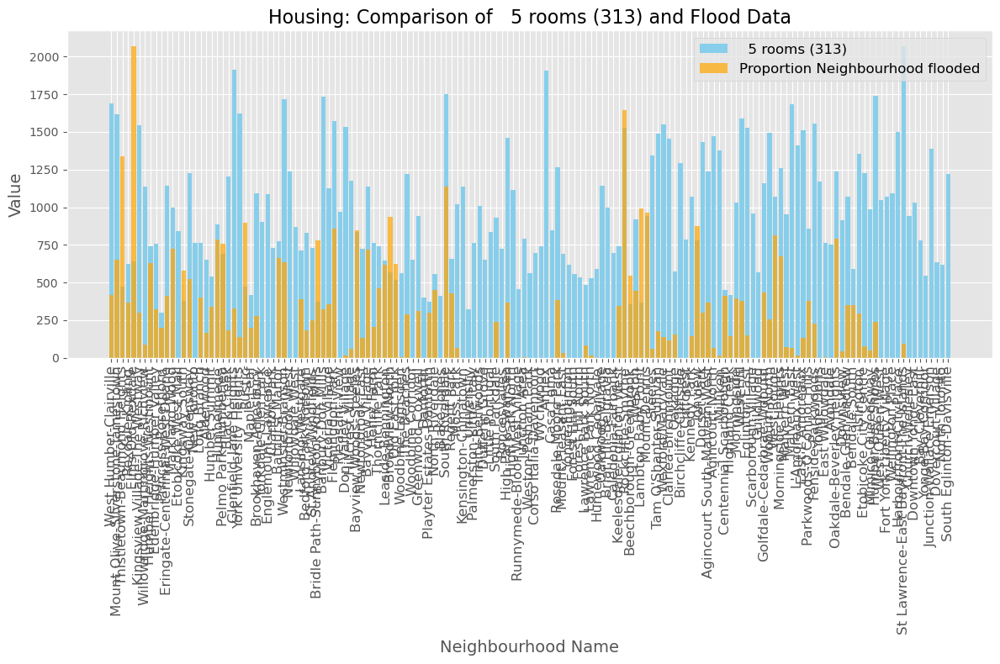

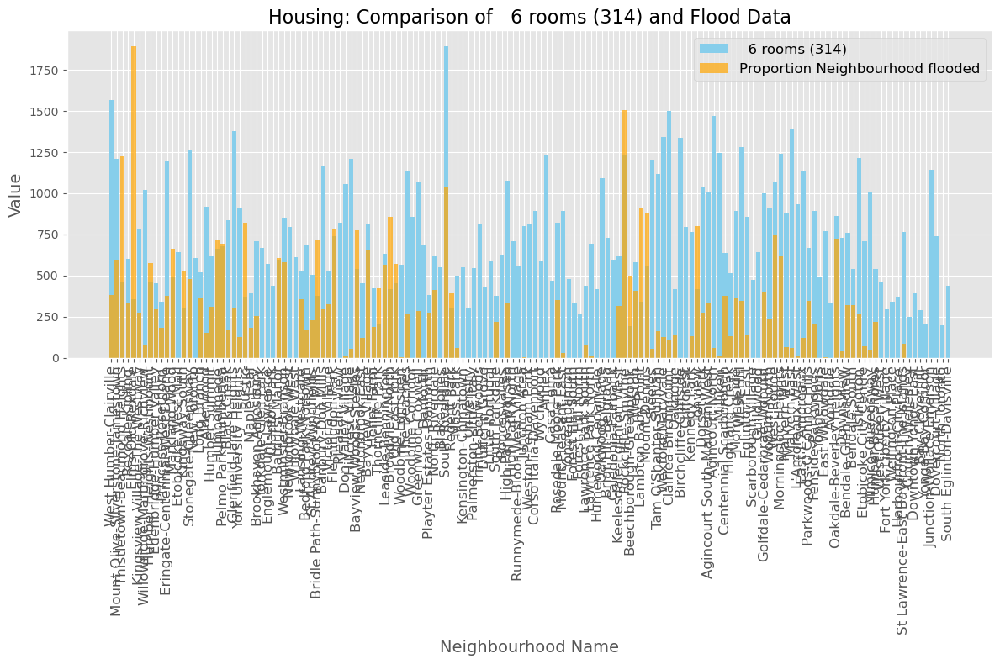

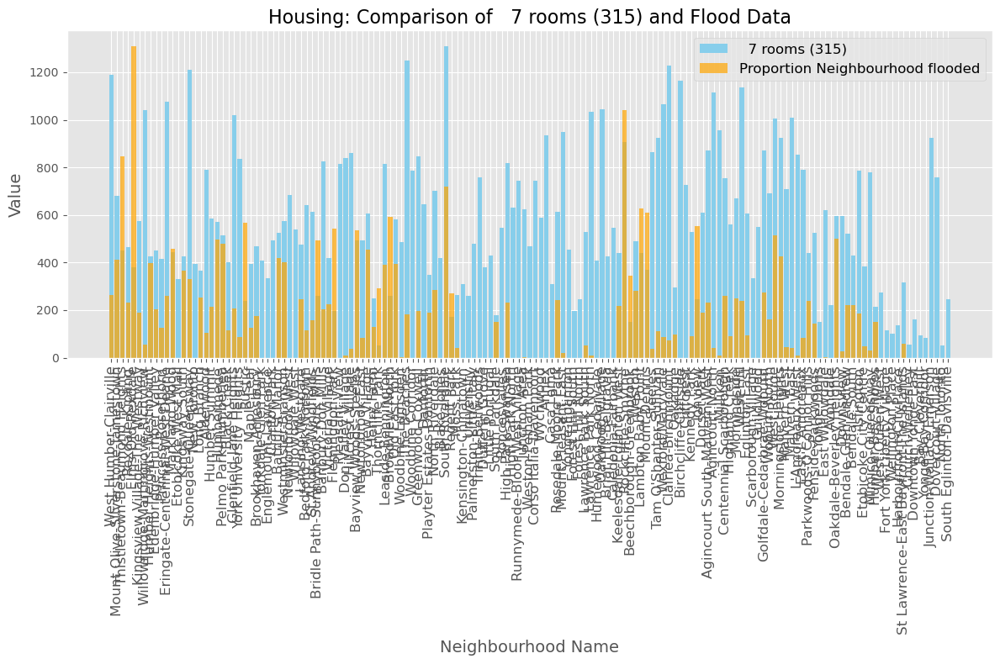

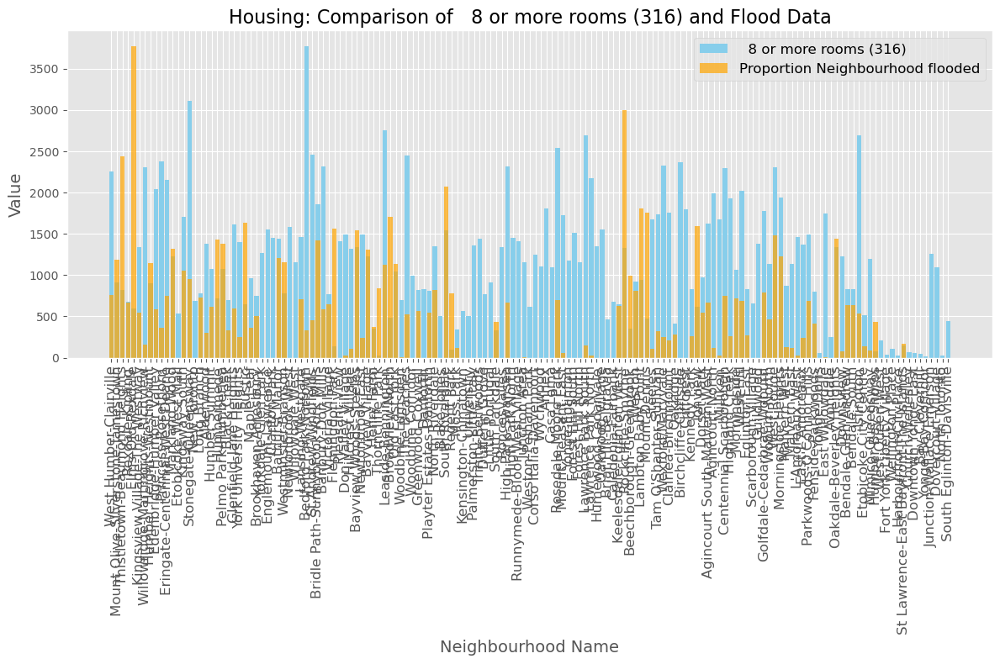

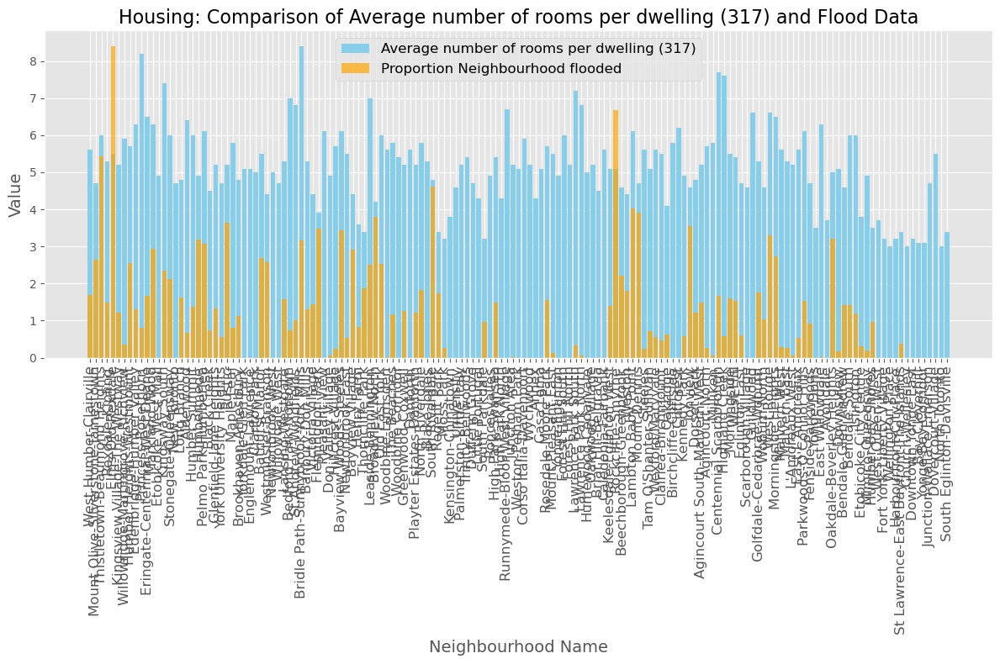

Plotting comparison bar charts for group: Condition


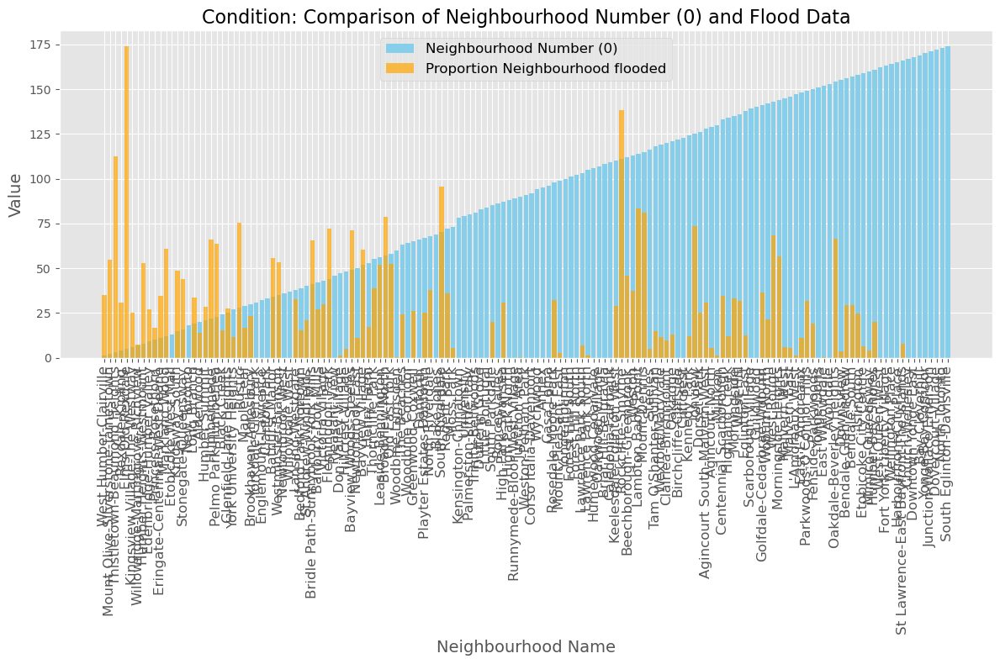

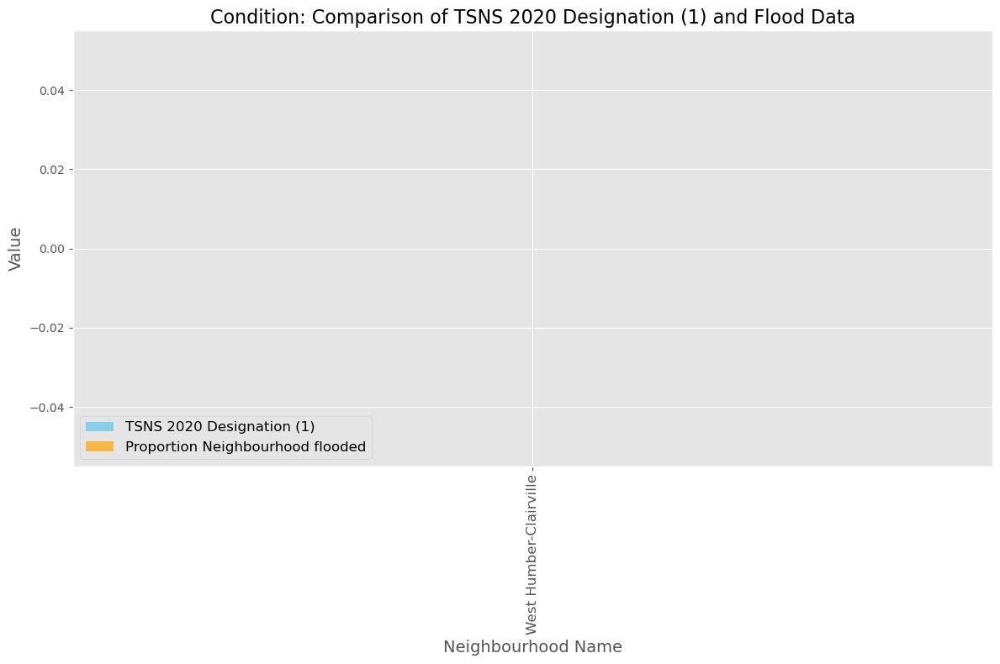

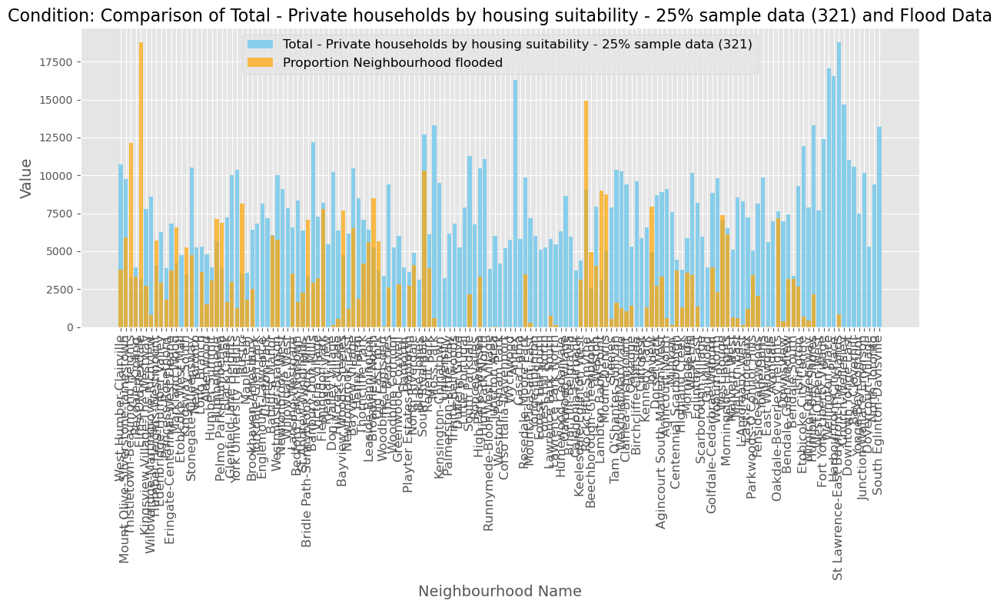

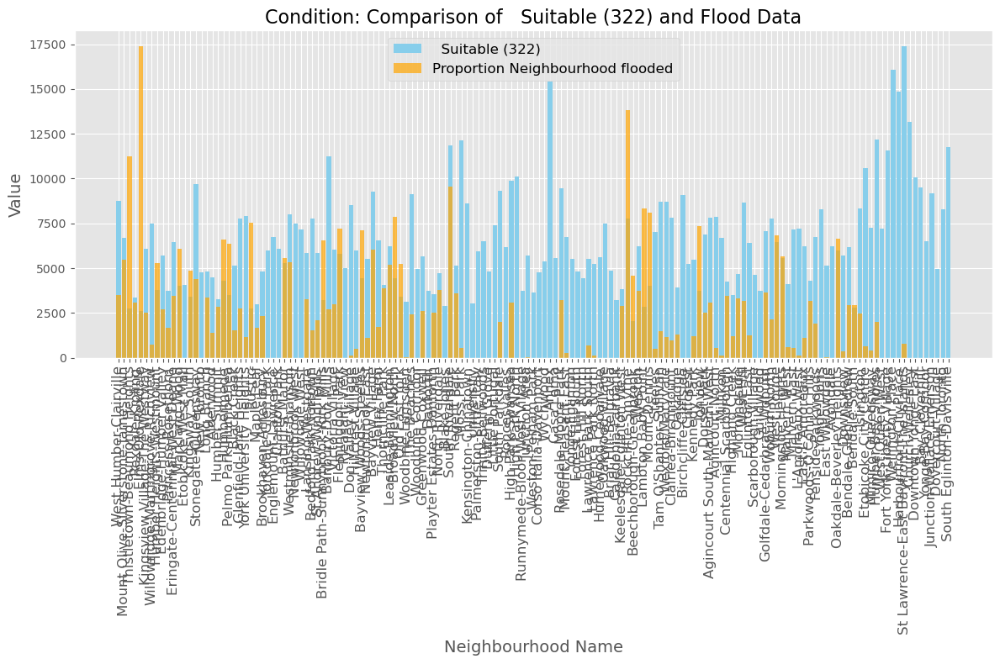

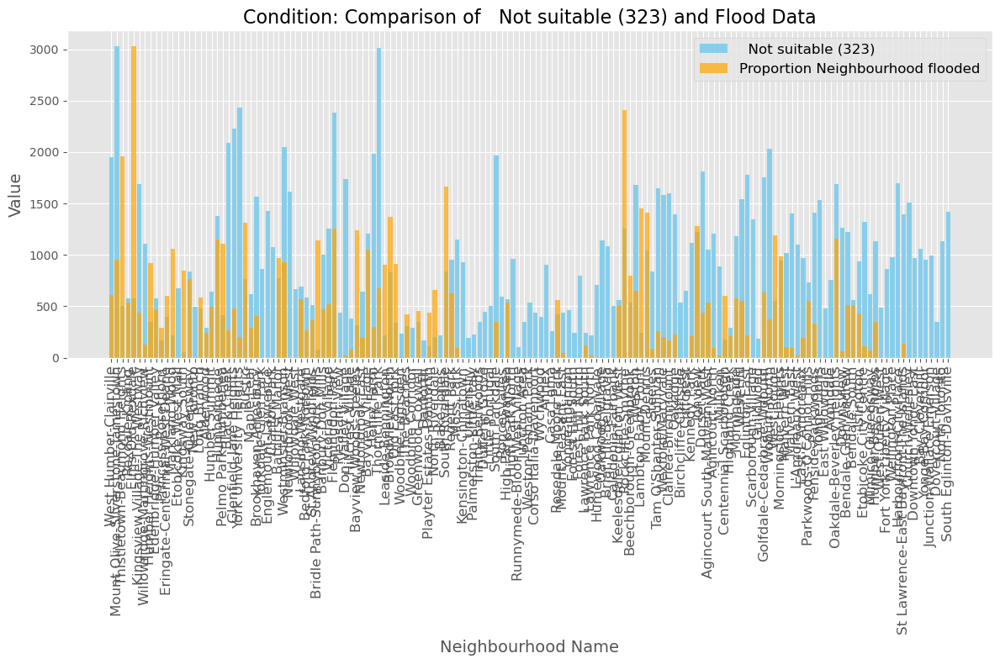

...

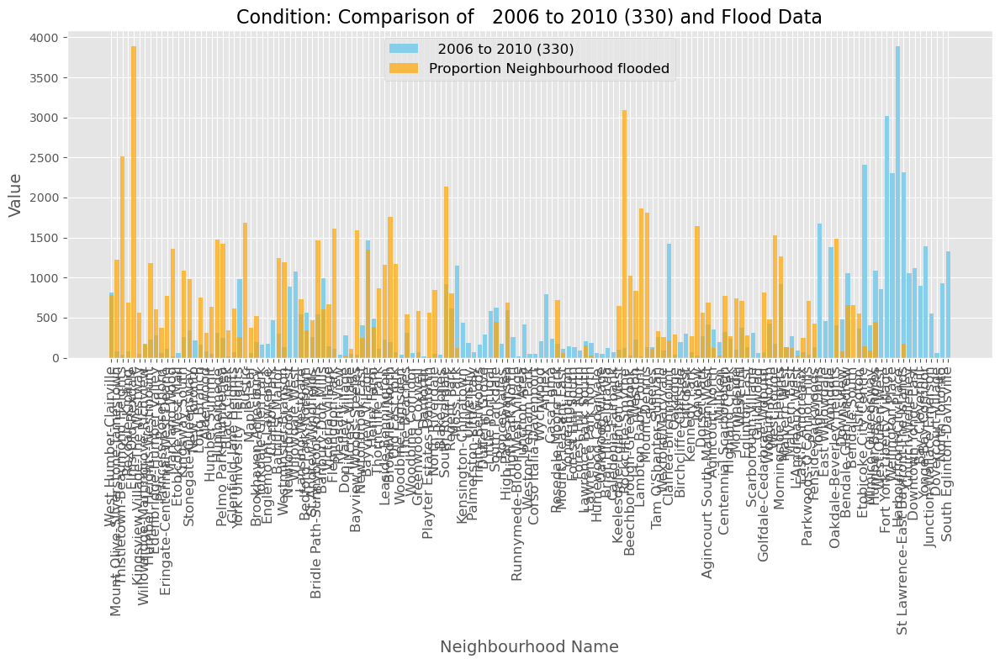

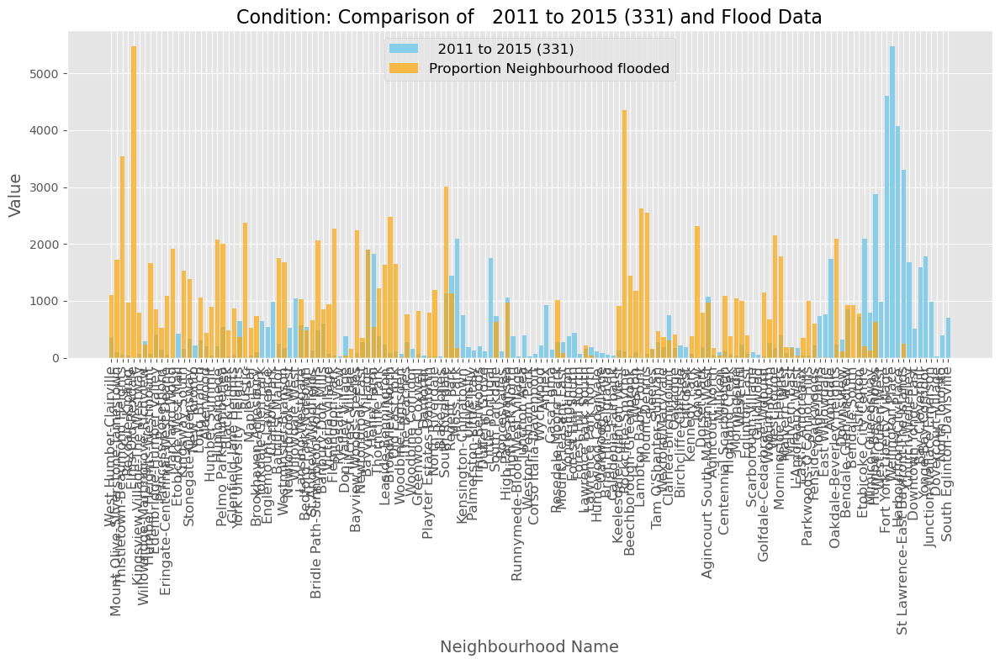

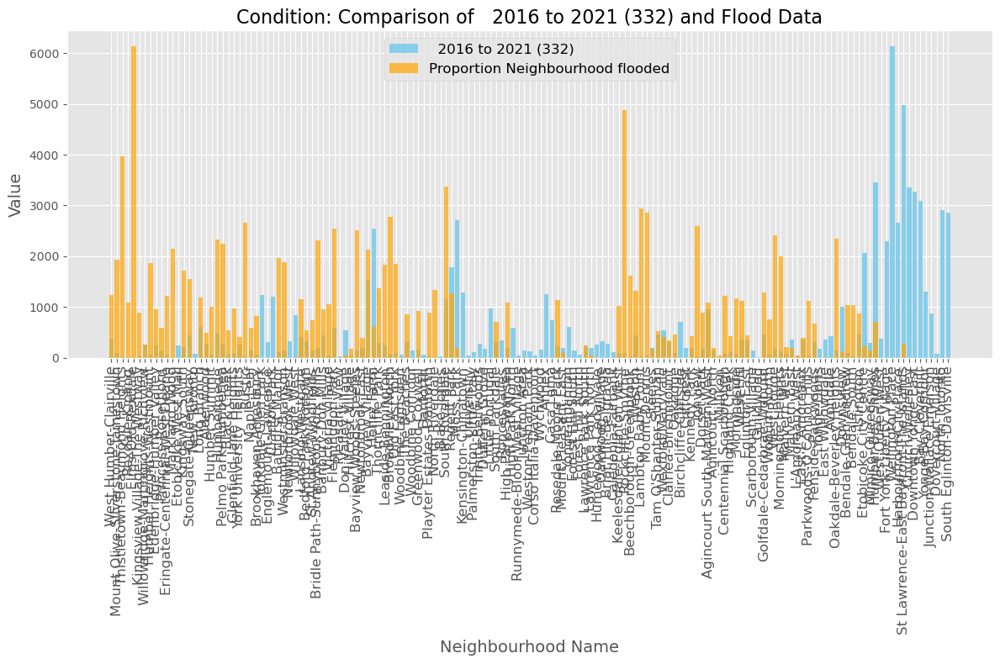

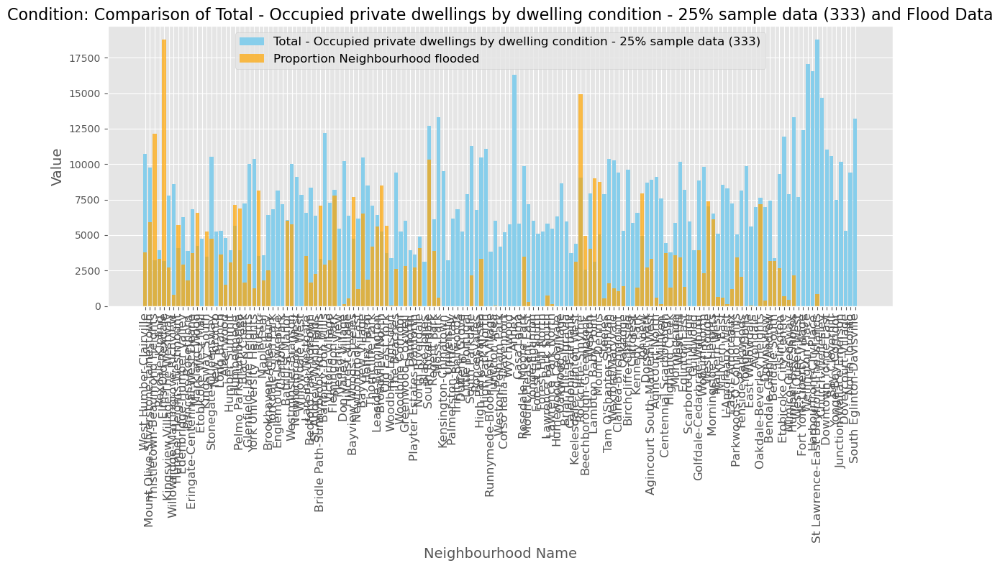

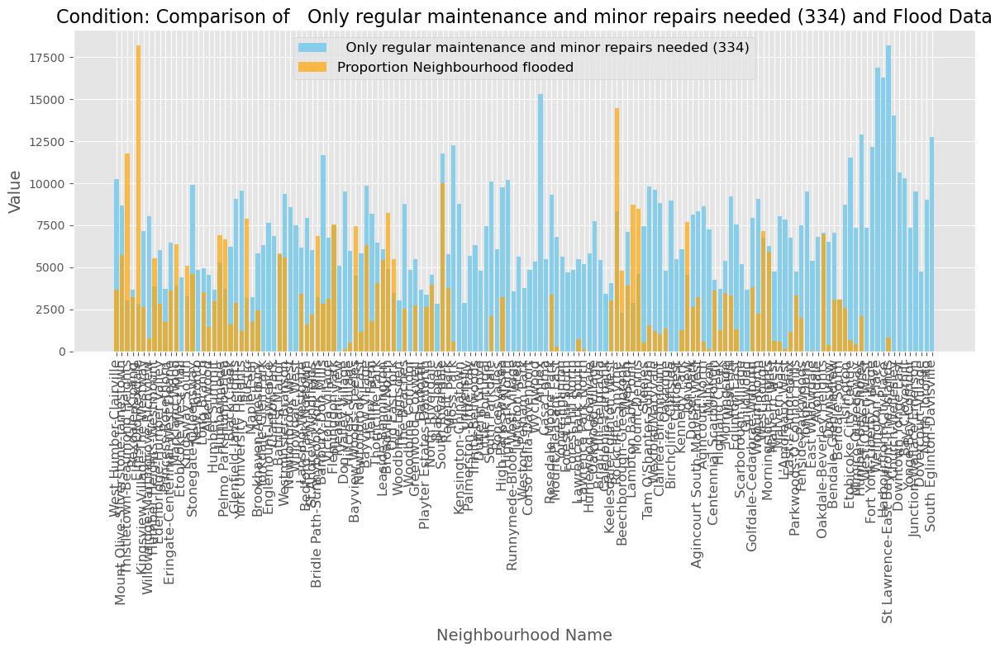

Plotting comparison bar charts for group: Language


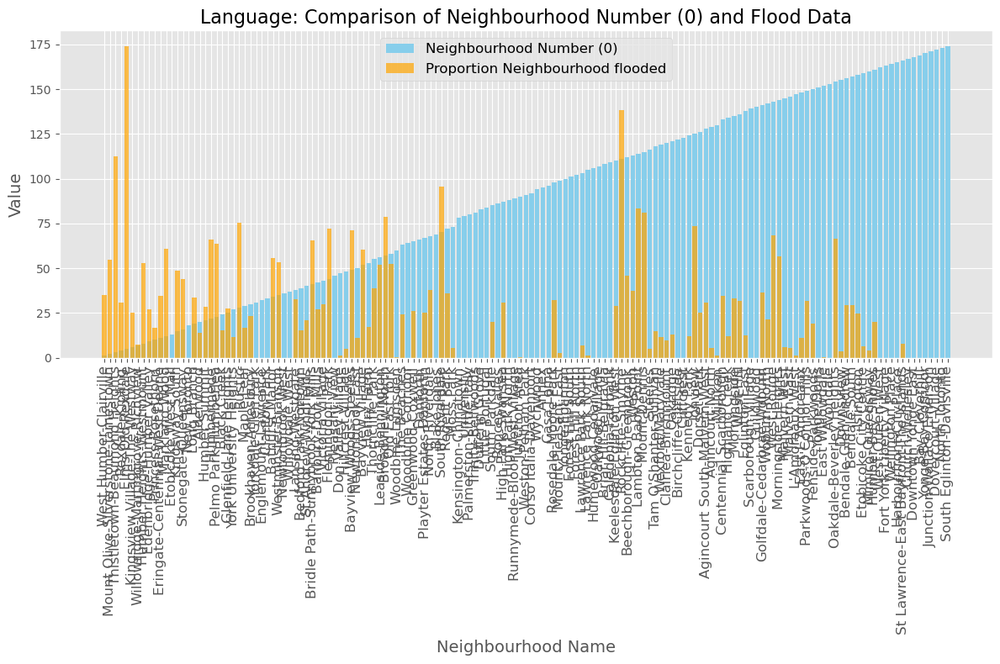

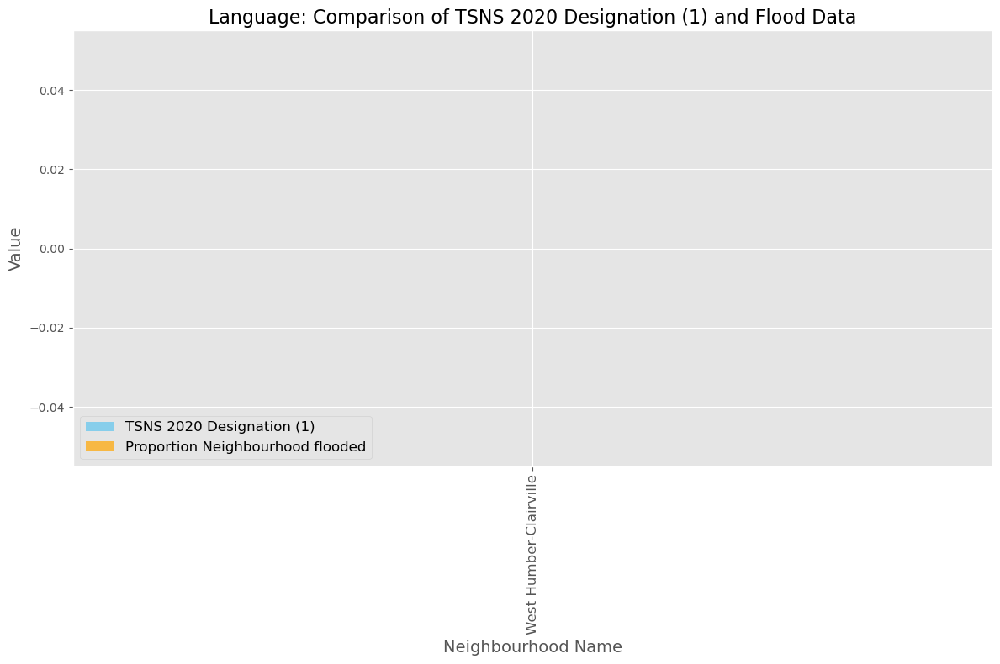

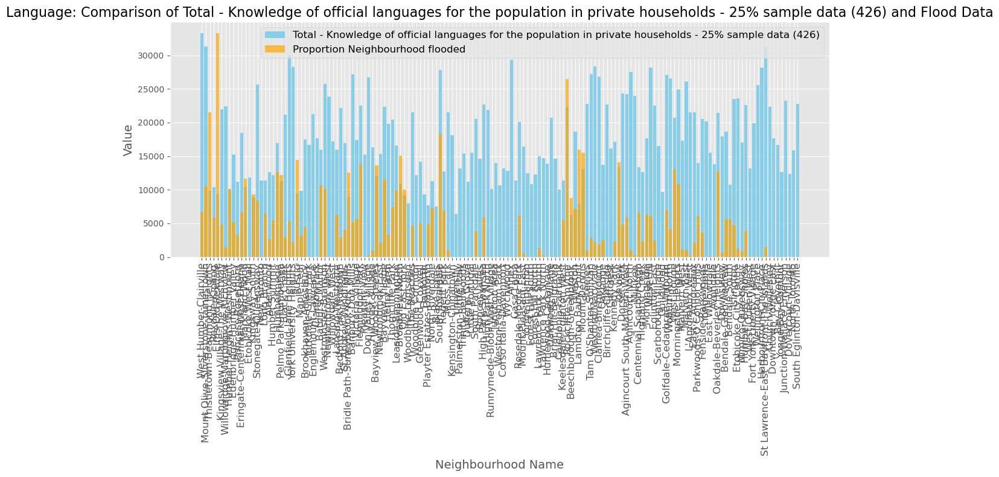

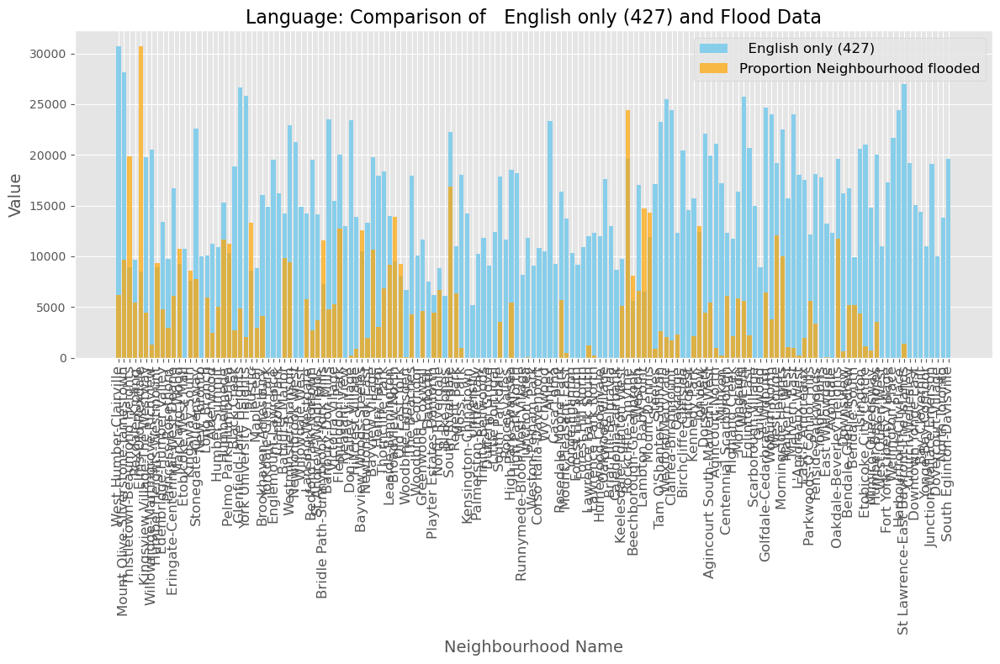

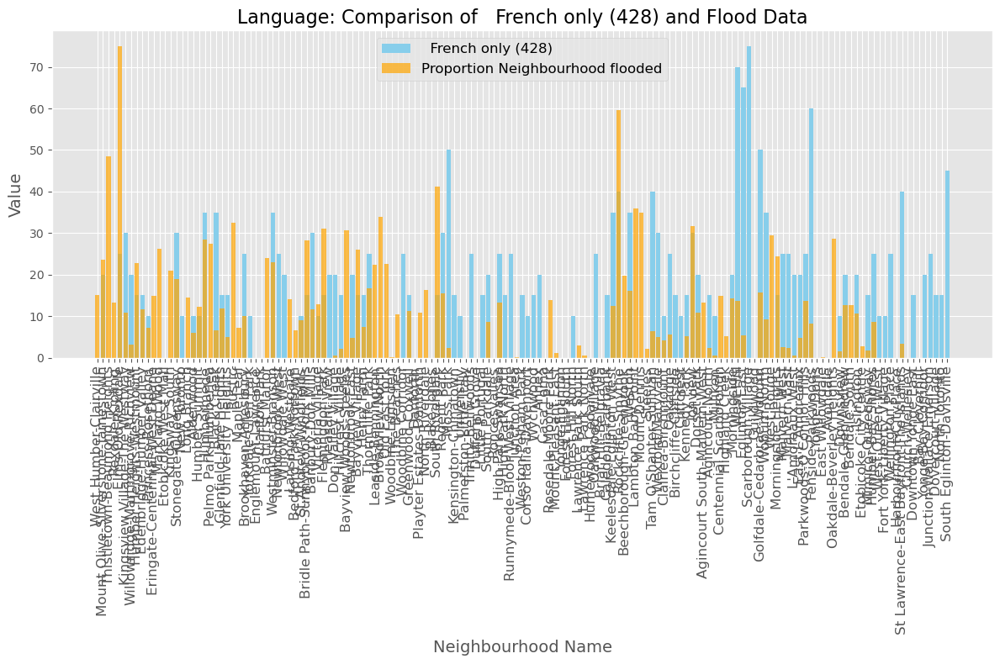

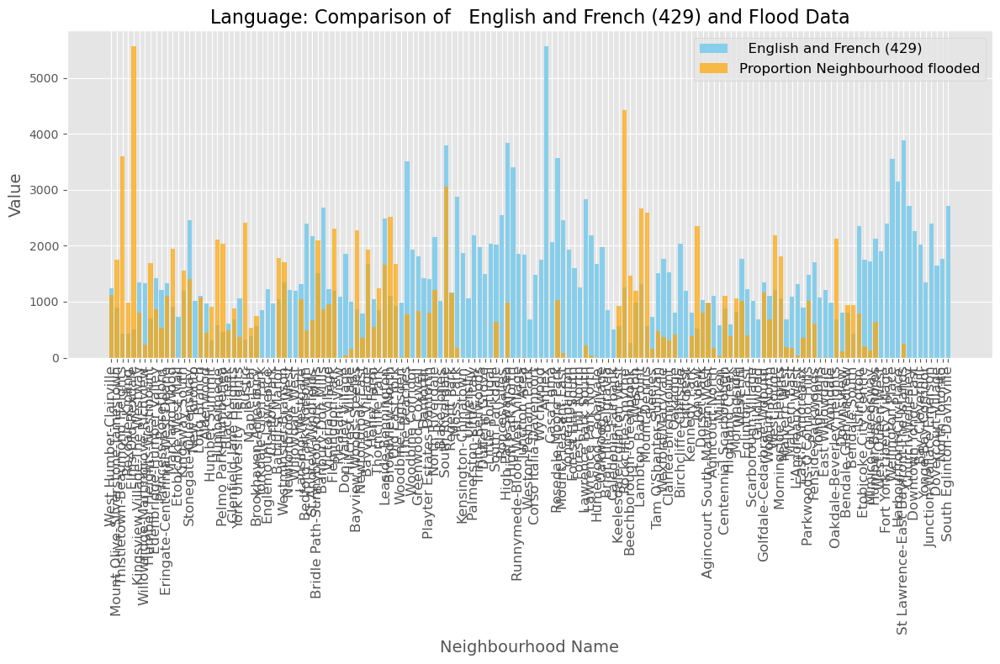

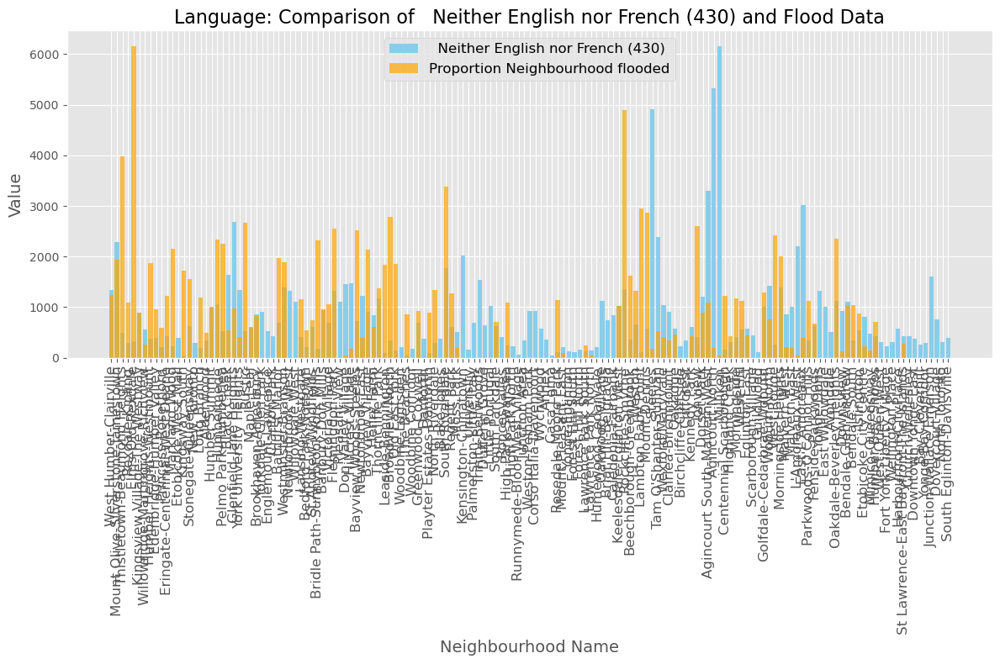

In [57]:
def plot_grouped_data_with_flood_comparison(dataframes, group_name, flood_data):
    # Get the DataFrame for the specified group
    df = dataframes[group_name]

    # Use the index of `df` as the neighborhood name and match it with `Neighbourhood_name` in flood_data
    neighborhood_index = df.index
    flood_neighborhood_column = 'Neighbourhood_name'  # From `gdf`
    flood_column = 'Proportion Neighbourhood flooded'

    # Ensure both neighborhood names are strings for consistency
    neighborhood_index = neighborhood_index.astype(str)
    flood_data[flood_neighborhood_column] = flood_data[flood_neighborhood_column].astype(str)

    # Merge flood data based on neighborhood names
    merged_df = df.copy()
    merged_df = merged_df.merge(flood_data[[flood_neighborhood_column, flood_column]],
                                left_index=True,
                                right_on=flood_neighborhood_column,
                                how='left')

    # Iterate over all columns in the group
    for column in df.columns:
        if column not in ['geometry (2603)']:
            plt.figure(figsize=(12, 8))

            # Ensure numeric conversion
            try:
                merged_df[column] = pd.to_numeric(merged_df[column], errors='coerce')
                merged_df[flood_column] = pd.to_numeric(merged_df[flood_column], errors='coerce')
            except Exception as e:
                print(f"Error converting columns to numeric: {e}")
                continue

            # Plot the primary column (group data) in blue
            plt.bar(merged_df[flood_neighborhood_column], merged_df[column], color='skyblue', label=column)

            # Scale the flood data if needed for better visibility
            if merged_df[flood_column].max() > 0:
                flood_scaled = merged_df[flood_column] * (merged_df[column].max() / merged_df[flood_column].max())
            else:
                flood_scaled = merged_df[flood_column]  # No scaling if all flood values are zero
            
            # Overlay flood proportion in orange
            plt.bar(merged_df[flood_neighborhood_column], flood_scaled, 
                    color='orange', alpha=0.7, label=flood_column)

            # Customize the plot
            plt.title(f"{group_name}: Comparison of {column} and Flood Data", fontsize=16)
            plt.xlabel('Neighbourhood Name', fontsize=14)
            plt.ylabel('Value', fontsize=14)
            plt.xticks(rotation=90, fontsize=12)
            plt.legend(fontsize=12)
            plt.tight_layout()
            plt.show()

# Iterate through each group and plot
for group_name in grouped_columns.keys():
    print(f"Plotting comparison bar charts for group: {group_name}")
    plot_grouped_data_with_flood_comparison(dataframes, group_name, gdf)


Plotting bar charts for group: Demographics


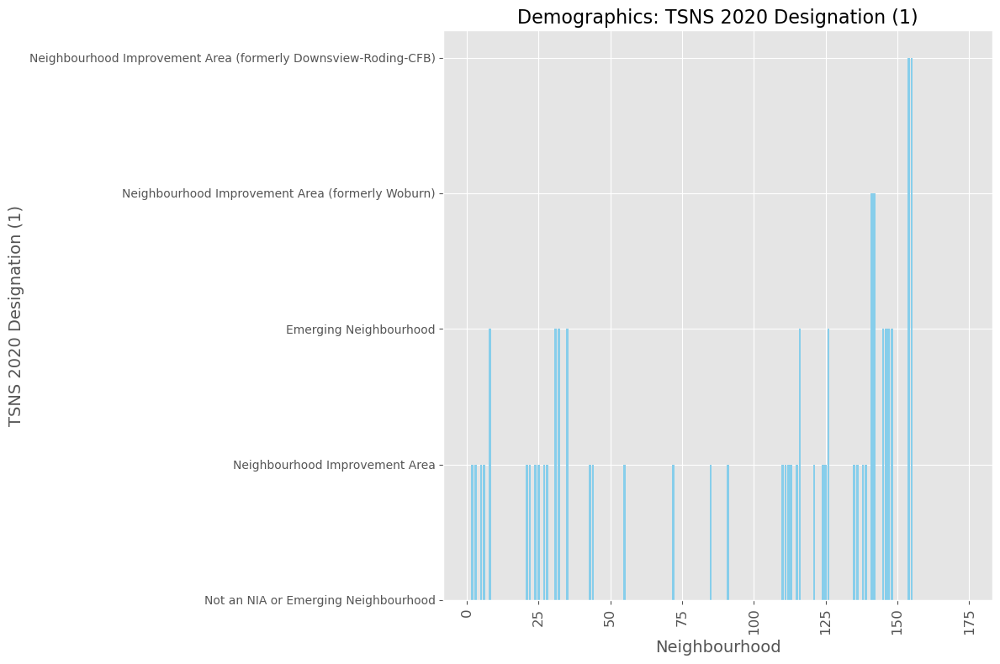

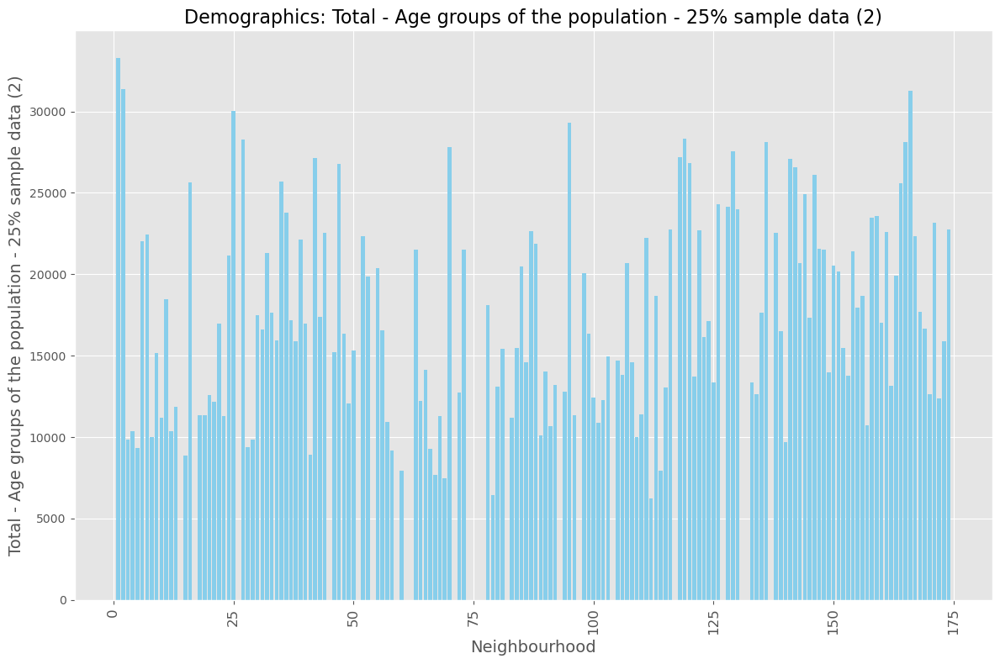

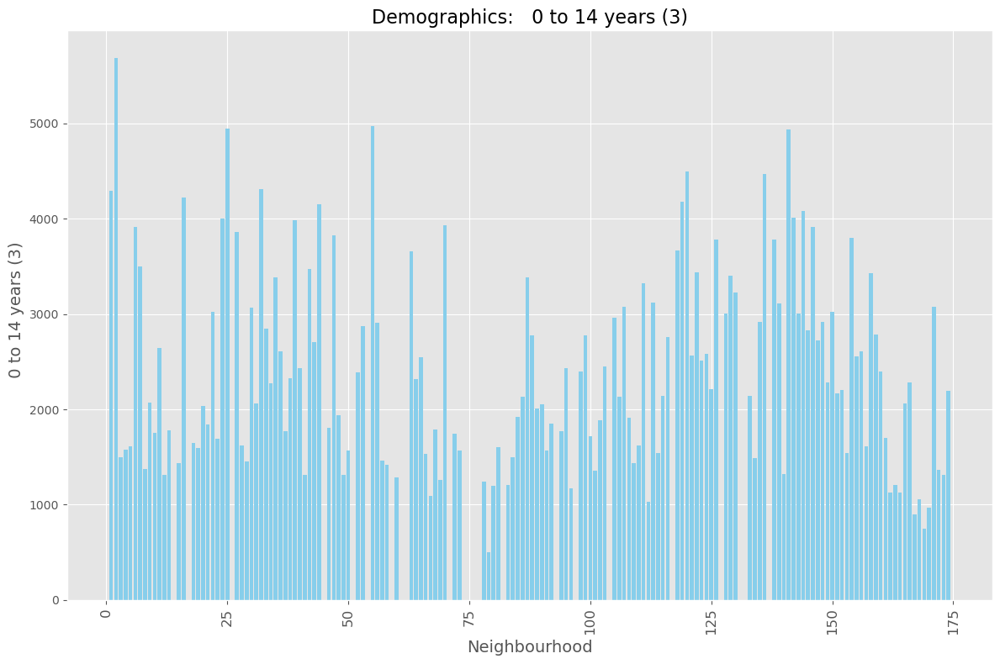

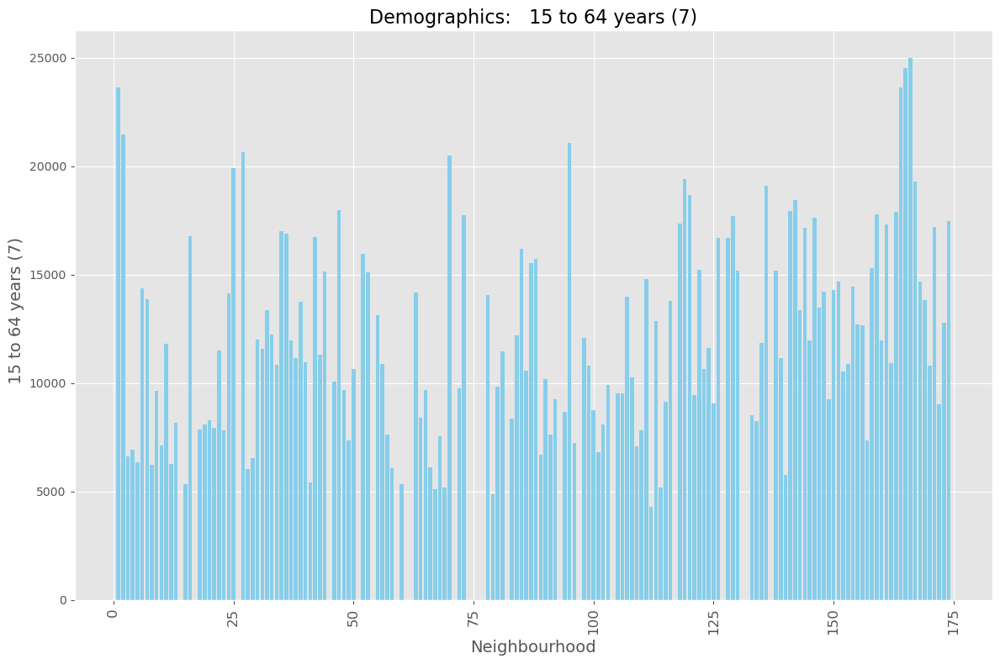

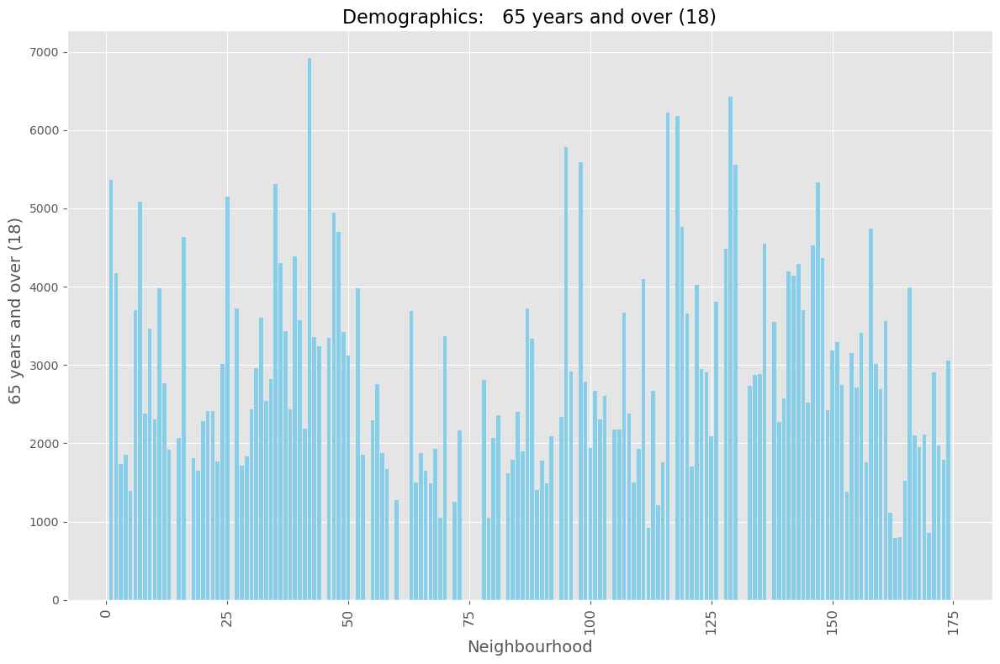

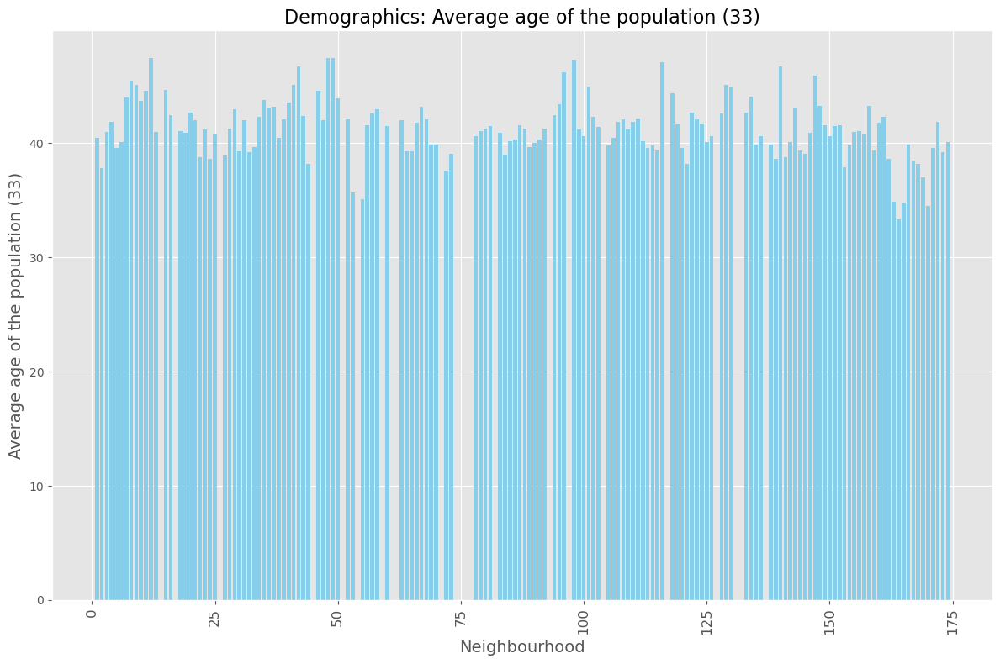

Plotting bar charts for group: Family Composition


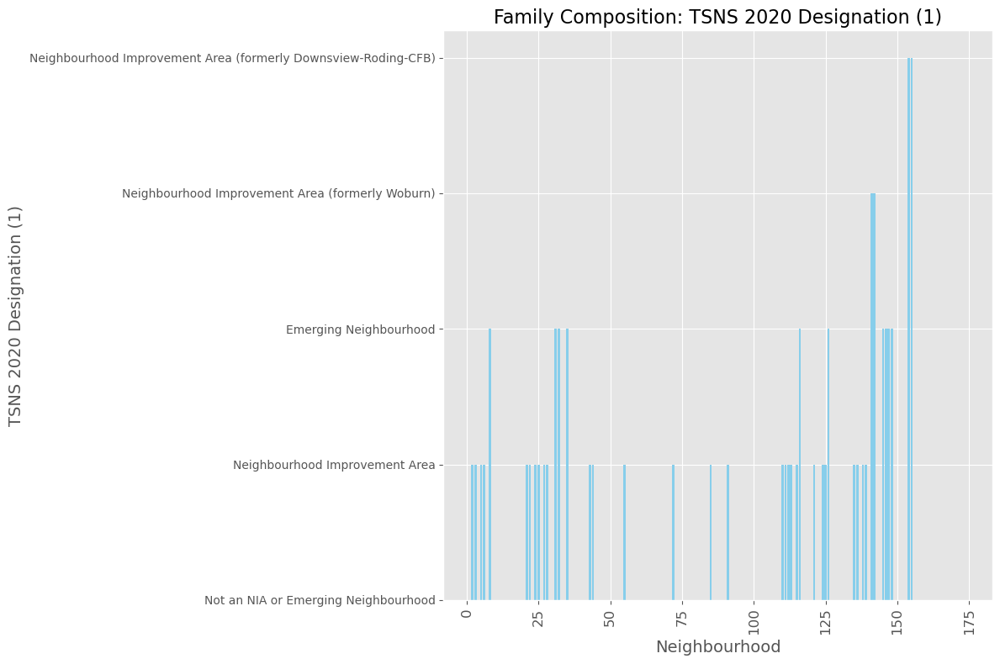

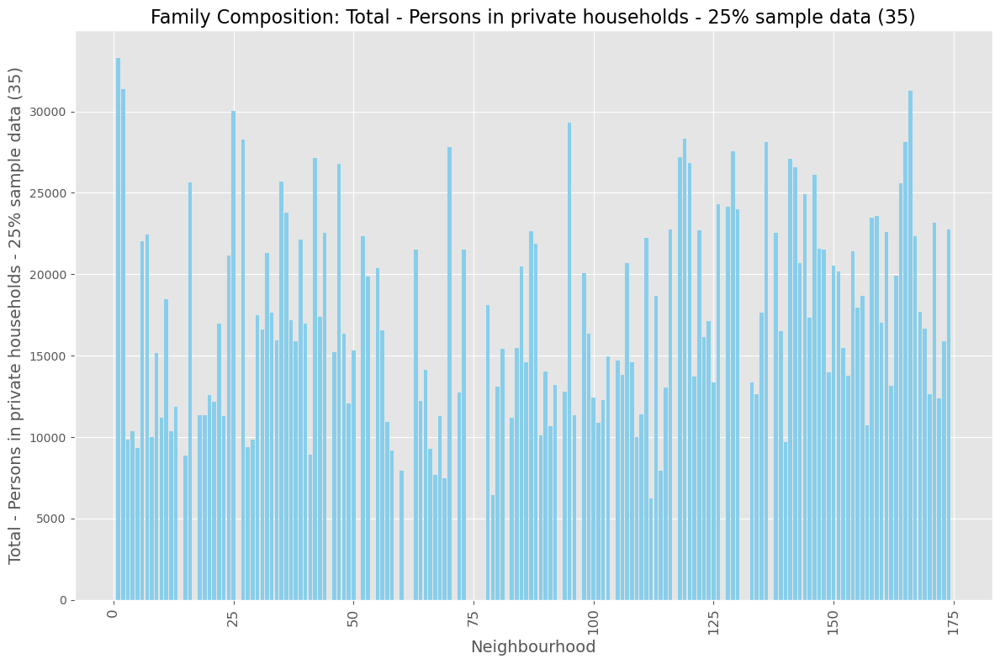

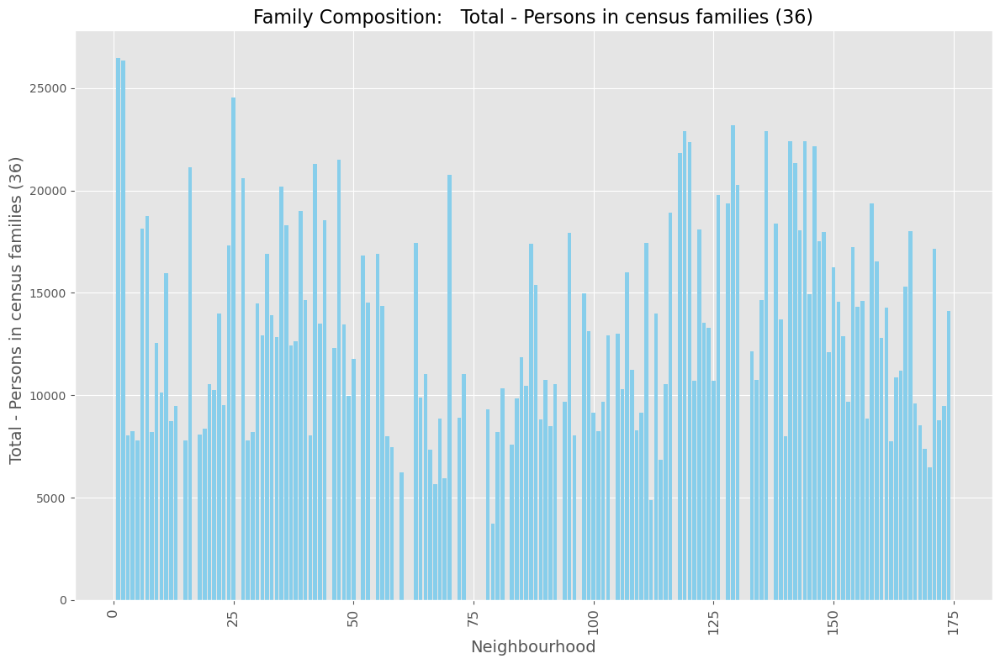

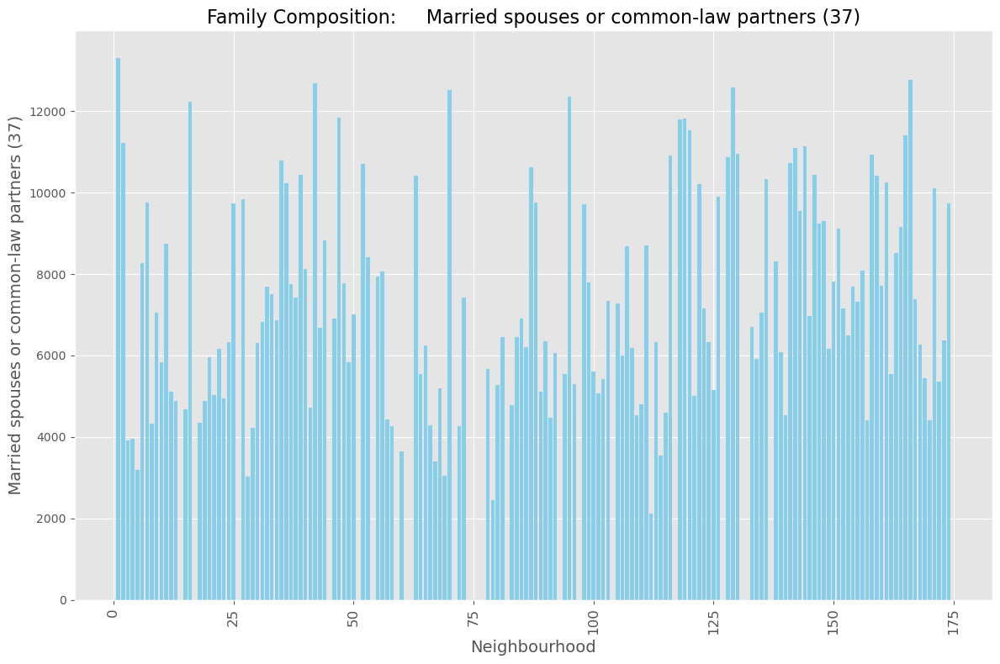

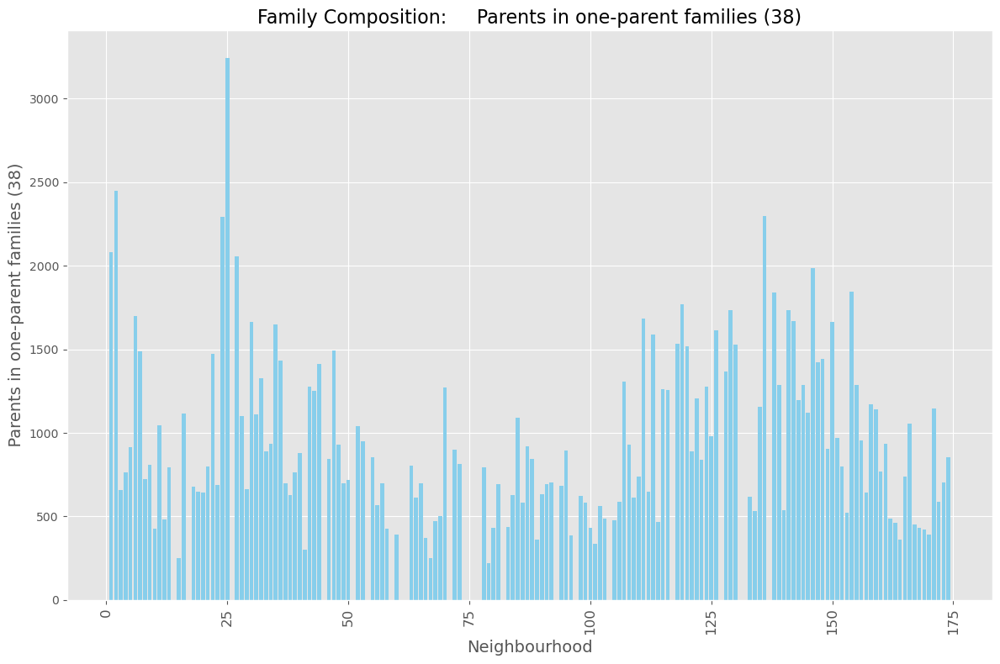

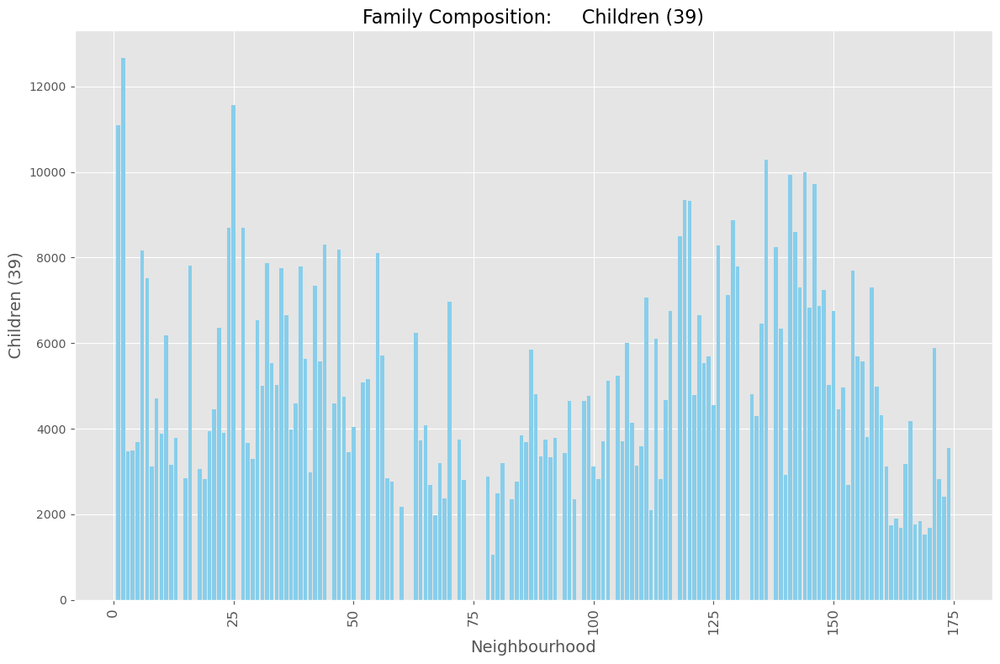

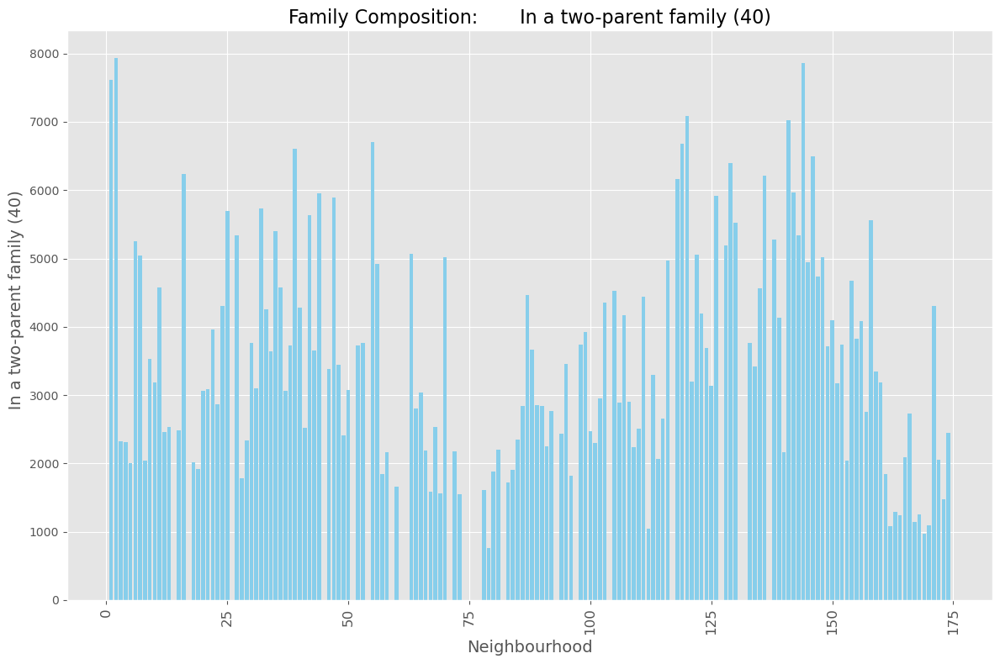

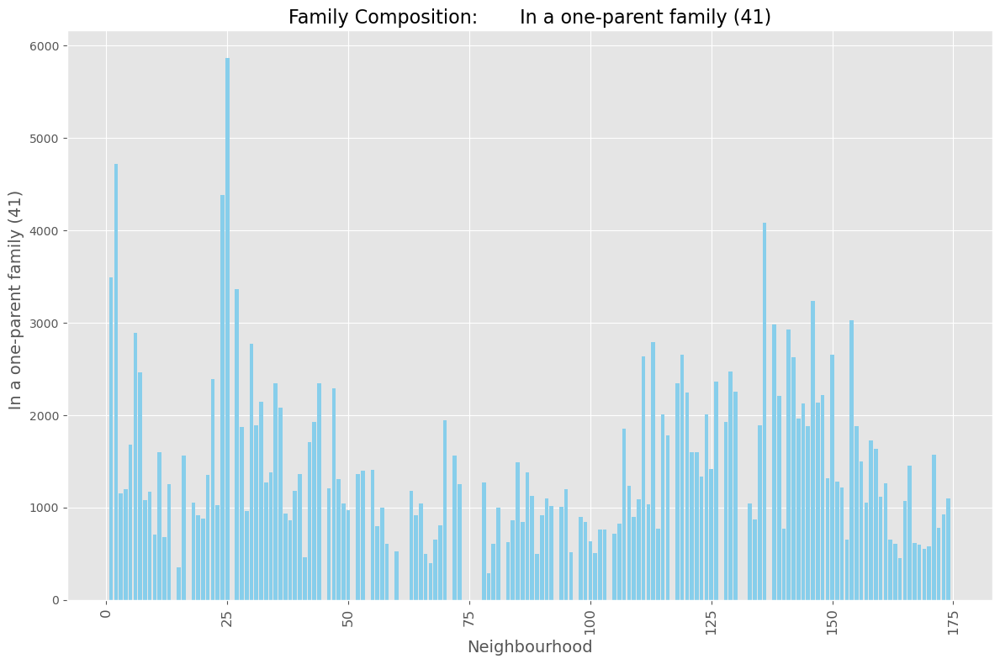

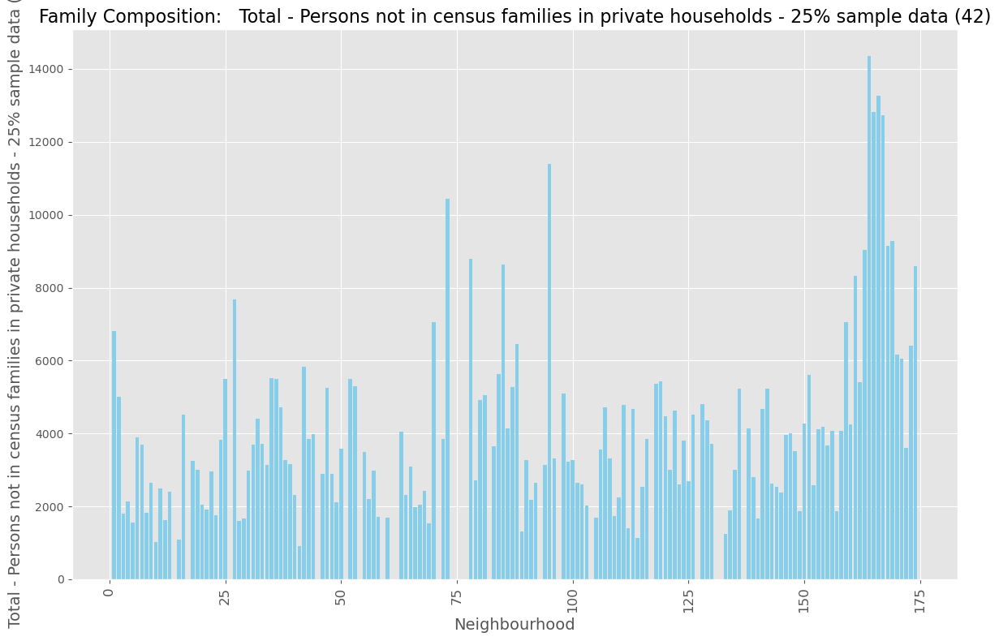

Plotting bar charts for group: Income


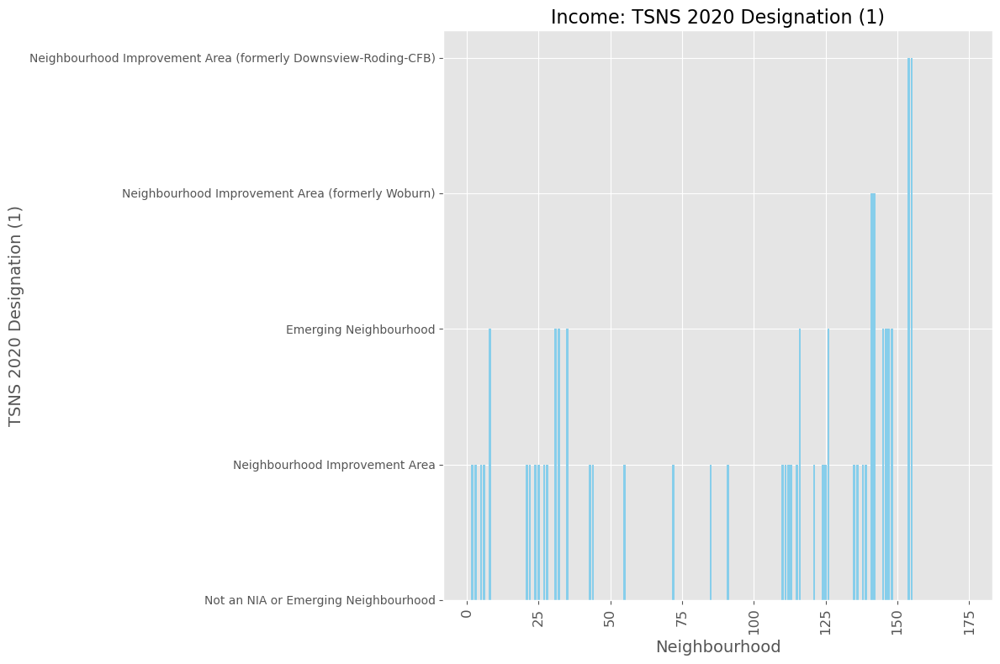

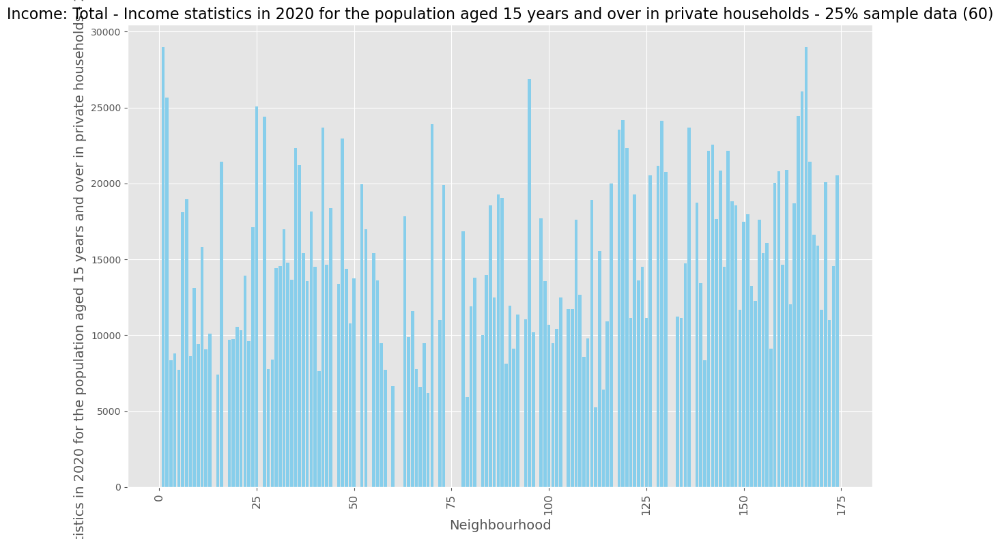

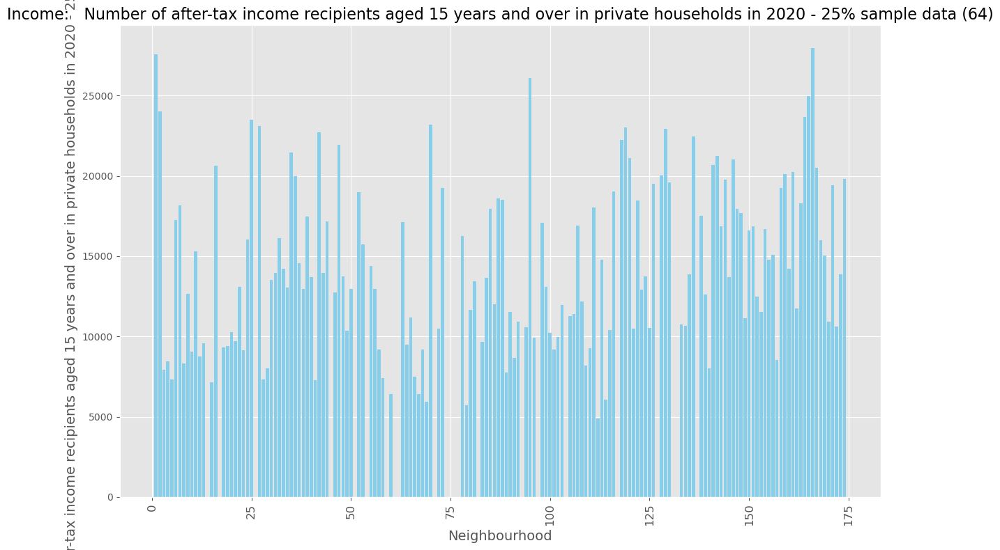

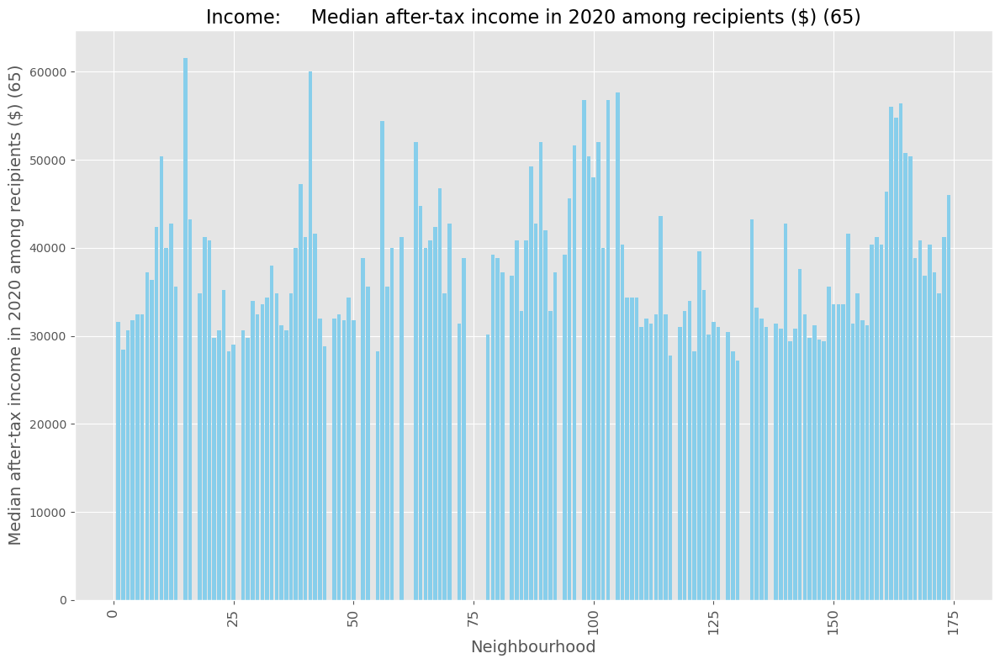

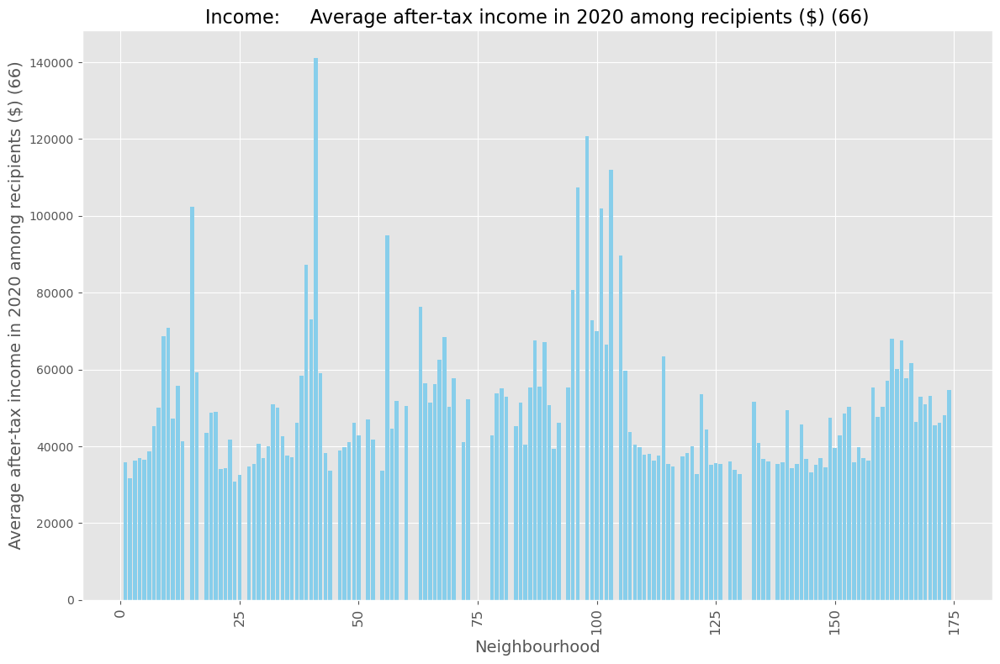

...

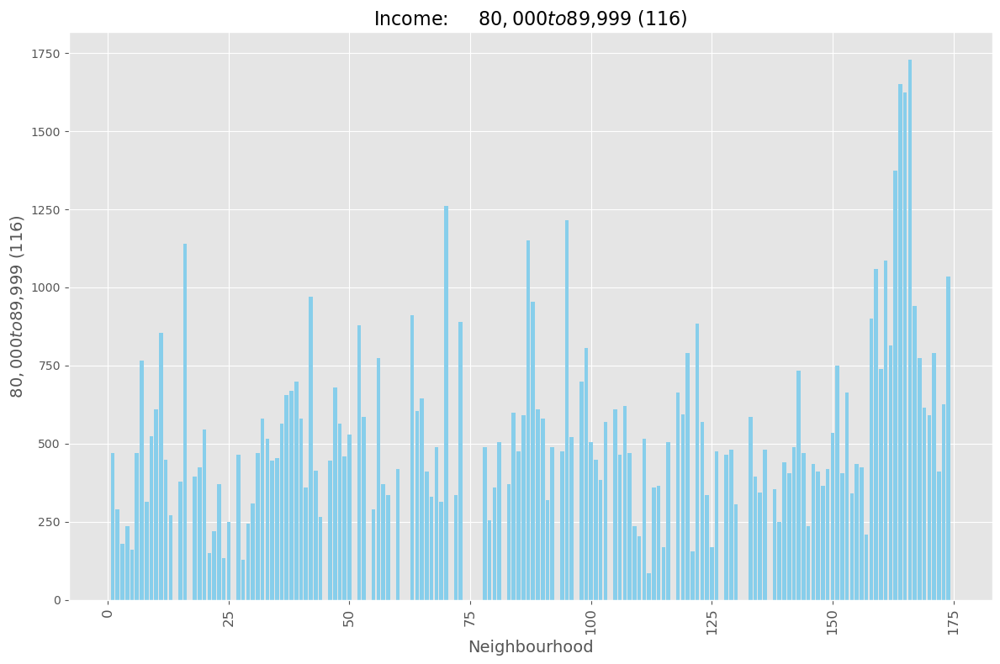

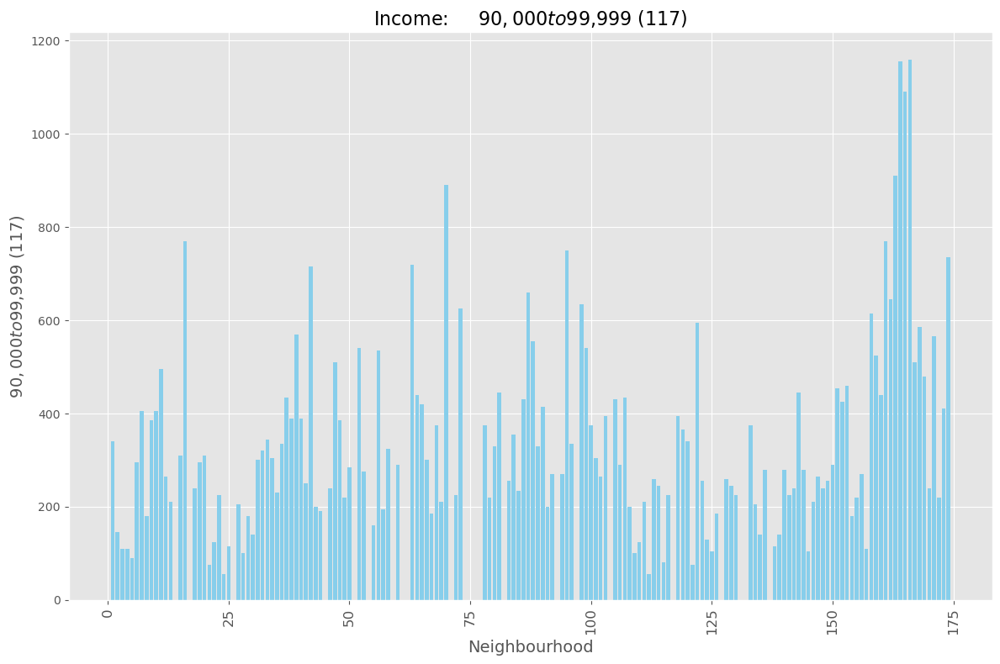

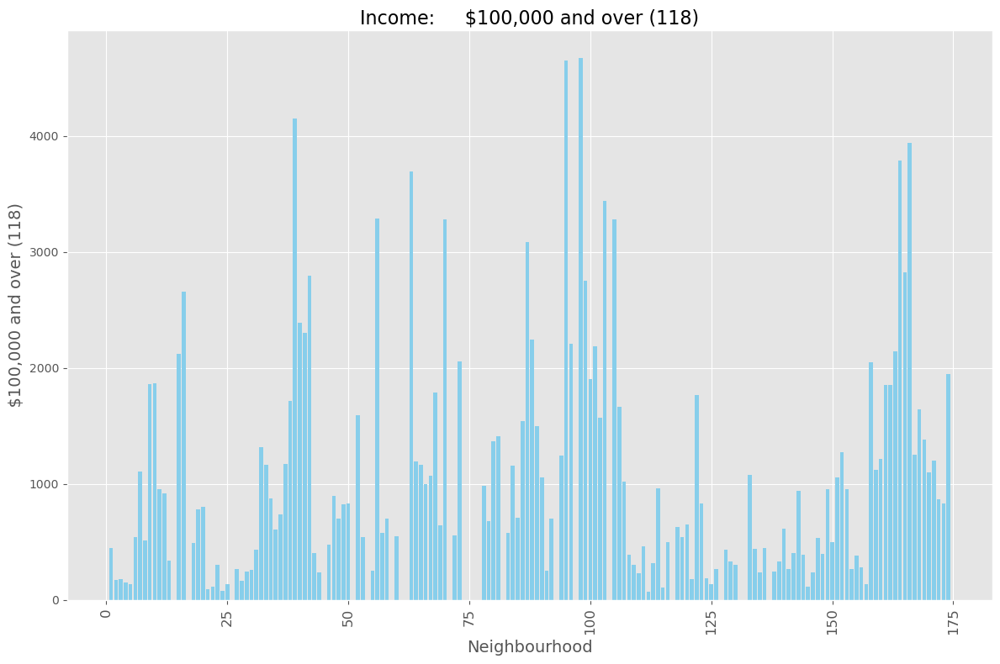

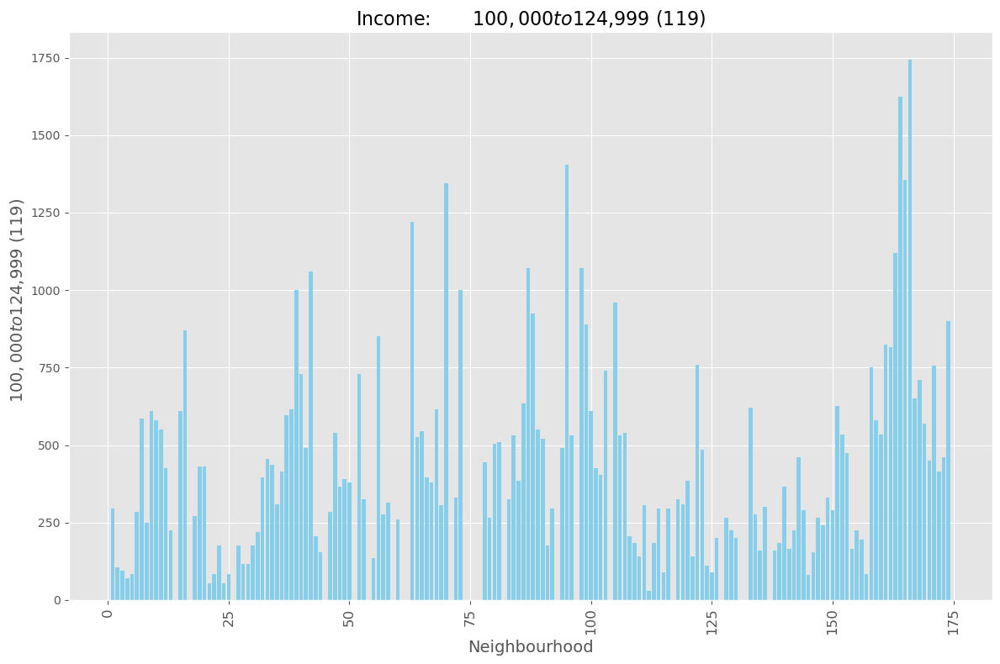

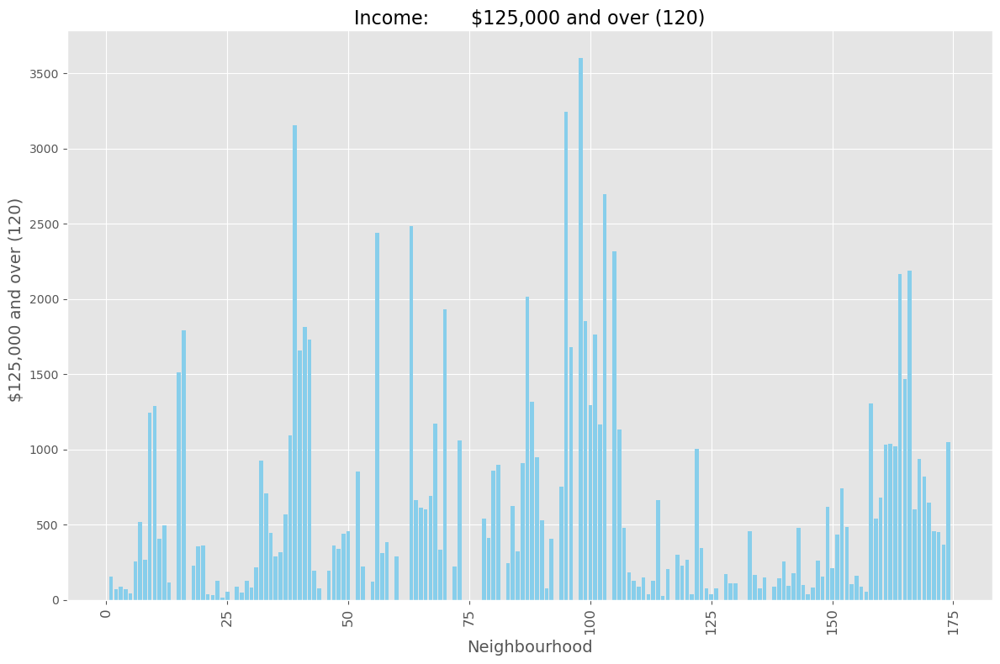

Plotting bar charts for group: Housing


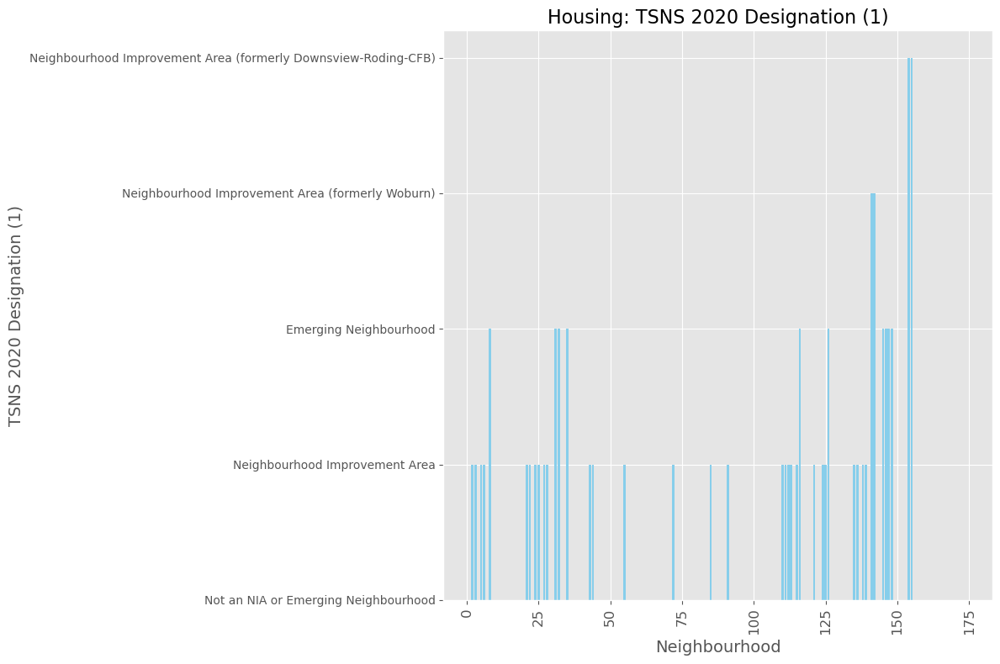

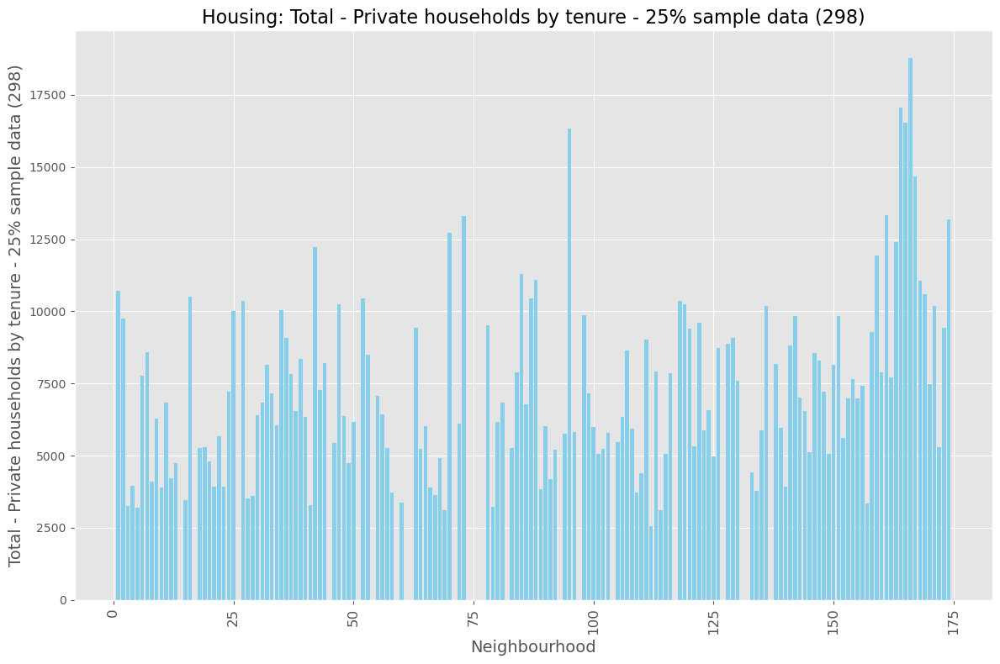

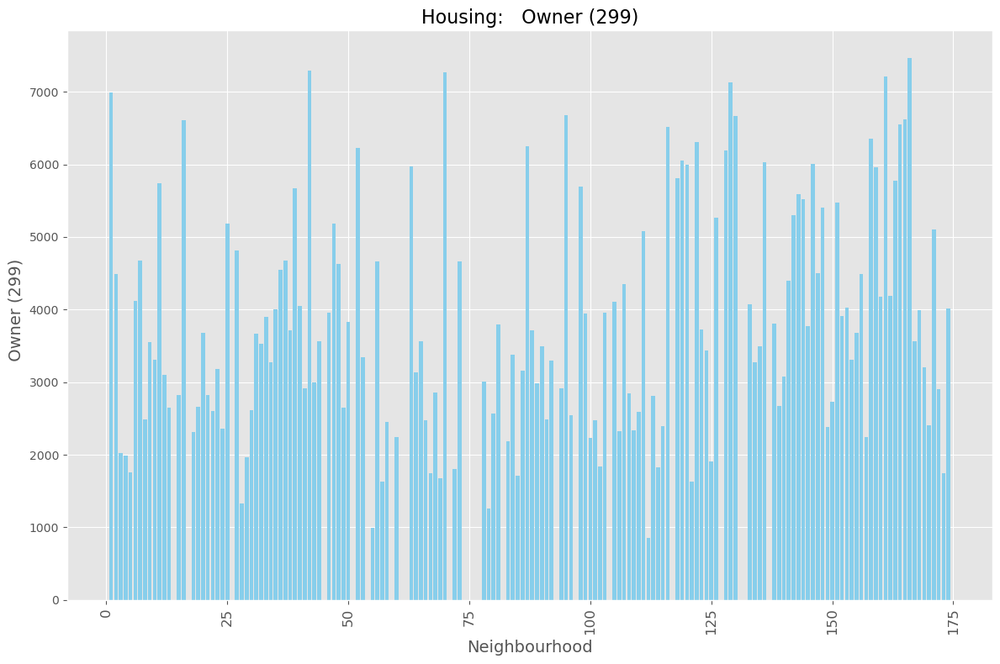

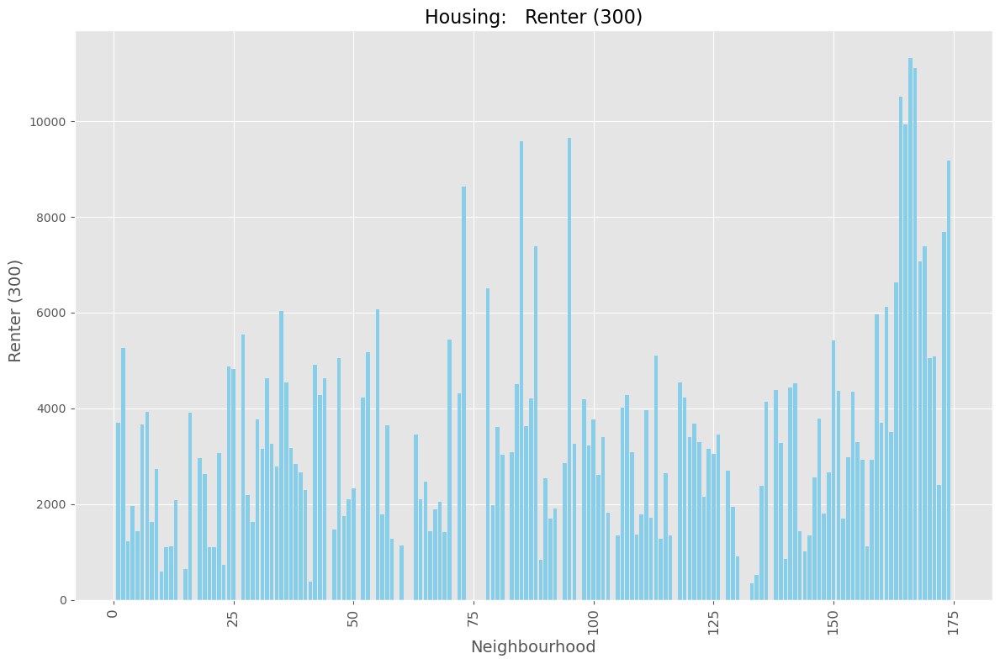

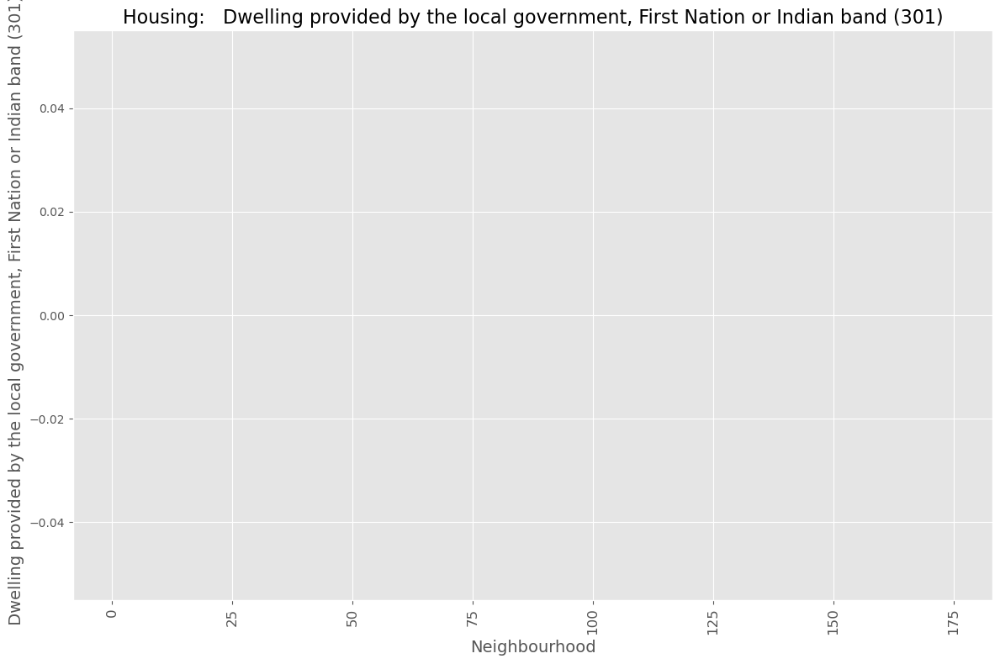

...

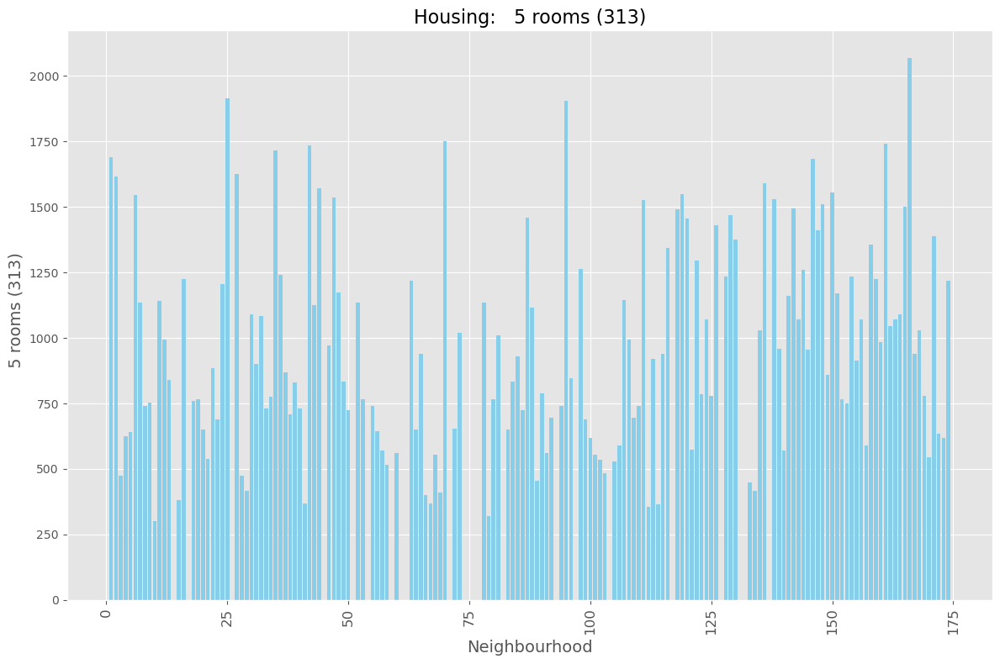

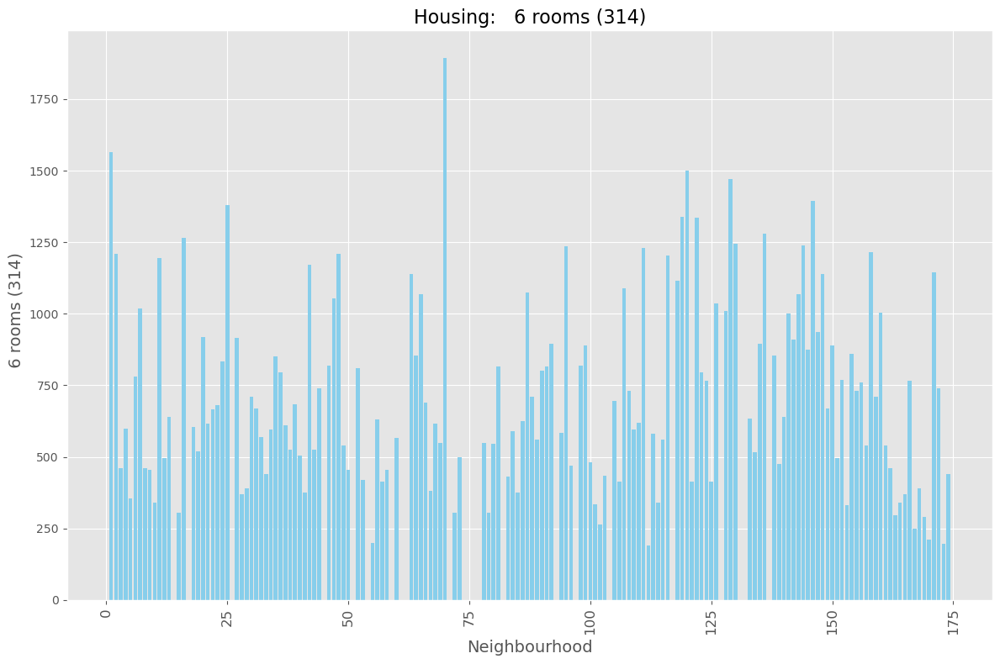

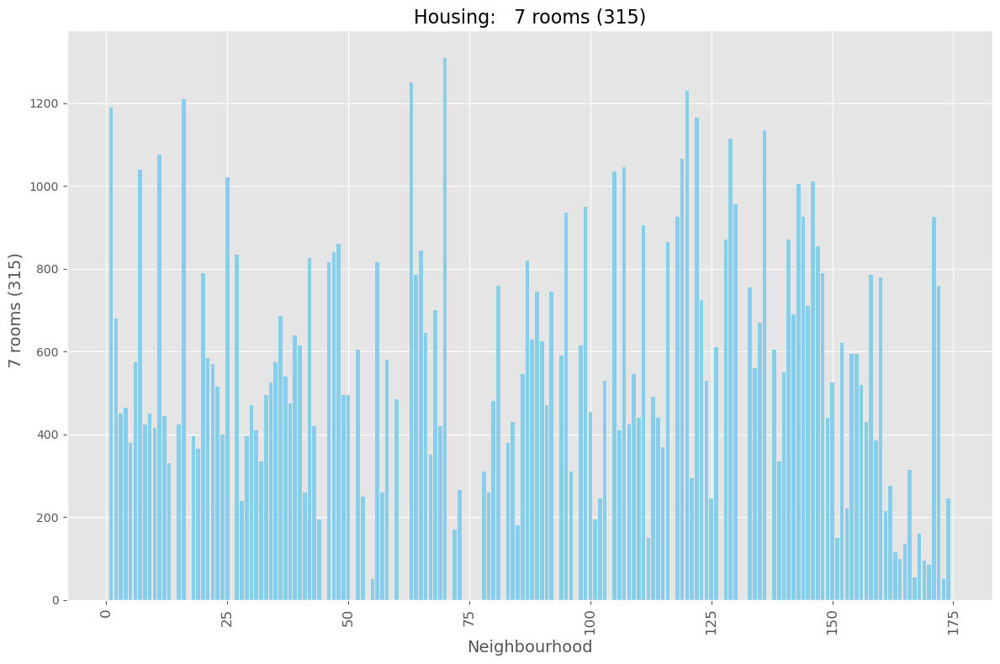

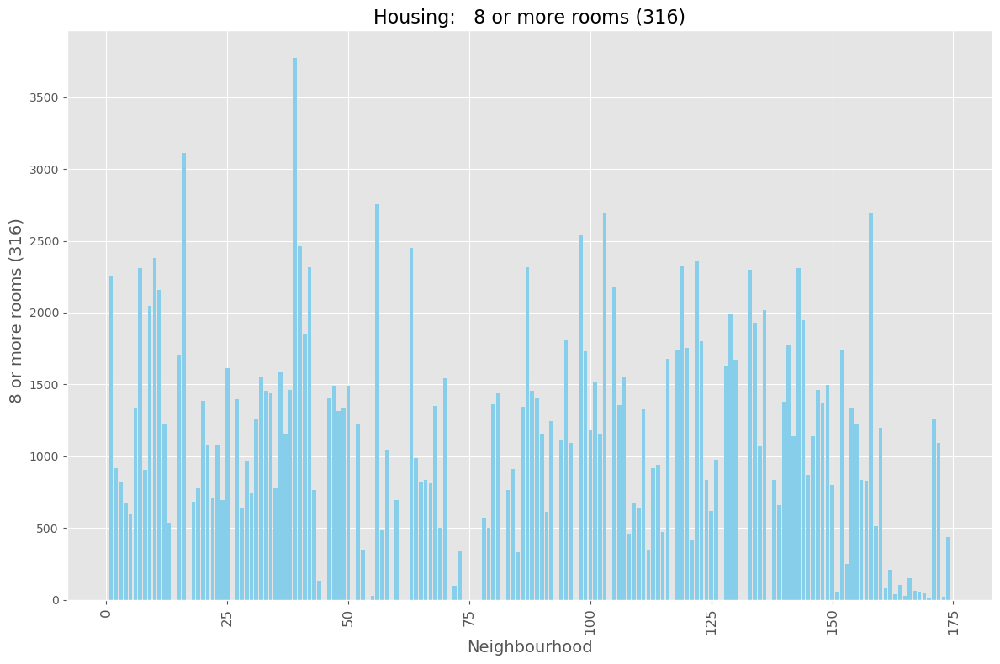

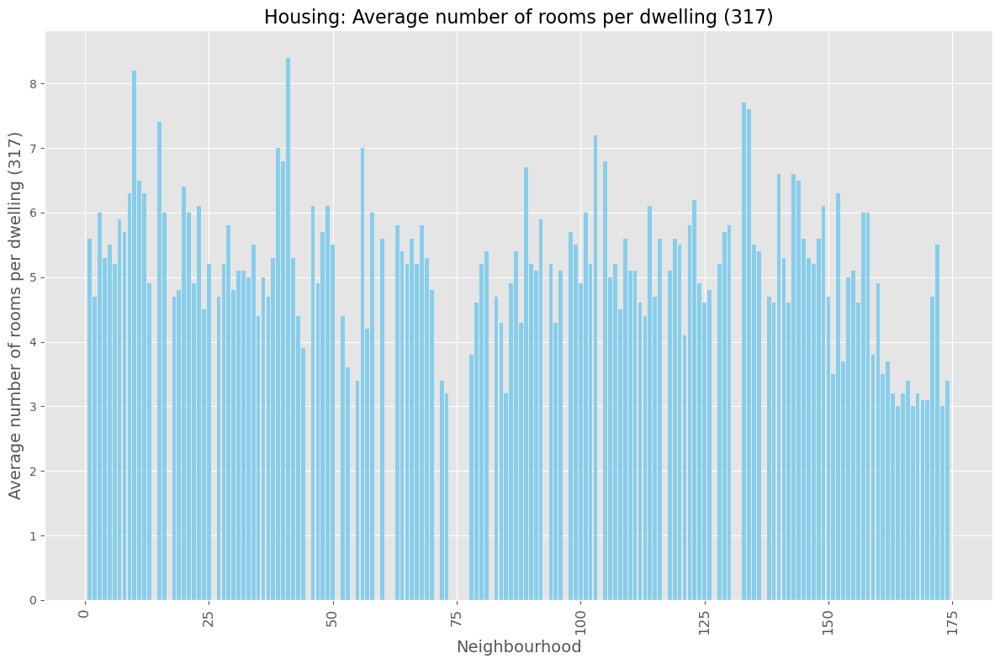

Plotting bar charts for group: Condition


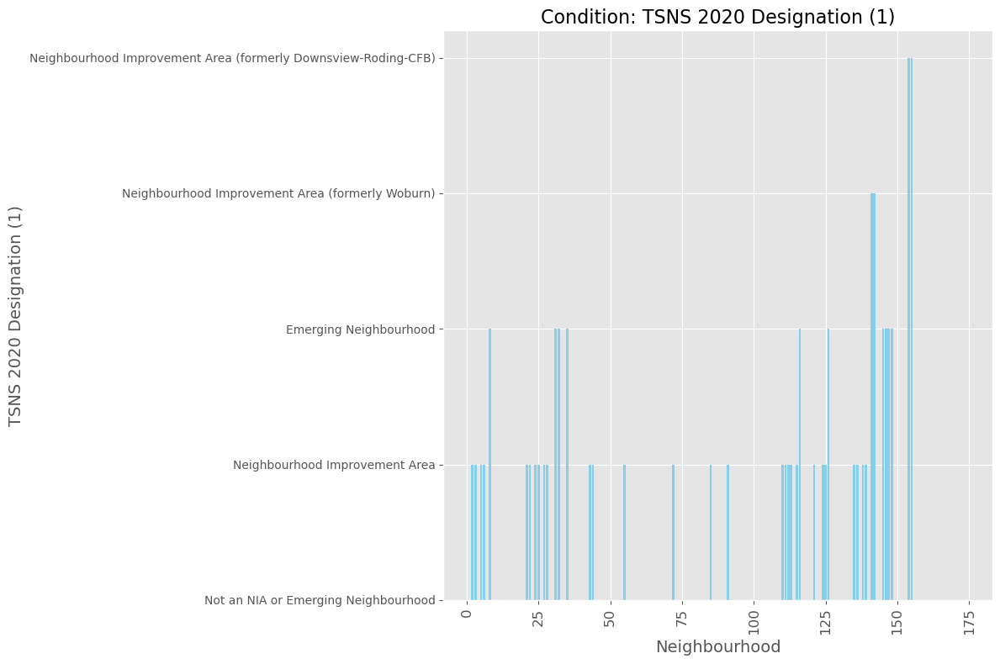

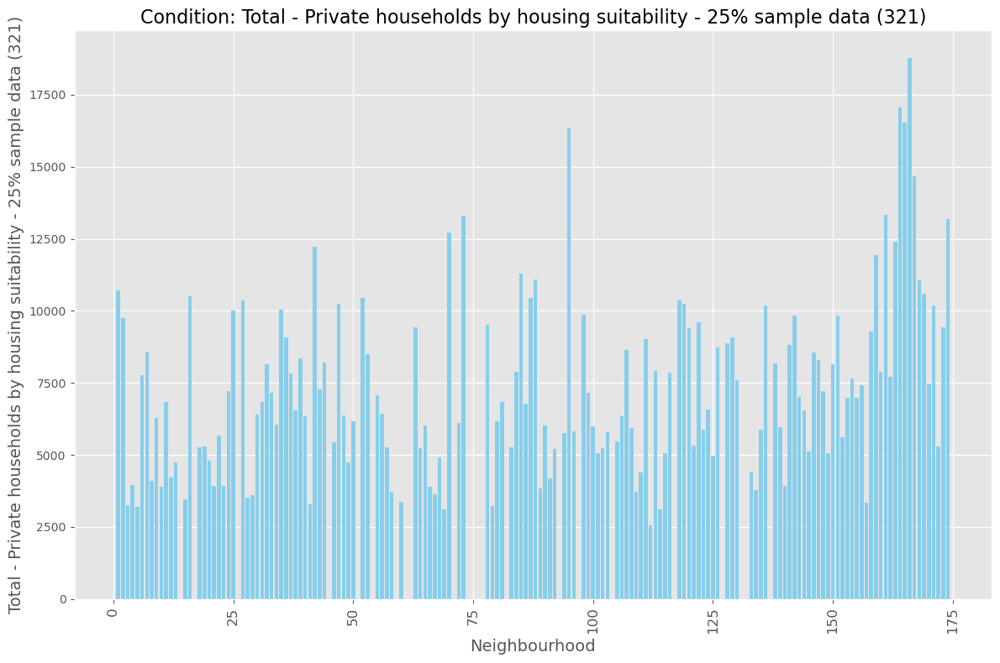

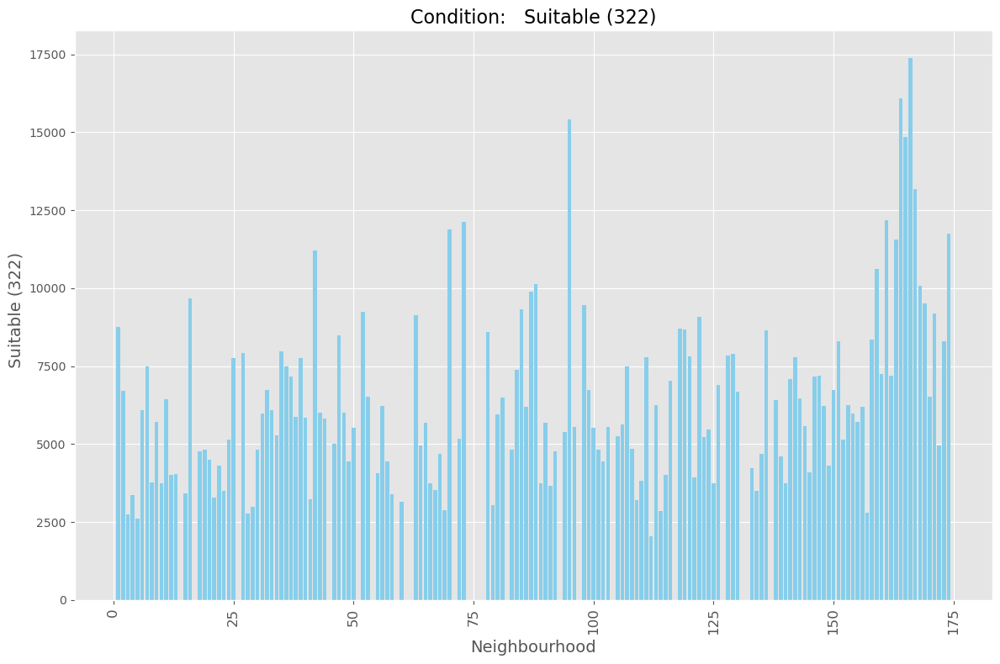

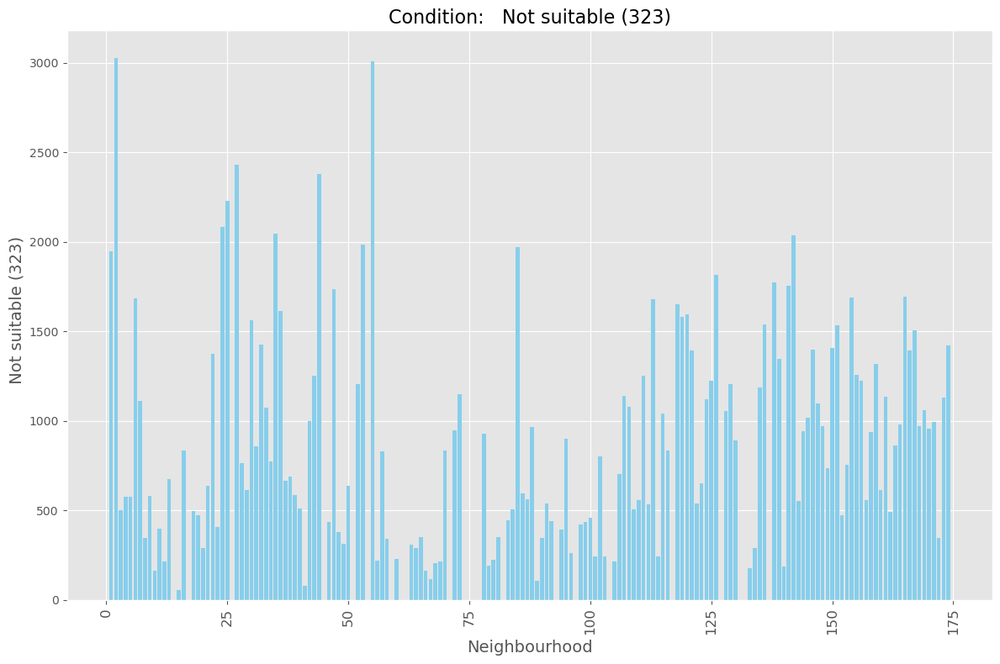

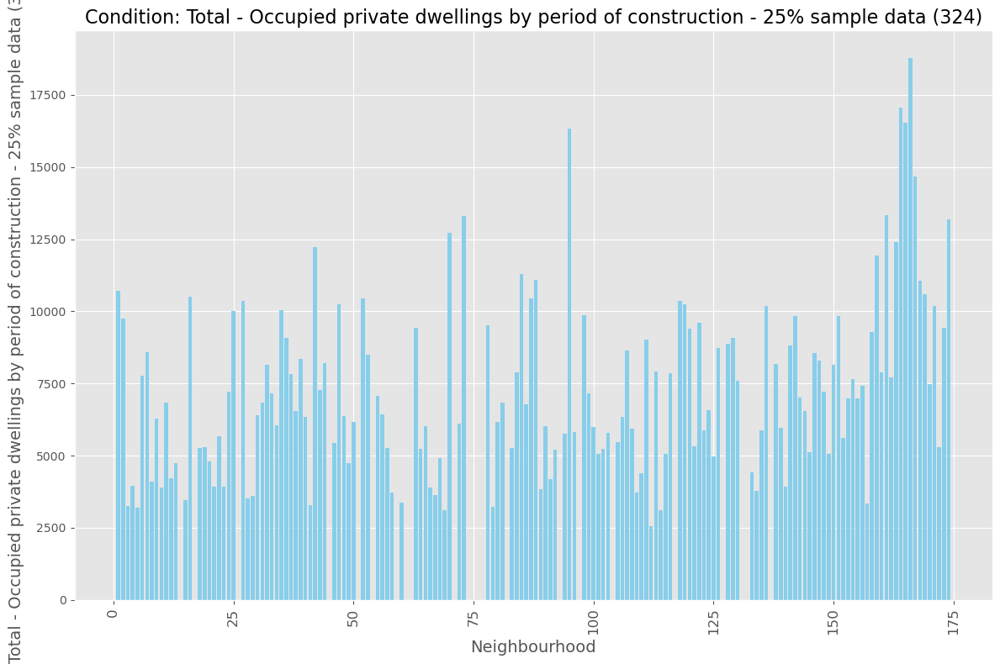

...

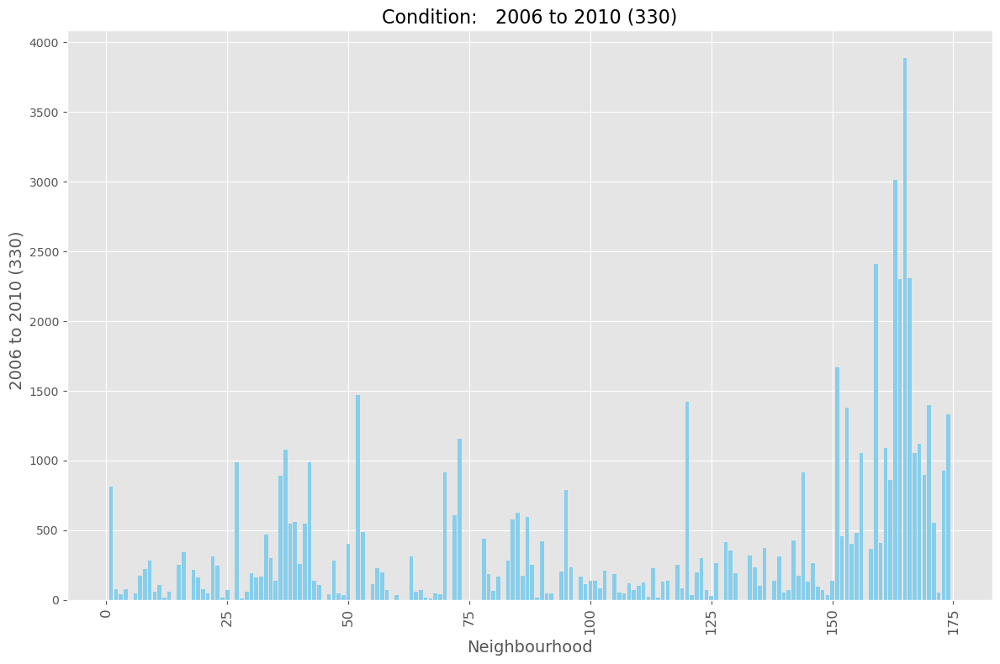

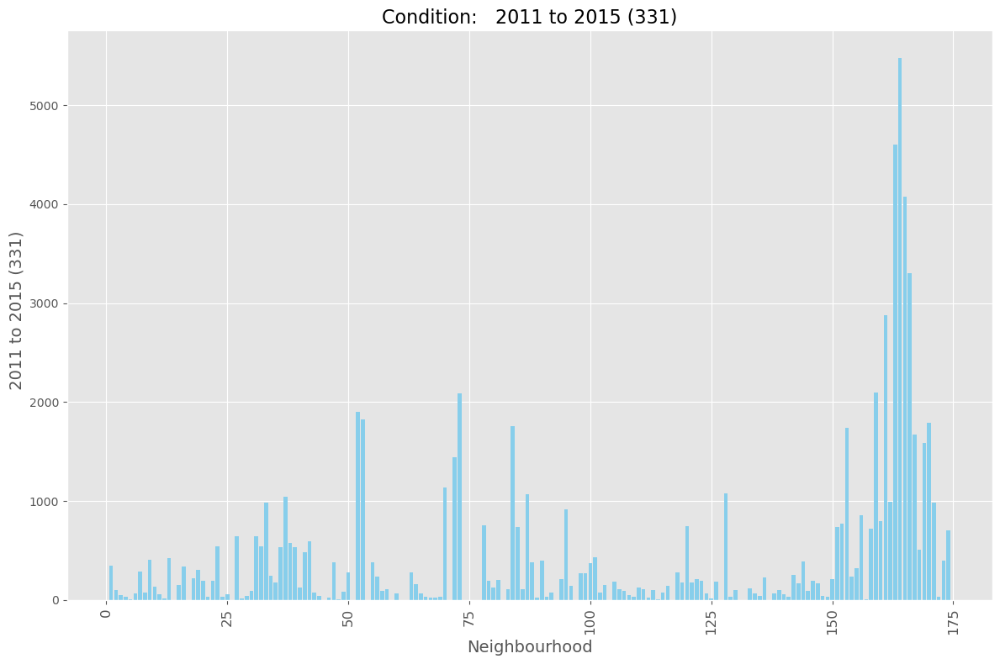

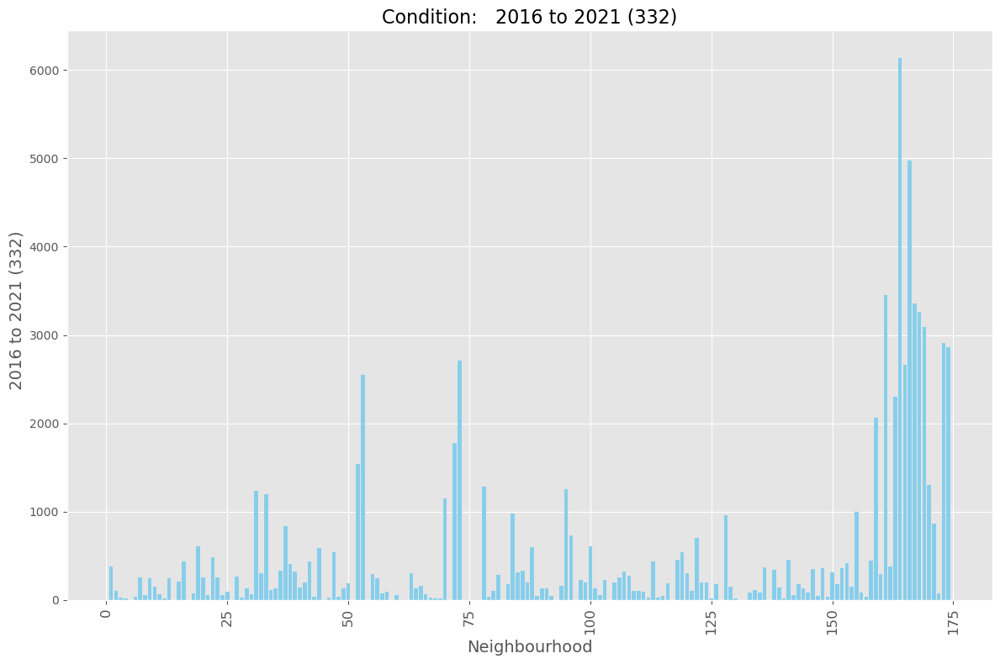

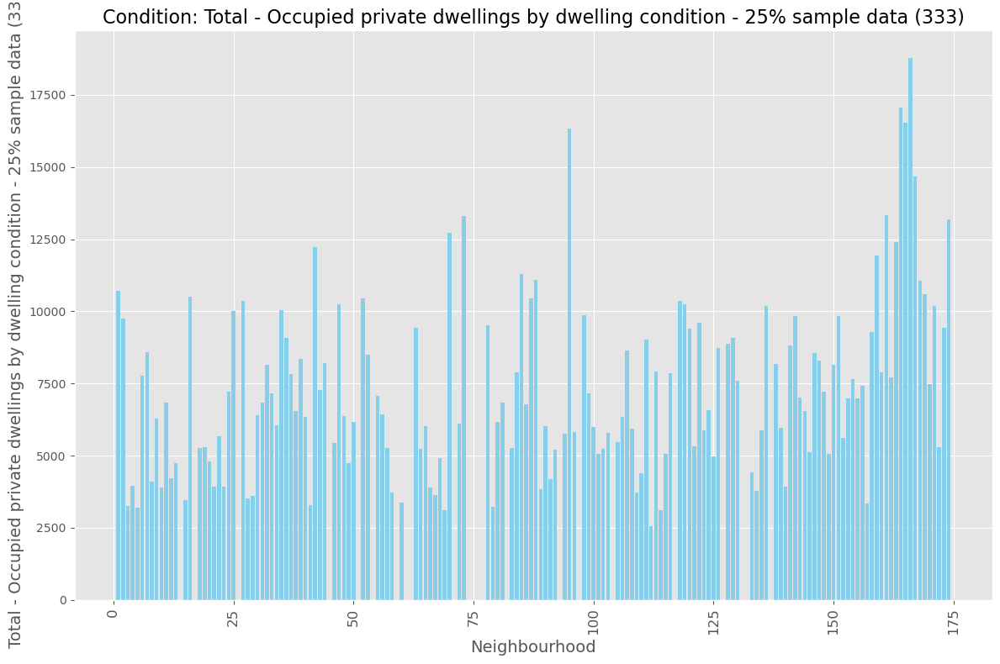

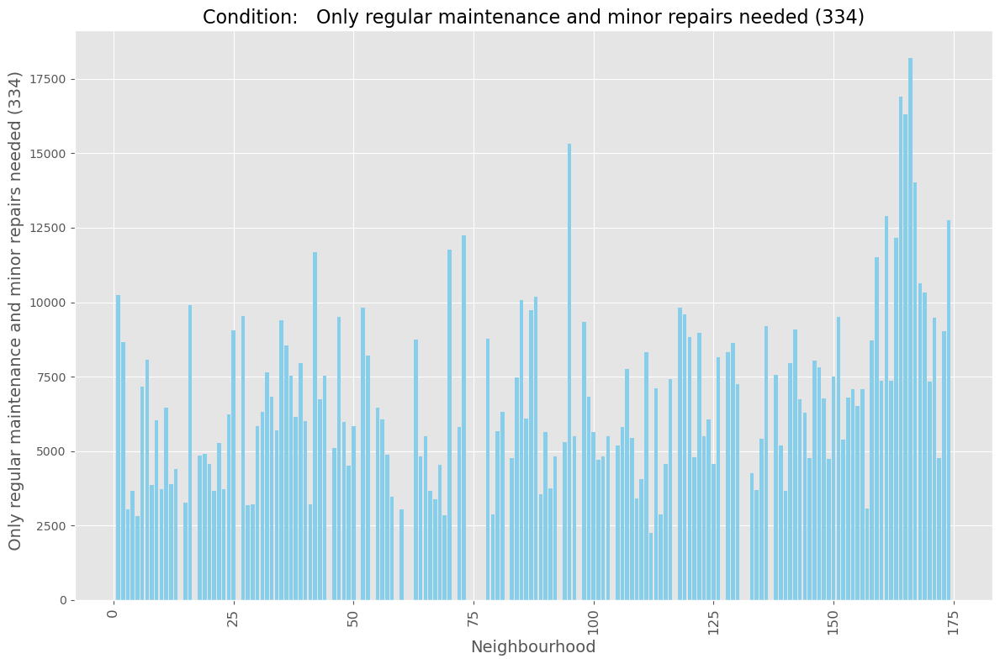

Plotting bar charts for group: Language


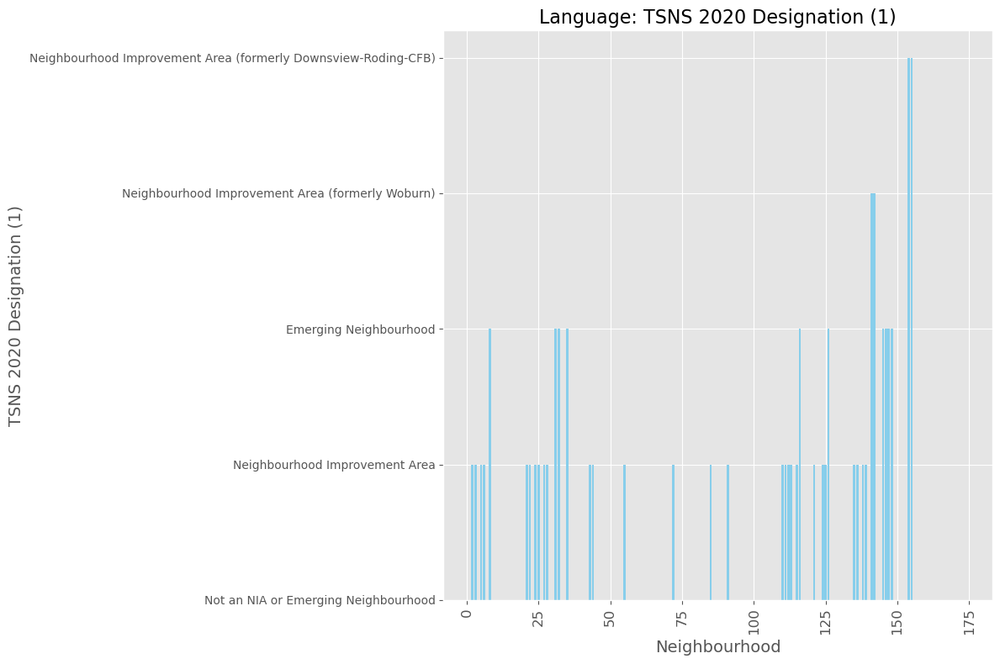

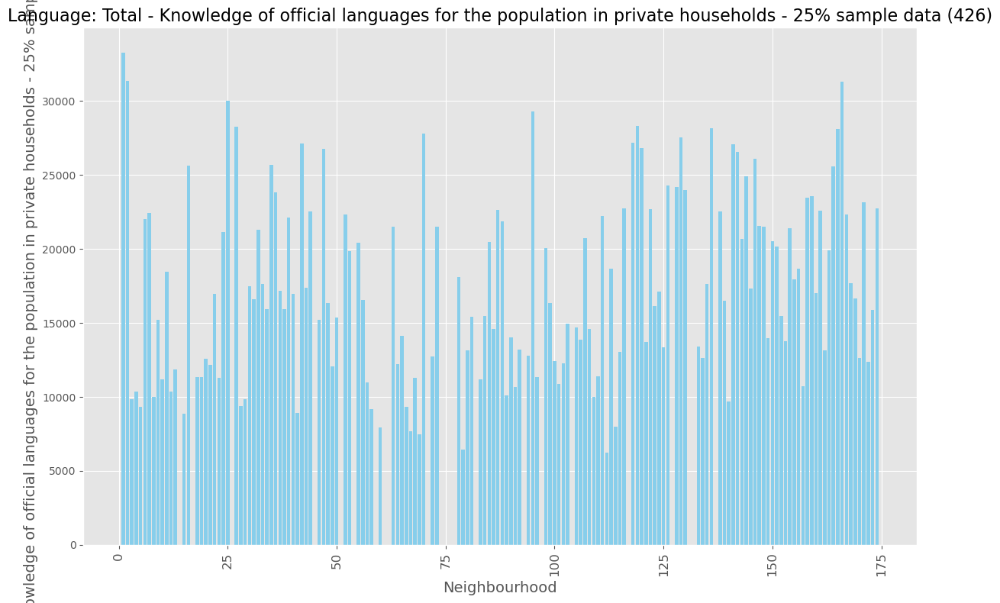

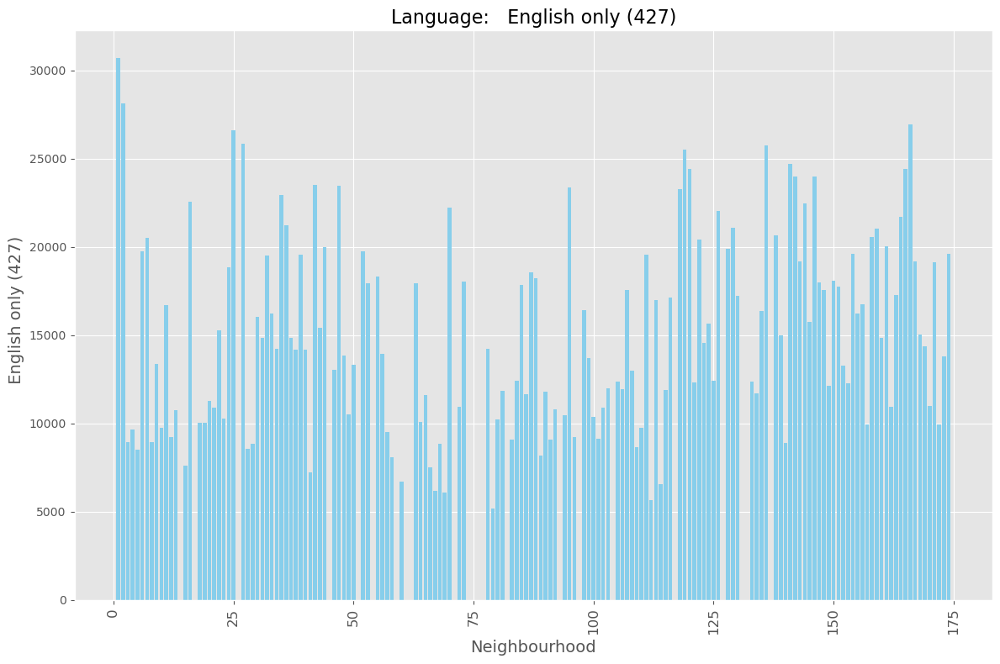

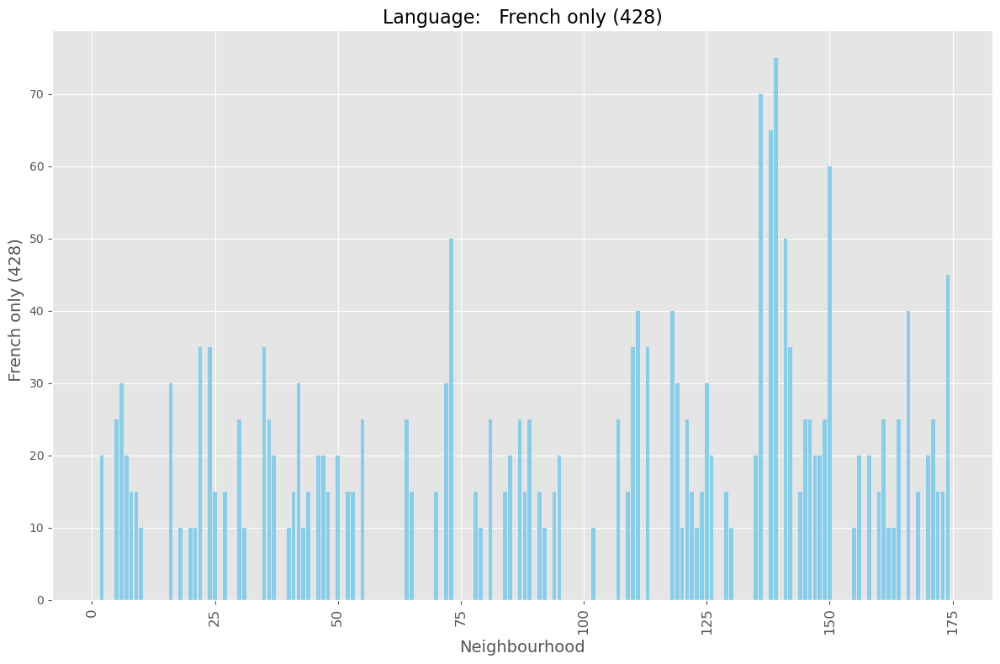

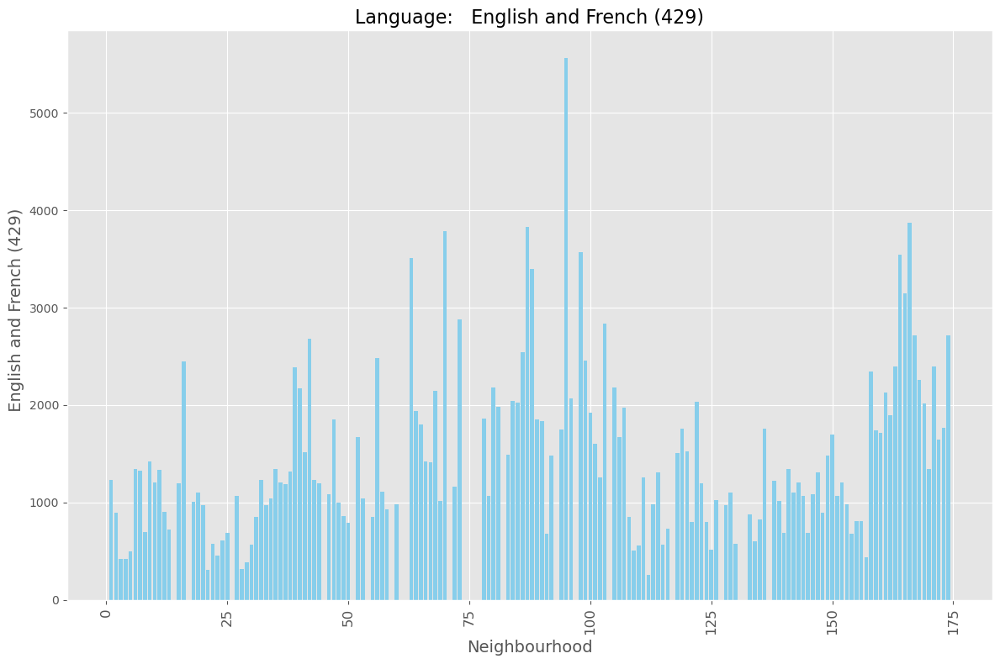

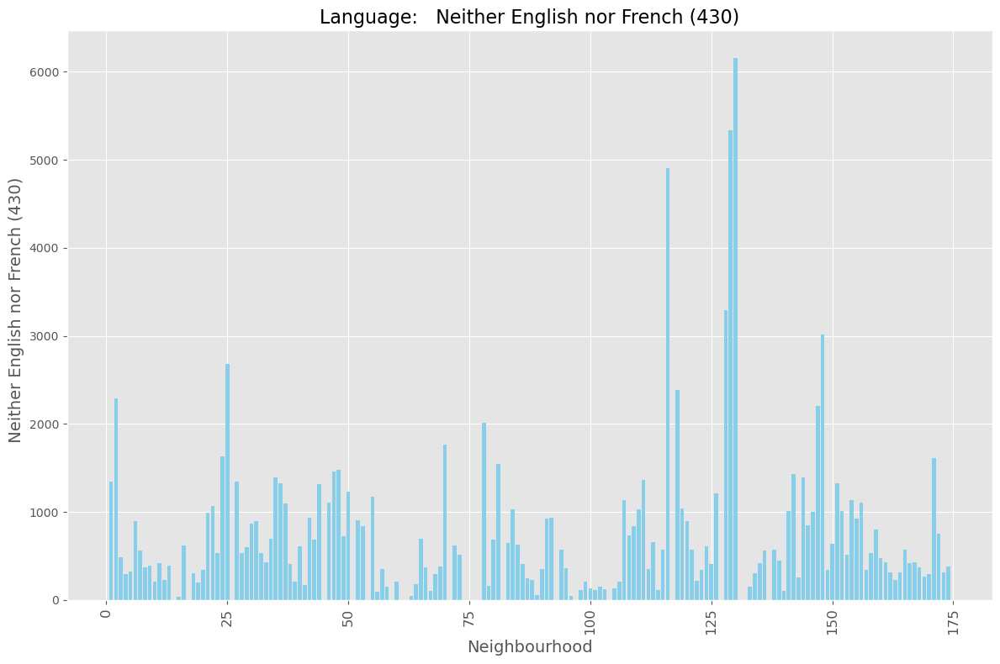

In [46]:
import matplotlib.pyplot as plt

# Function to plot bar charts for each column in a DataFrame
def plot_grouped_data(dataframes, group_name):
    # Get the DataFrame for the specified group
    df = dataframes[group_name]
    neighborhood_column = 'Neighbourhood Number (0)'  # Adjust if necessary

    # Iterate over all columns except for the neighborhood identifier and geometry
    for column in df.columns:
        if column != neighborhood_column and column != 'geometry (2603)':
            plt.figure(figsize=(12, 8))
            plt.bar(df[neighborhood_column], df[column], color='skyblue')
            plt.title(f"{group_name}: {column}", fontsize=16)
            plt.xlabel('Neighbourhood', fontsize=14)
            plt.ylabel(column, fontsize=14)
            plt.xticks(rotation=90, fontsize=12)
            plt.tight_layout()
            plt.show()

# Iterate through each group and plot
for group_name in grouped_columns.keys():
    print(f"Plotting bar charts for group: {group_name}")
    plot_grouped_data(dataframes, group_name)


Creating choropleth map for group: Demographics


<Figure size 1200x800 with 0 Axes>

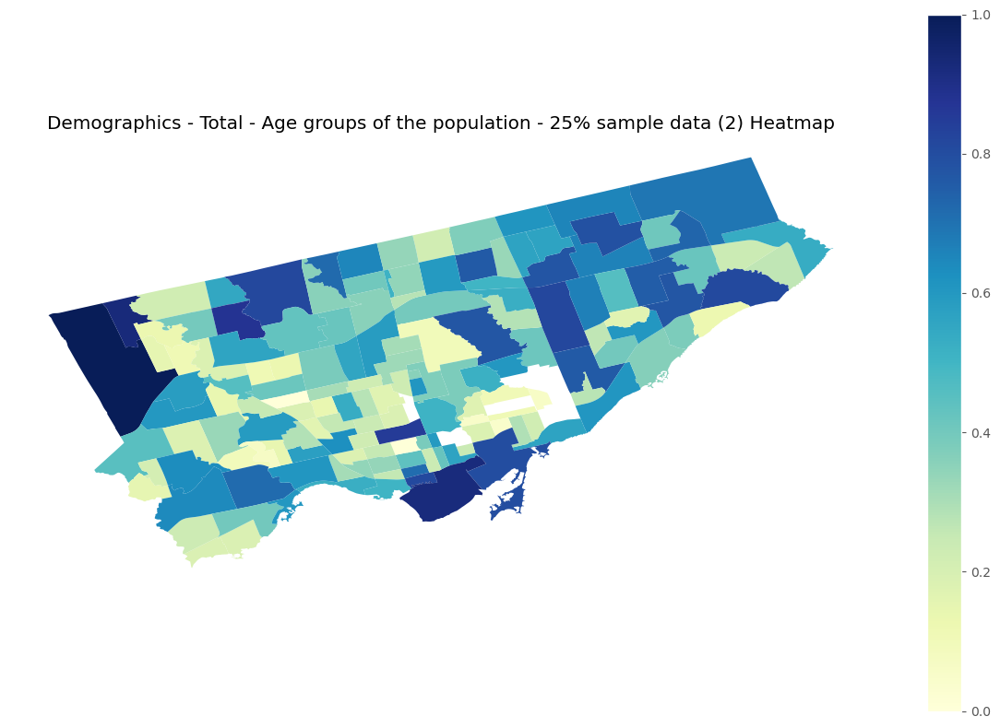

<Figure size 1200x800 with 0 Axes>

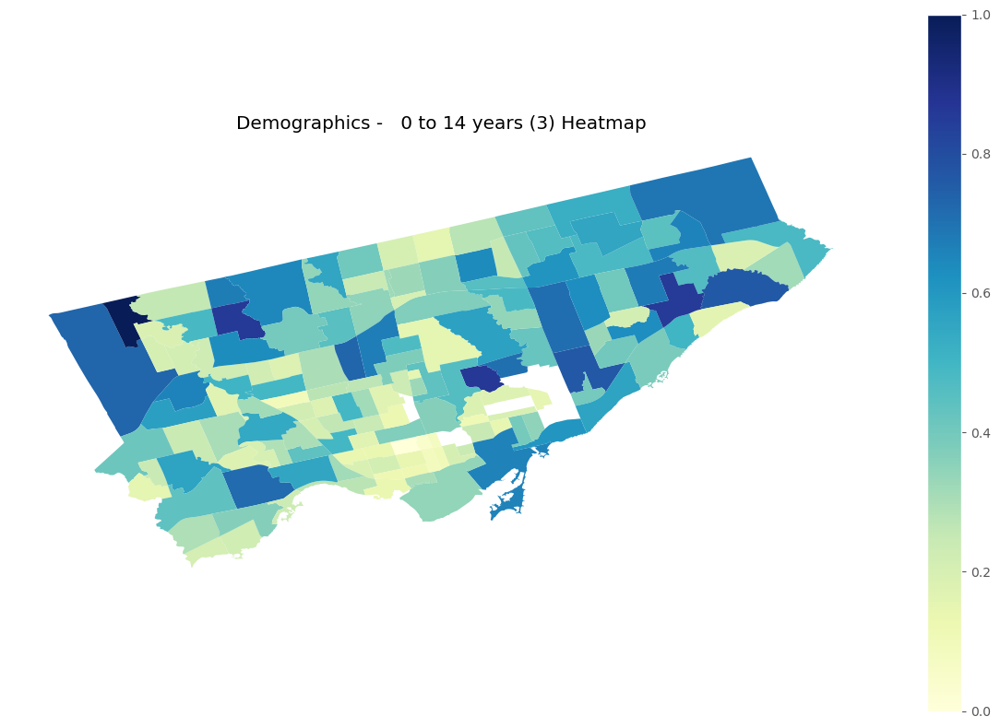

<Figure size 1200x800 with 0 Axes>

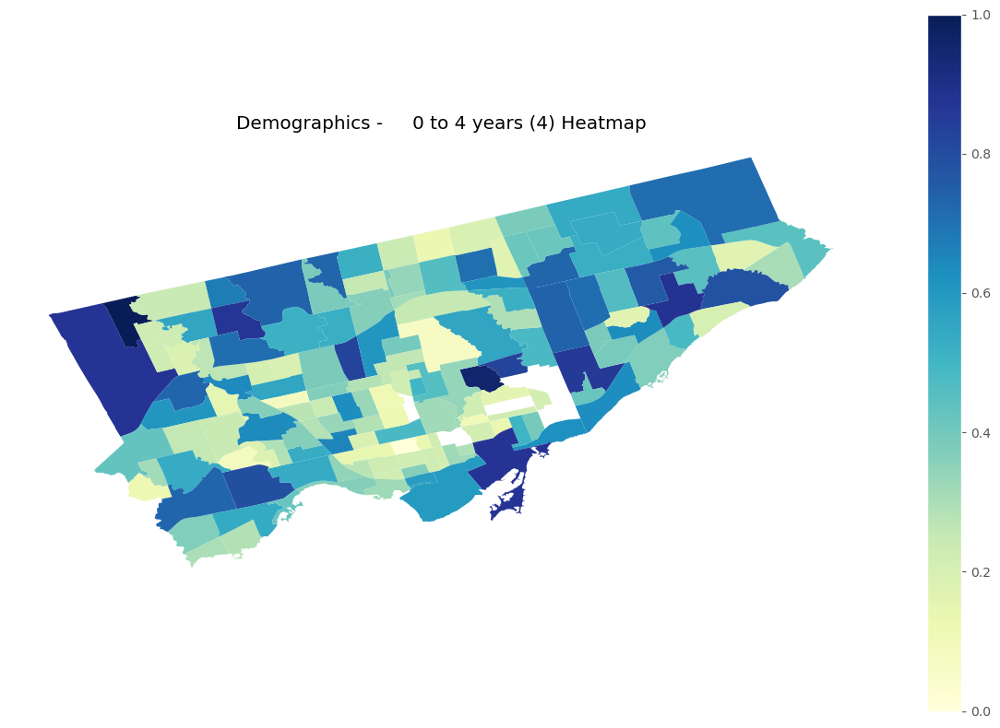

<Figure size 1200x800 with 0 Axes>

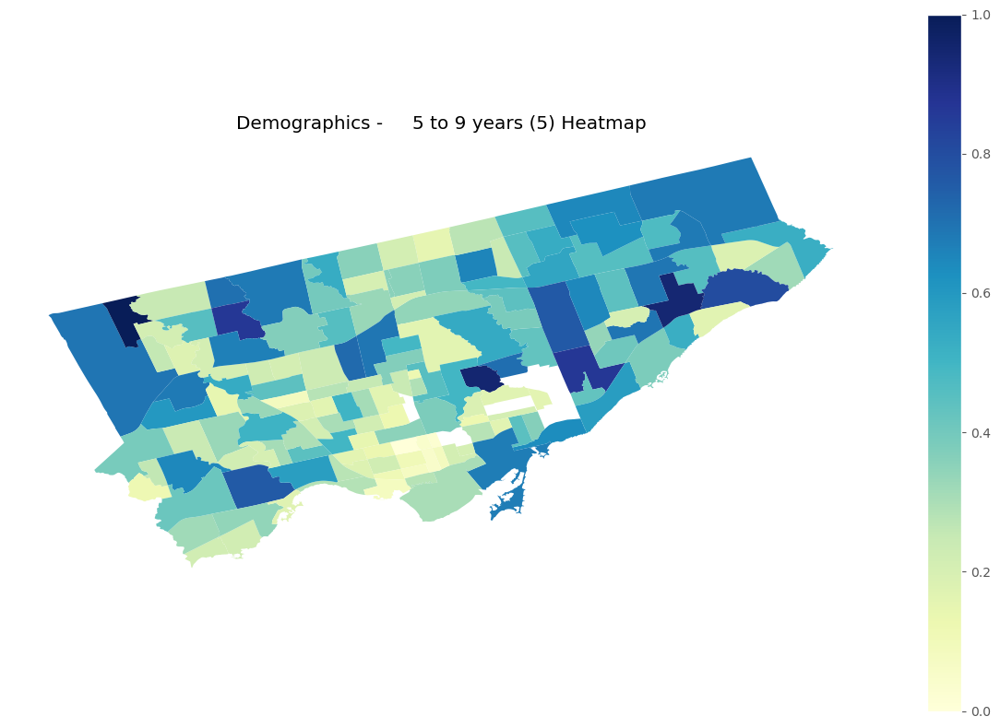

<Figure size 1200x800 with 0 Axes>

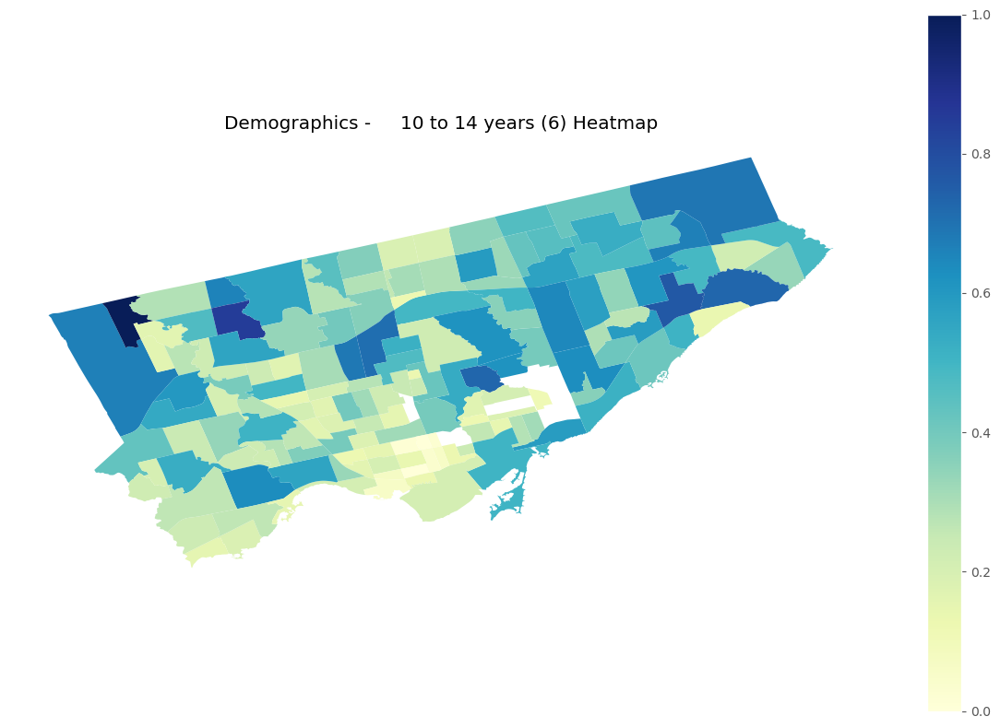

<Figure size 1200x800 with 0 Axes>

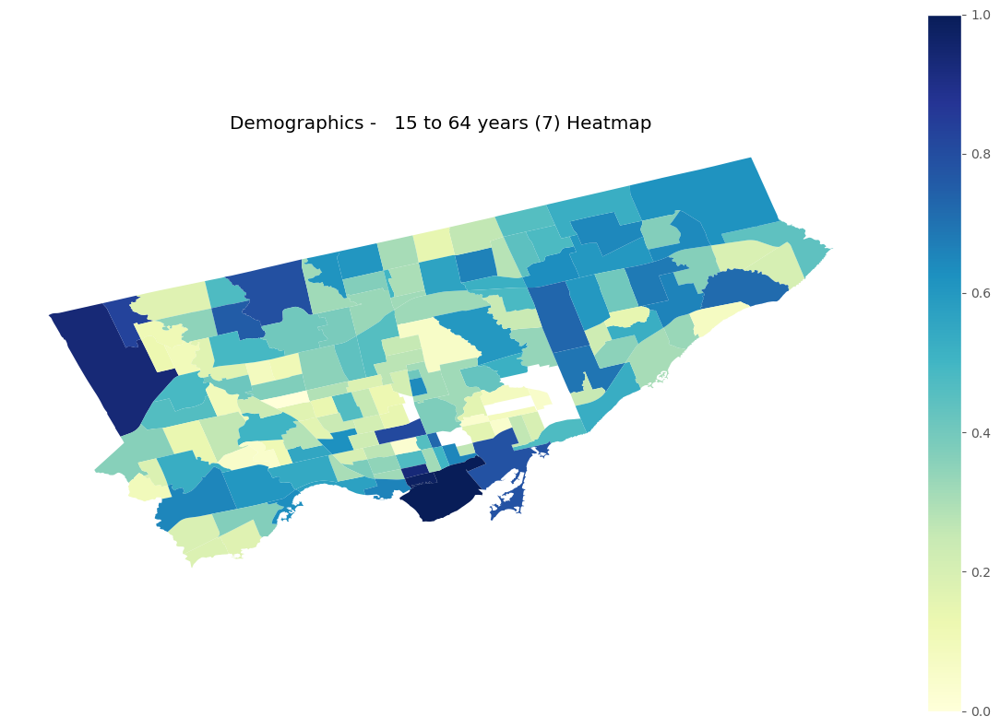

<Figure size 1200x800 with 0 Axes>

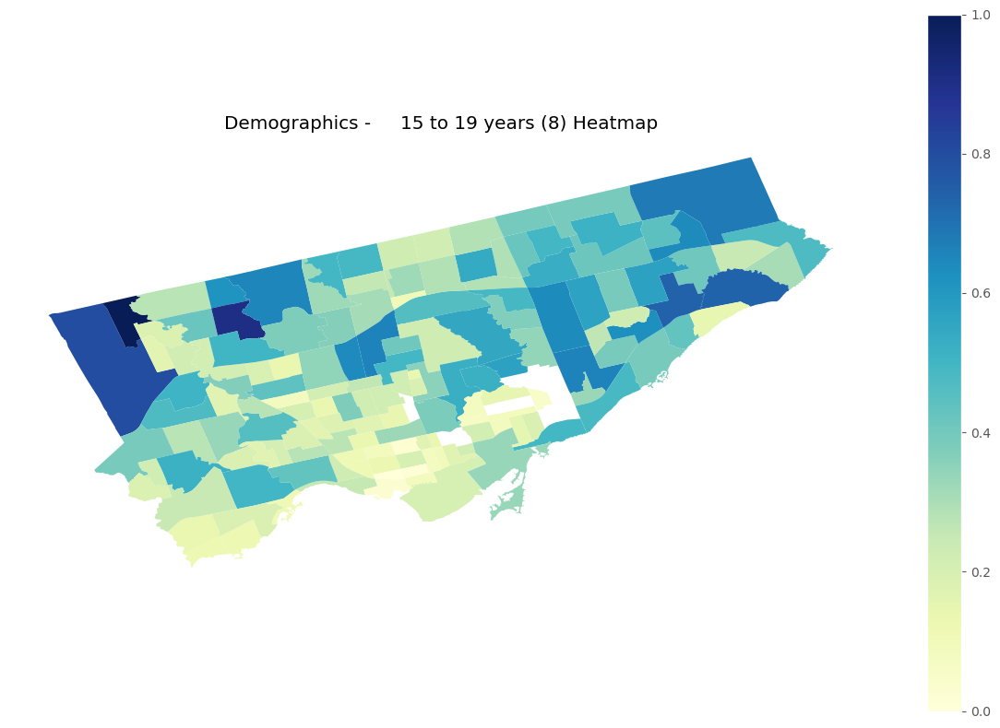

<Figure size 1200x800 with 0 Axes>

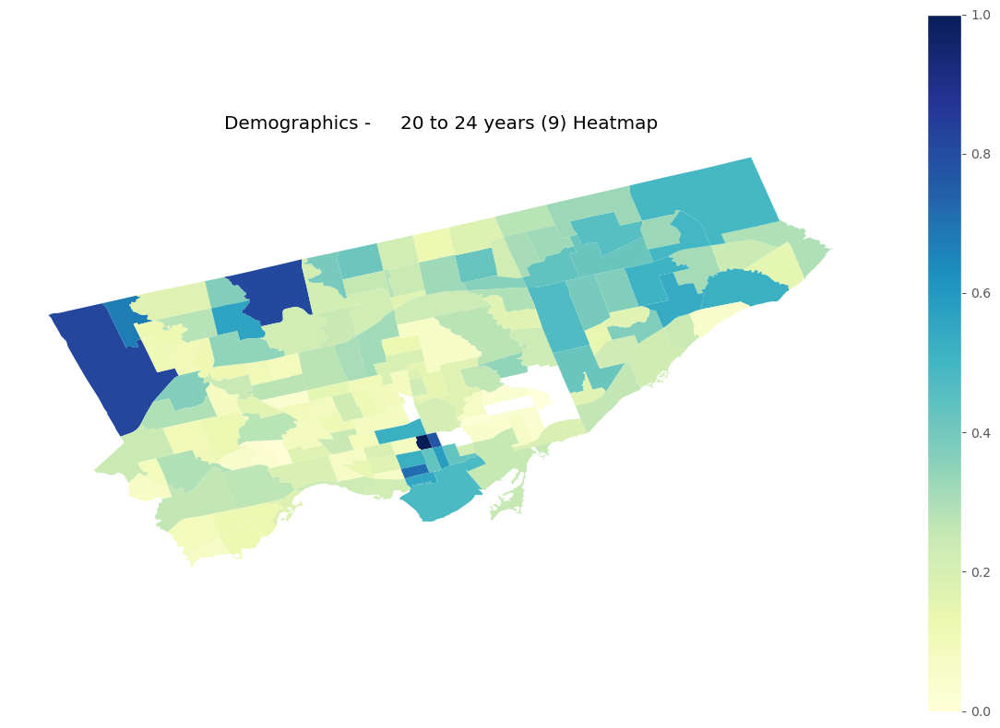

<Figure size 1200x800 with 0 Axes>

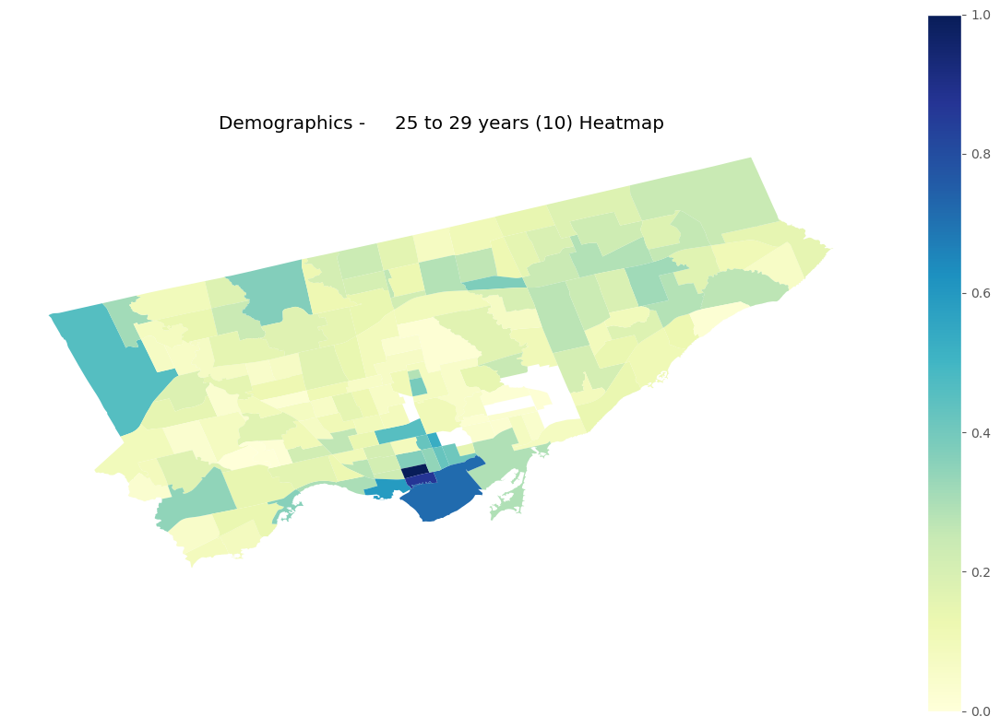

<Figure size 1200x800 with 0 Axes>

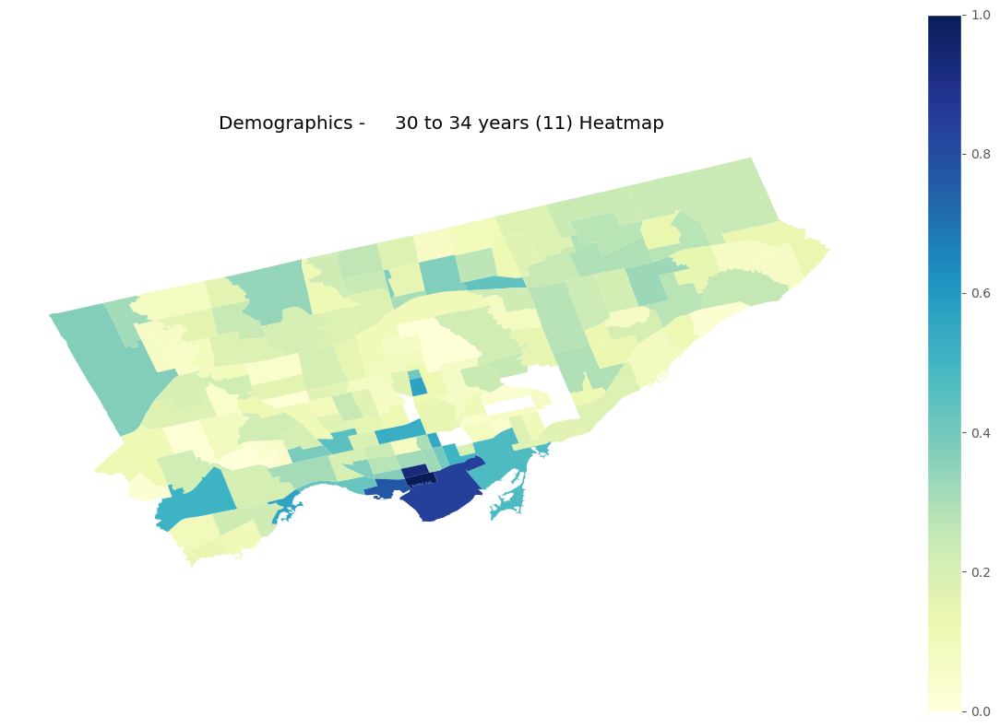

<Figure size 1200x800 with 0 Axes>

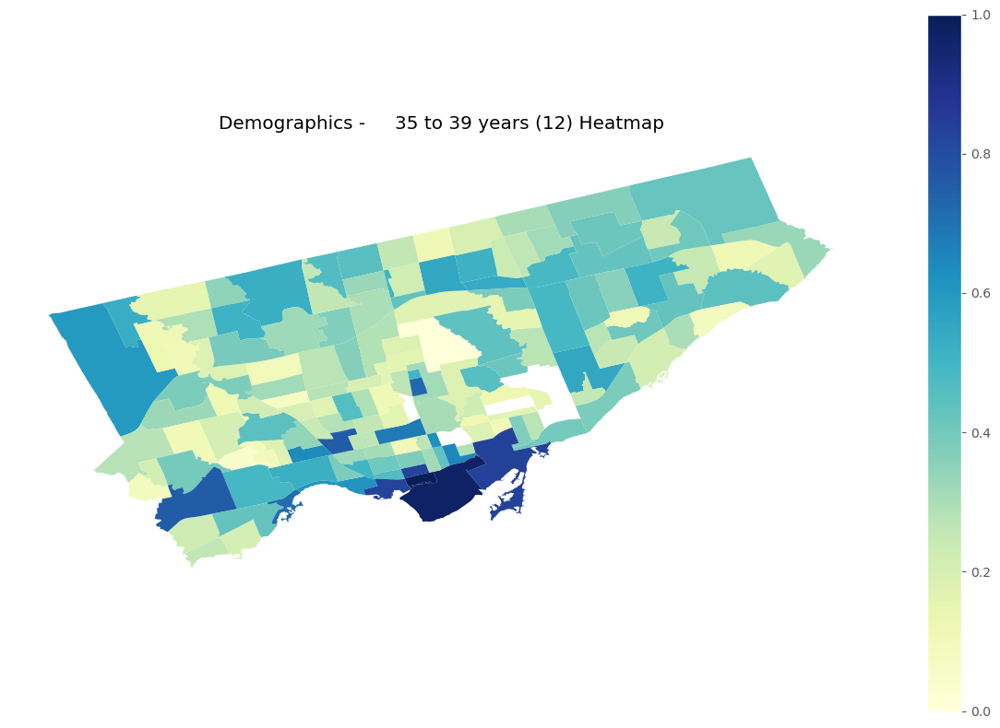

<Figure size 1200x800 with 0 Axes>

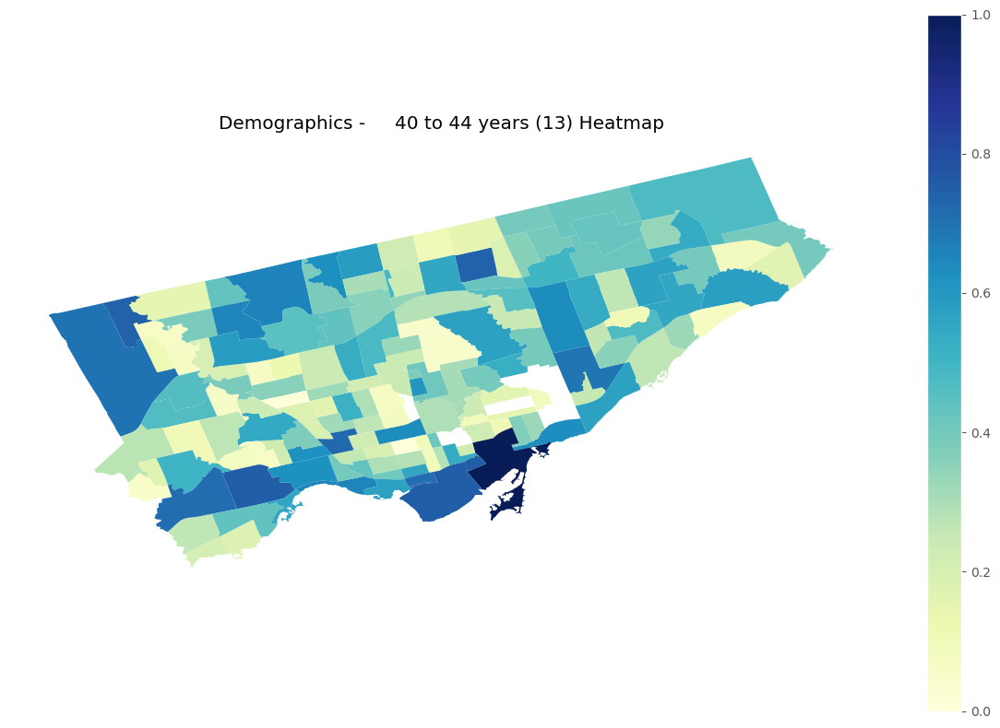

<Figure size 1200x800 with 0 Axes>

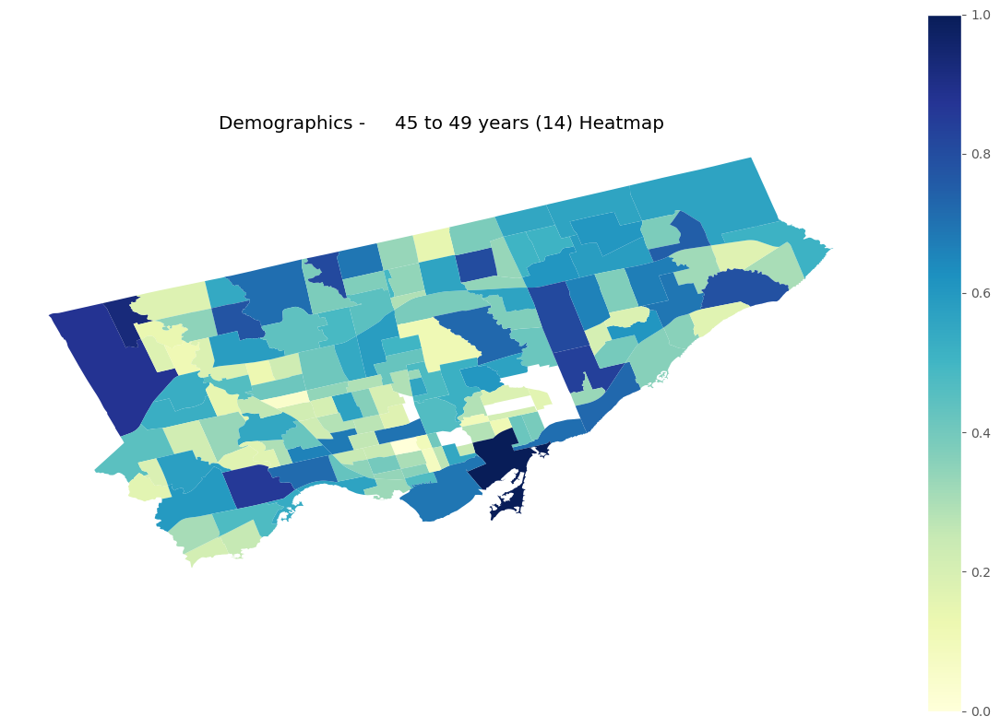

<Figure size 1200x800 with 0 Axes>

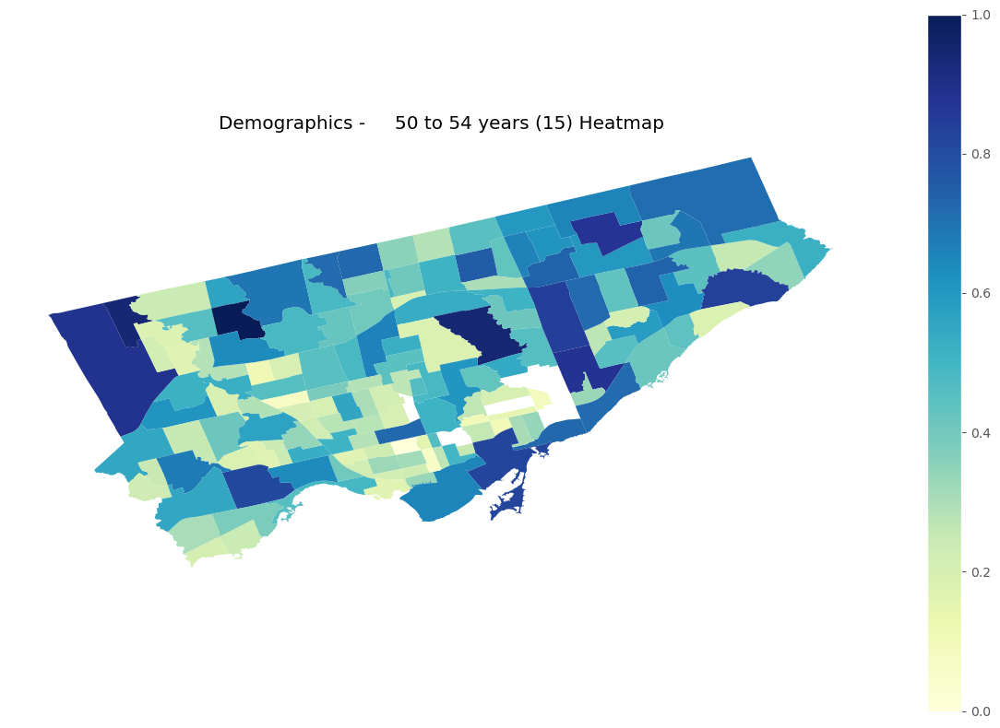

<Figure size 1200x800 with 0 Axes>

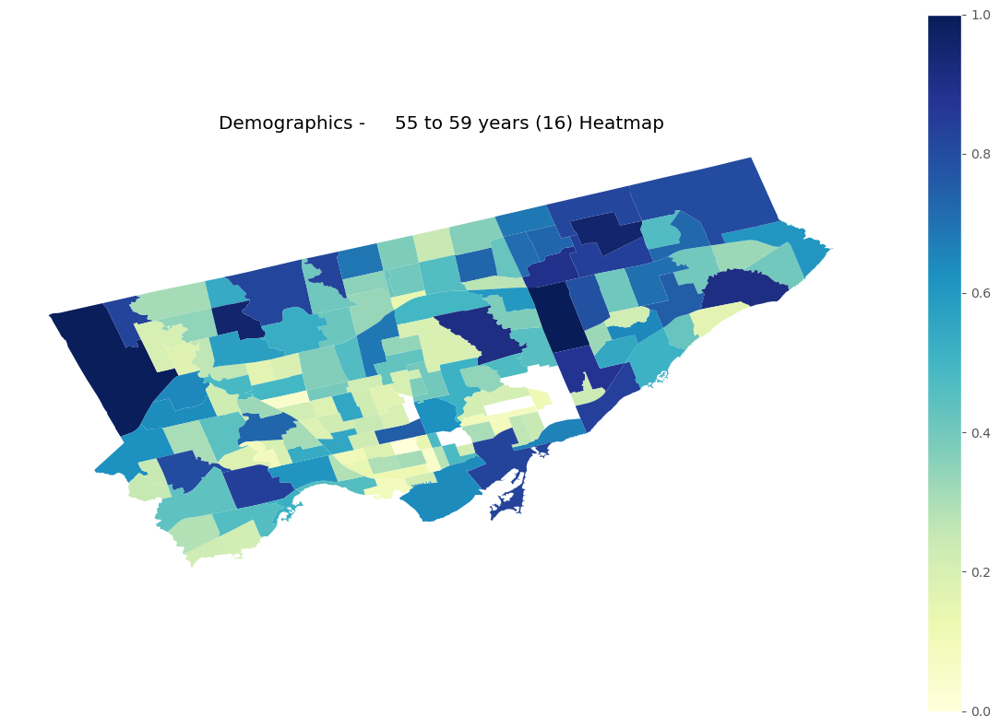

<Figure size 1200x800 with 0 Axes>

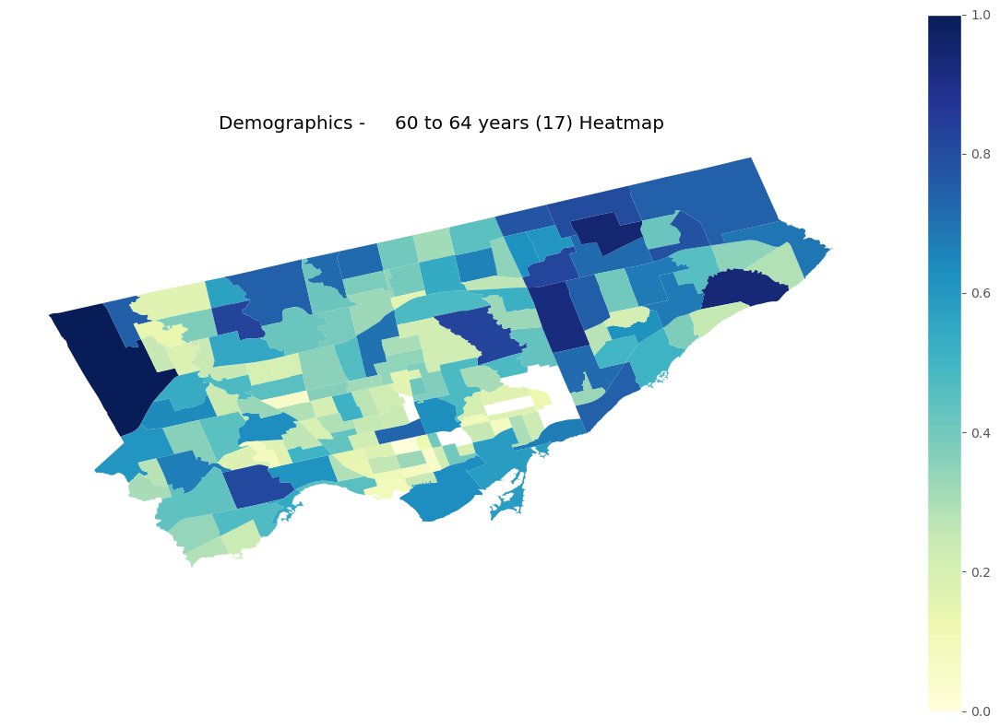

<Figure size 1200x800 with 0 Axes>

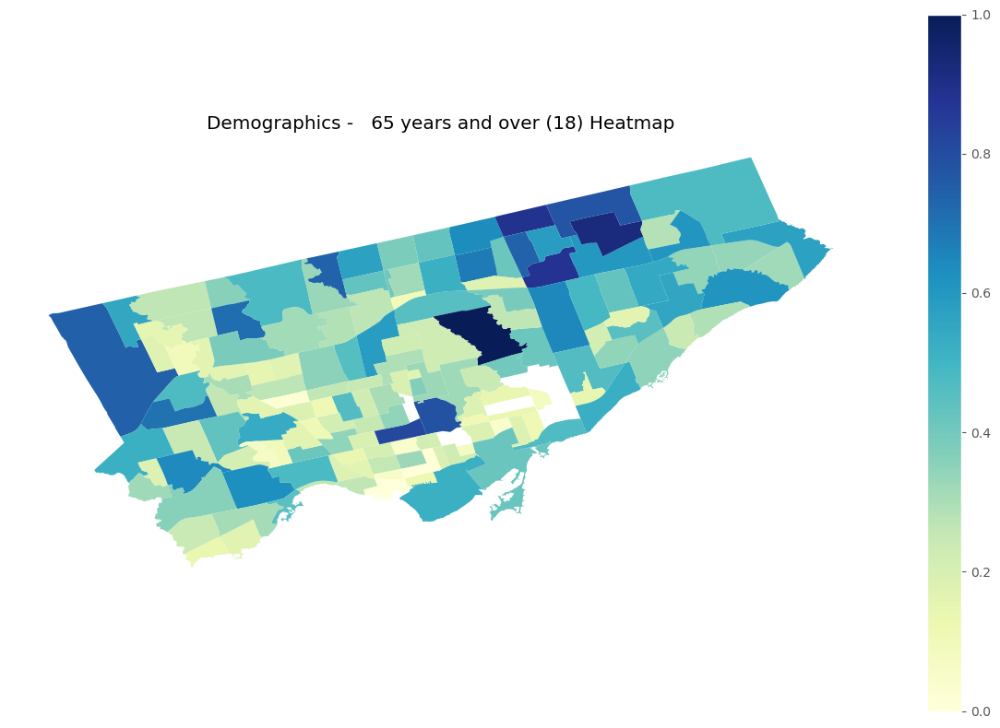

<Figure size 1200x800 with 0 Axes>

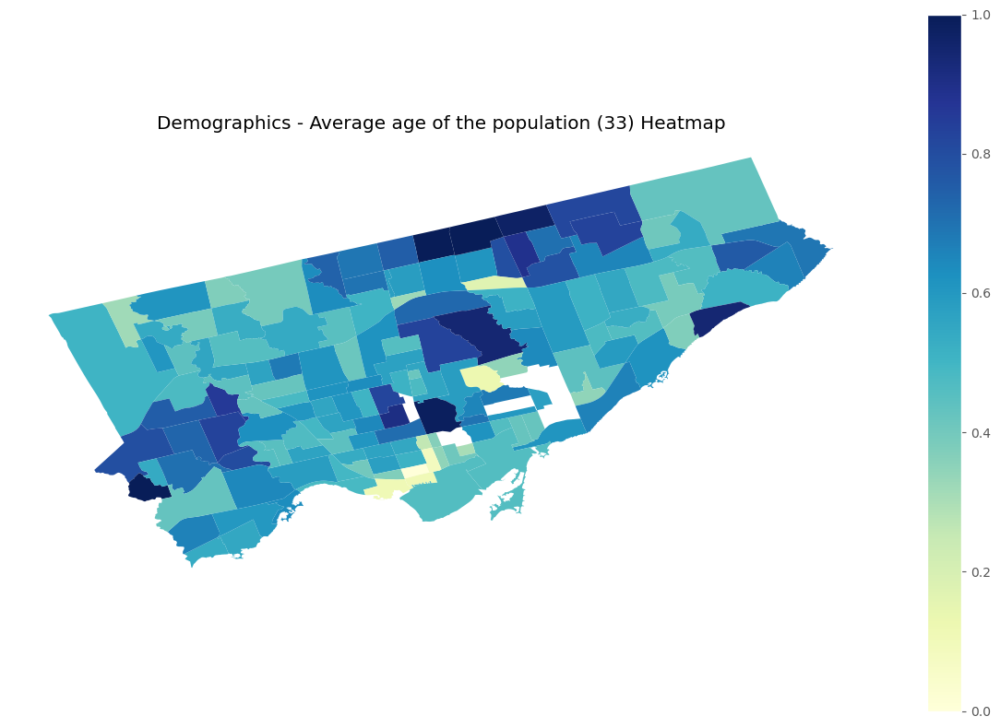

<Figure size 1200x800 with 0 Axes>

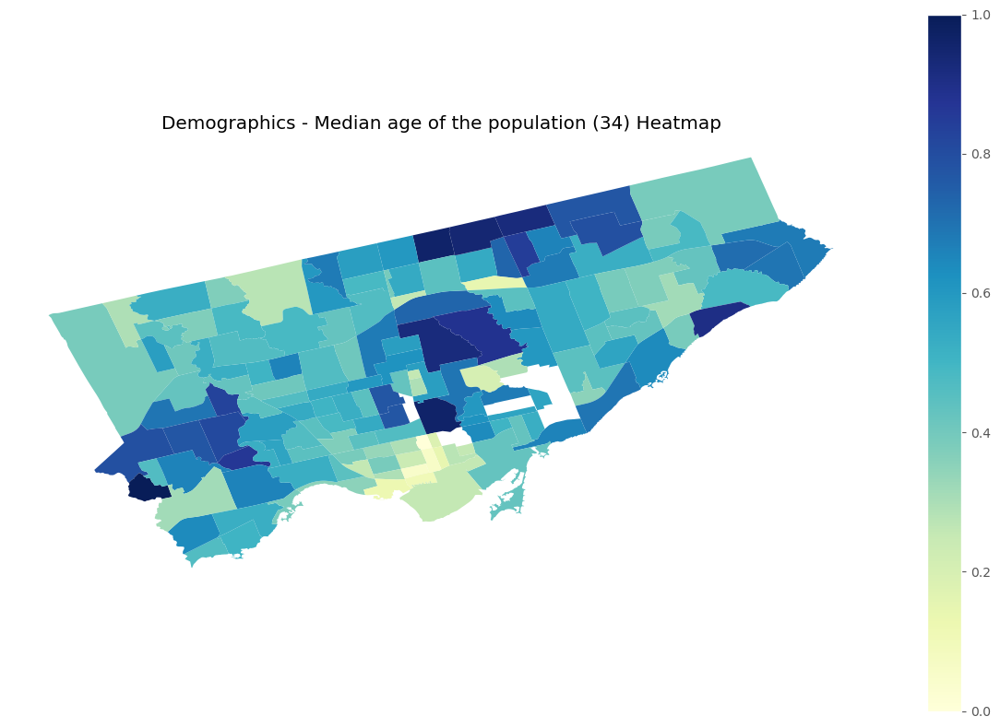

Creating choropleth map for group: Family Composition


<Figure size 1200x800 with 0 Axes>

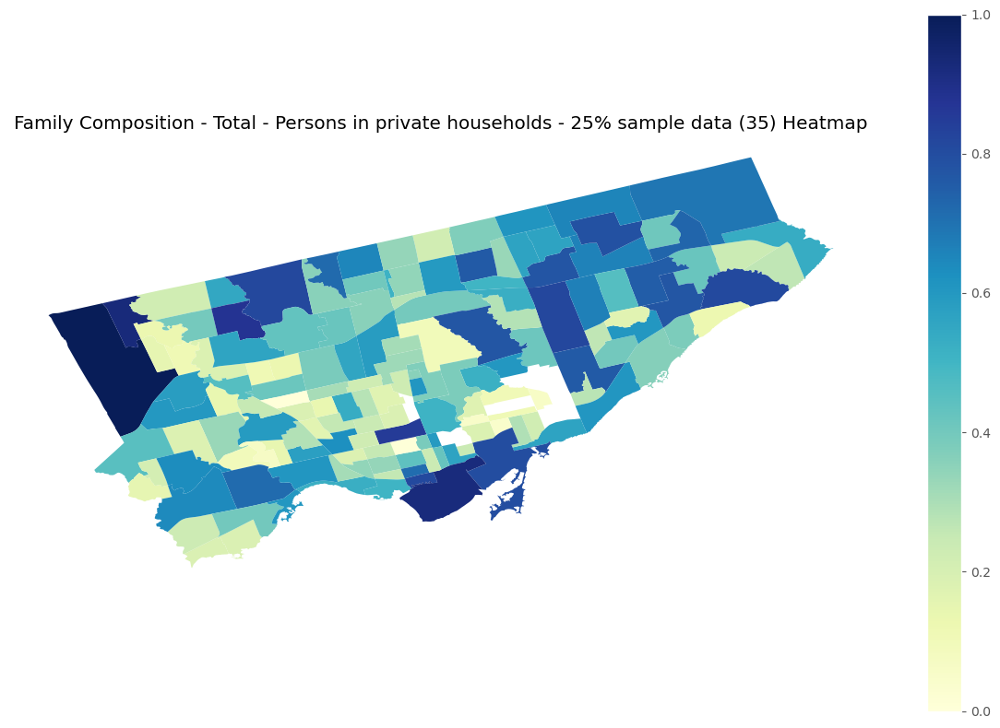

<Figure size 1200x800 with 0 Axes>

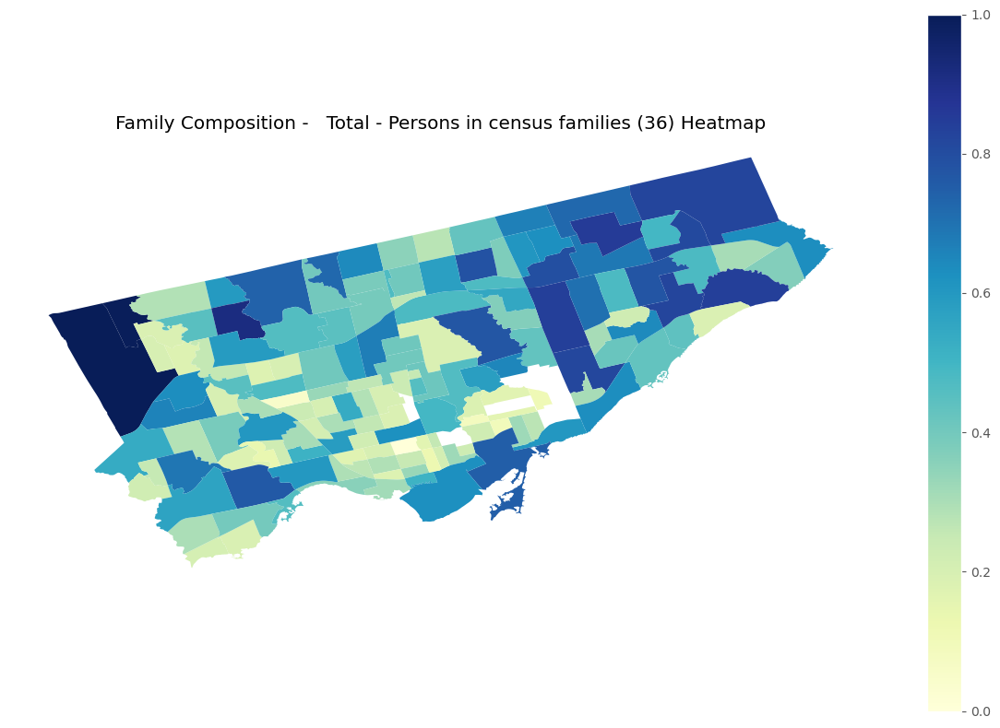

<Figure size 1200x800 with 0 Axes>

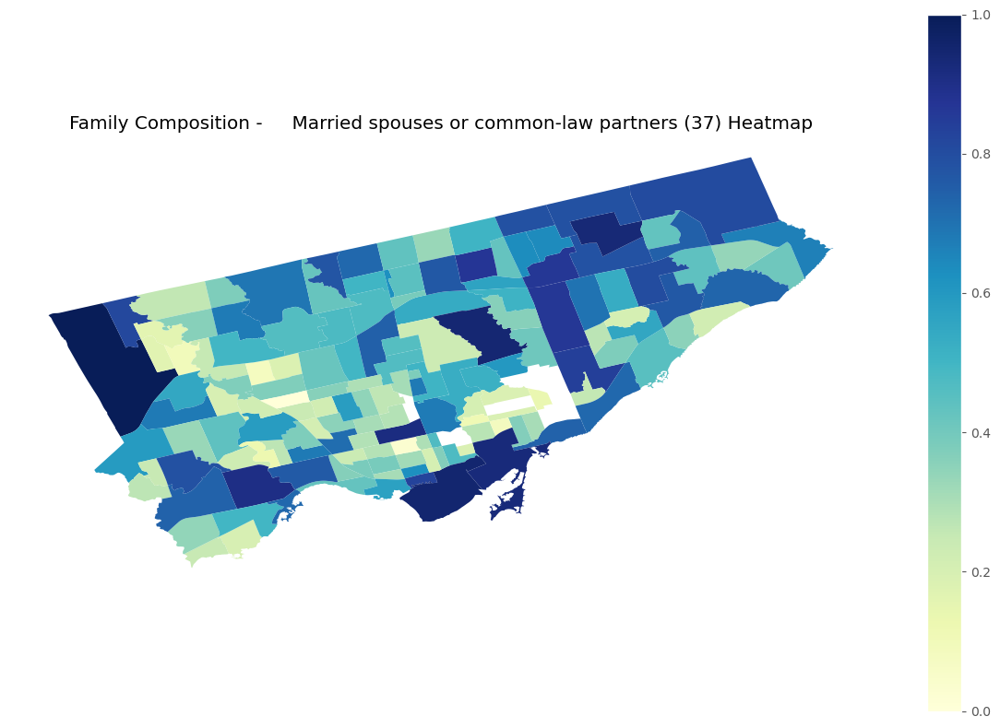

<Figure size 1200x800 with 0 Axes>

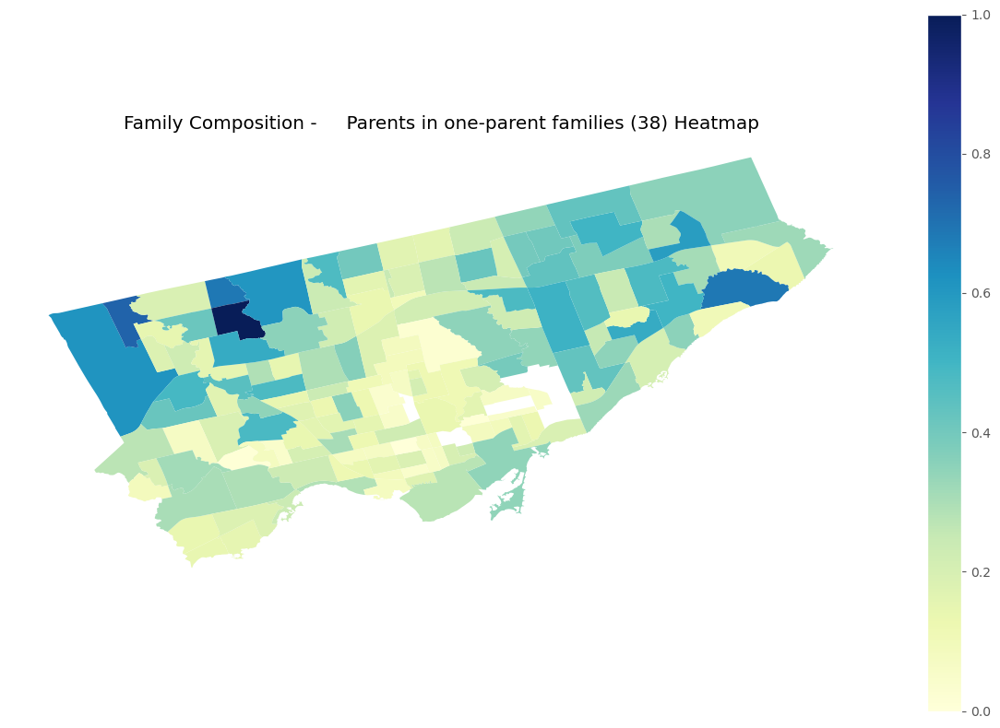

<Figure size 1200x800 with 0 Axes>

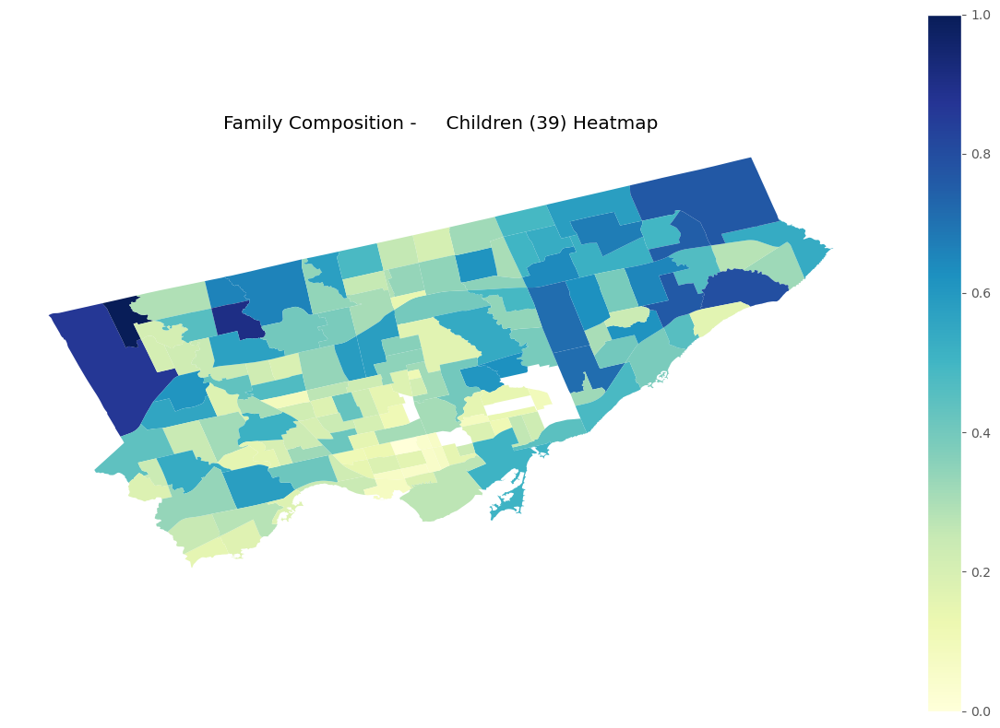

<Figure size 1200x800 with 0 Axes>

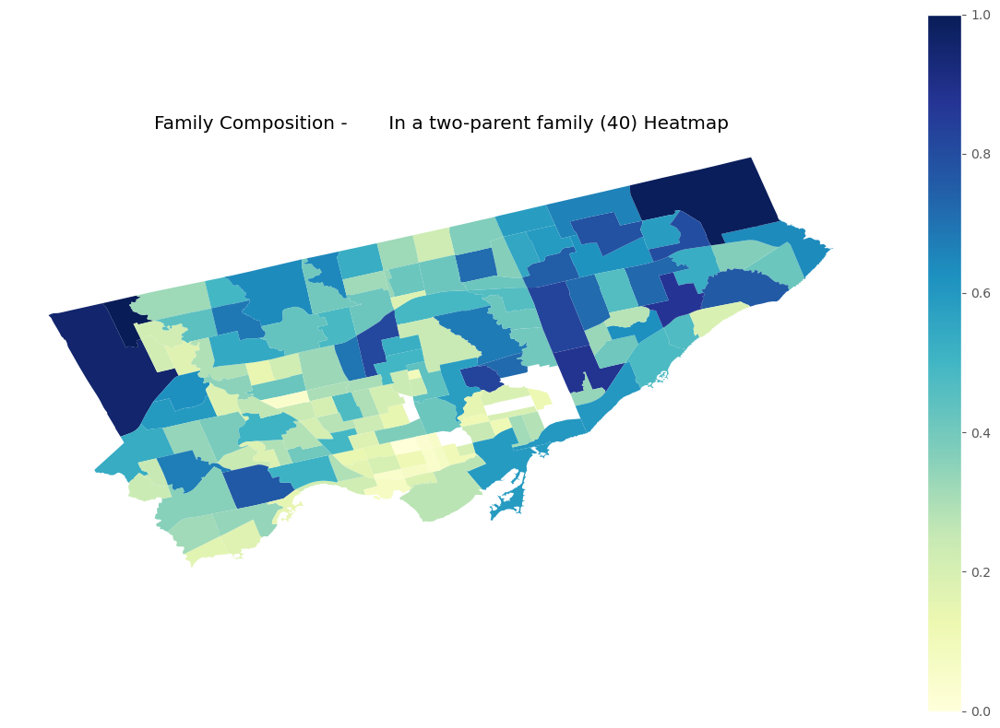

<Figure size 1200x800 with 0 Axes>

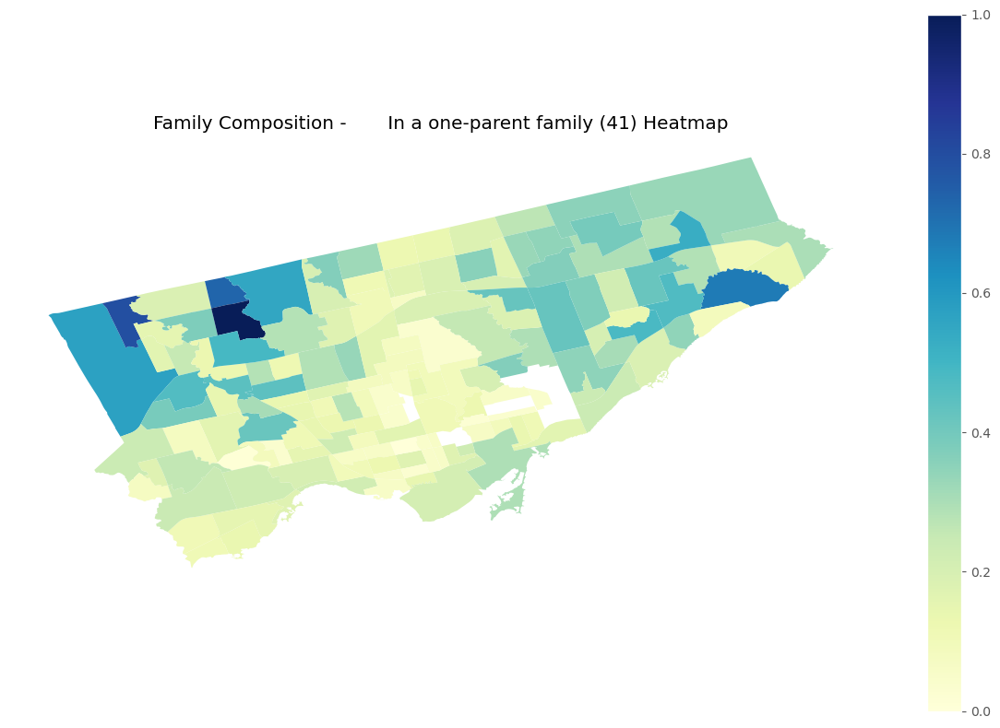

<Figure size 1200x800 with 0 Axes>

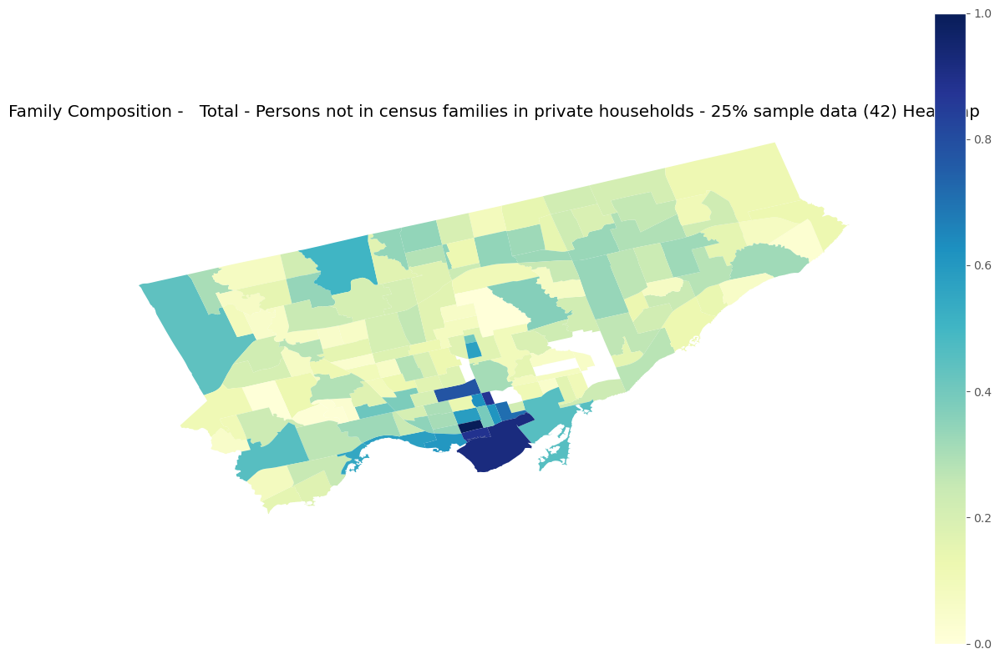

<Figure size 1200x800 with 0 Axes>

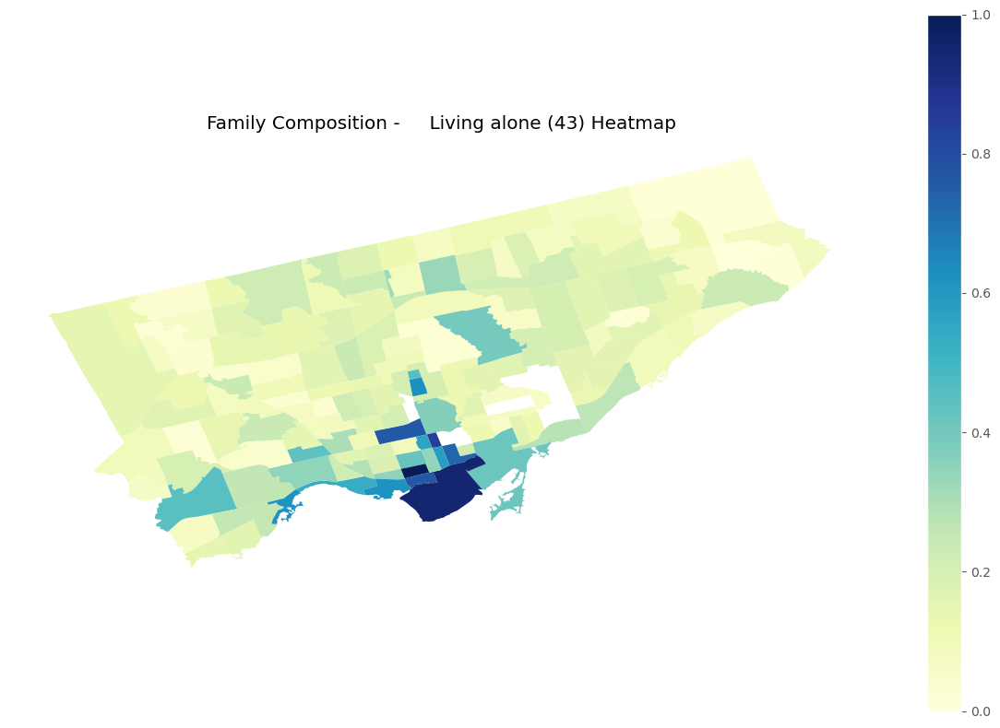

<Figure size 1200x800 with 0 Axes>

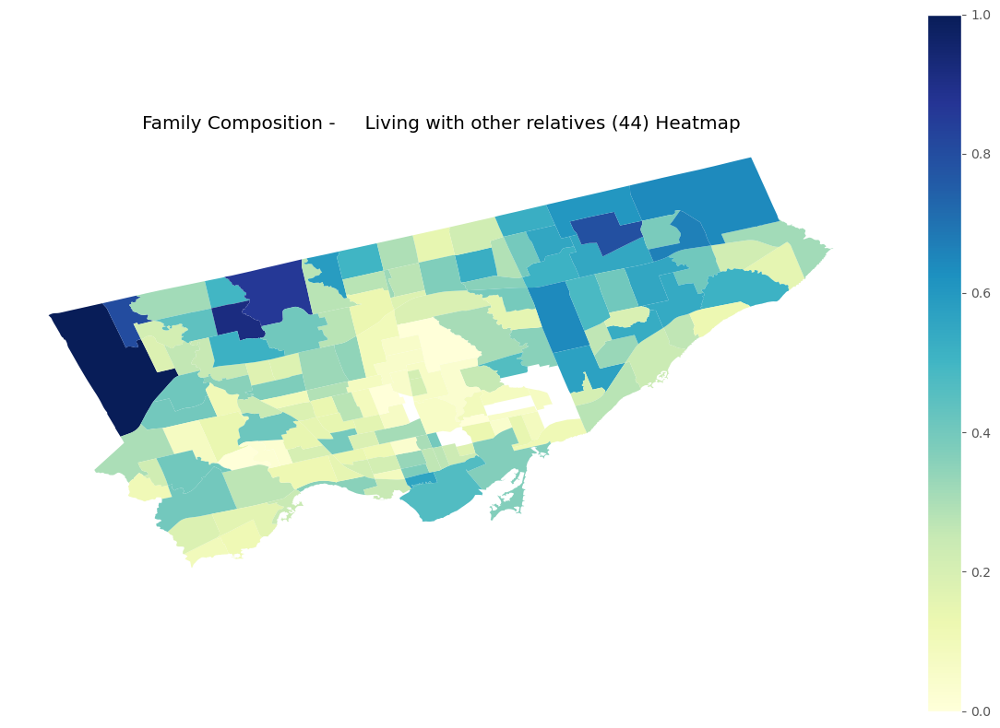

<Figure size 1200x800 with 0 Axes>

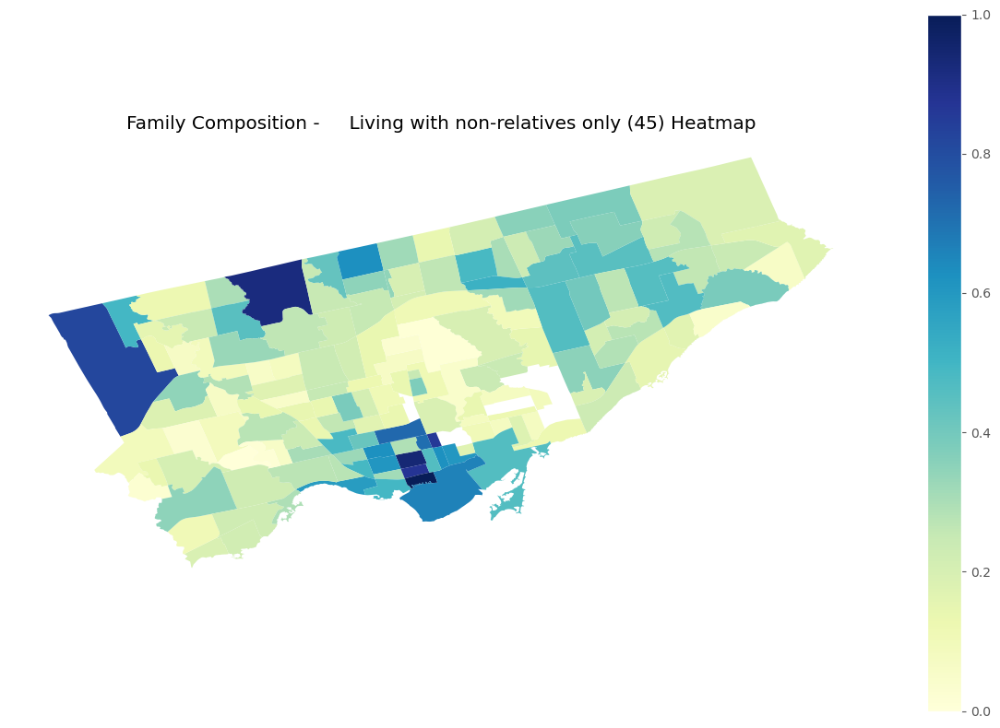

<Figure size 1200x800 with 0 Axes>

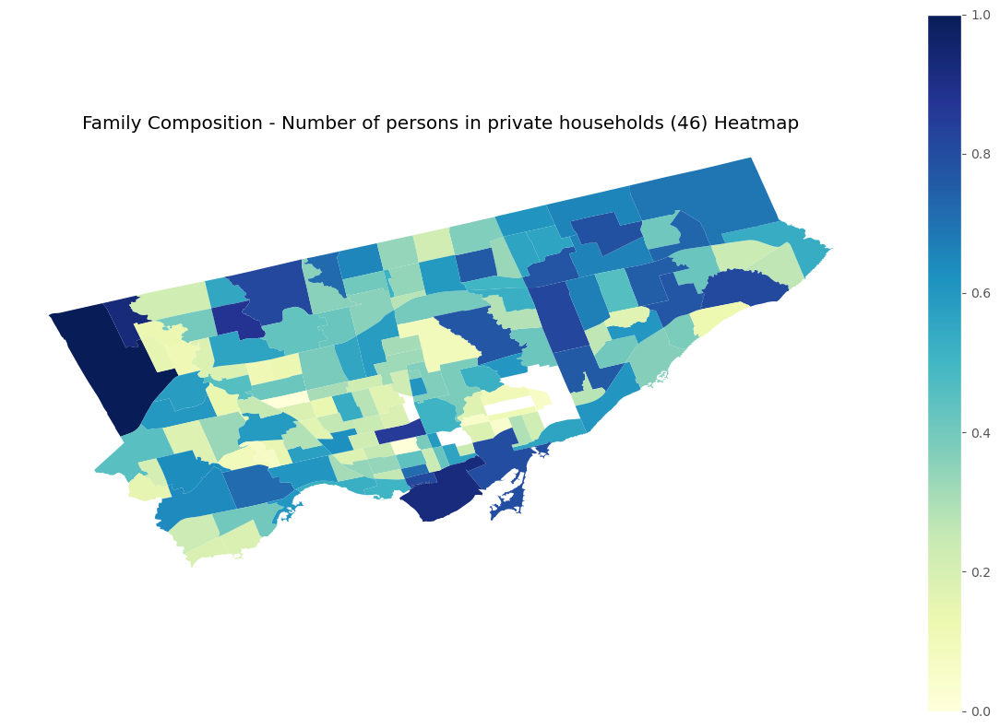

Creating choropleth map for group: Income


<Figure size 1200x800 with 0 Axes>

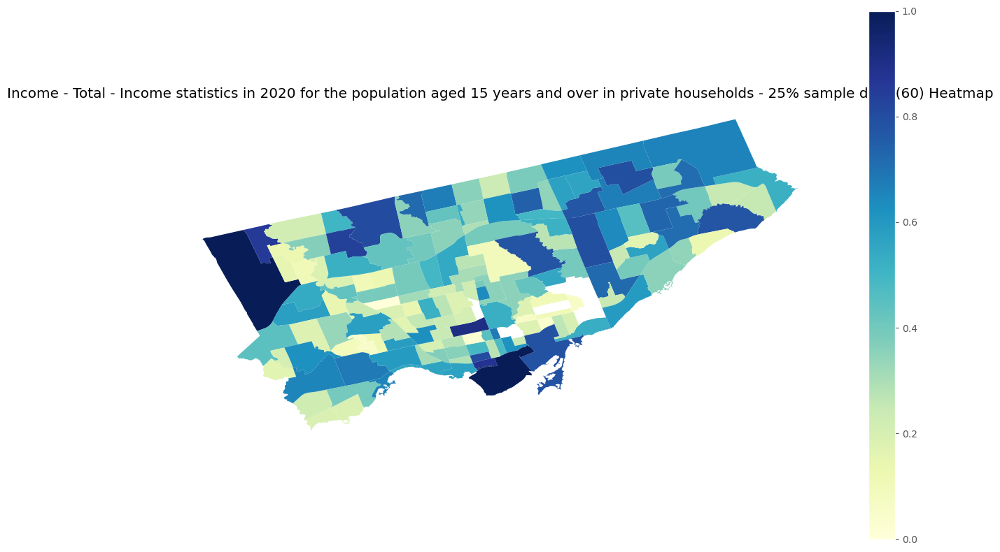

<Figure size 1200x800 with 0 Axes>

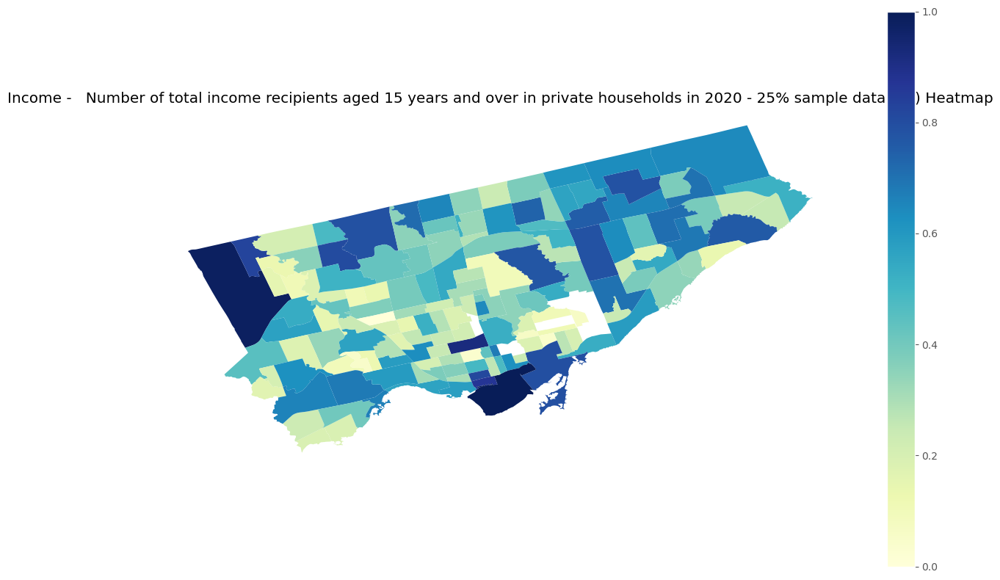

<Figure size 1200x800 with 0 Axes>

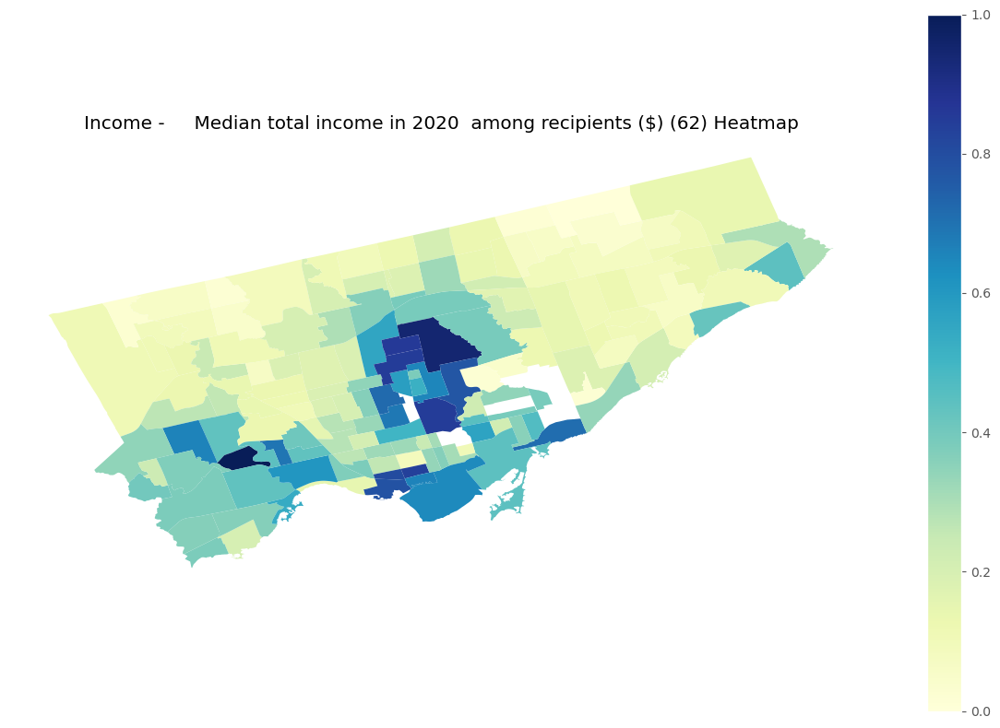

<Figure size 1200x800 with 0 Axes>

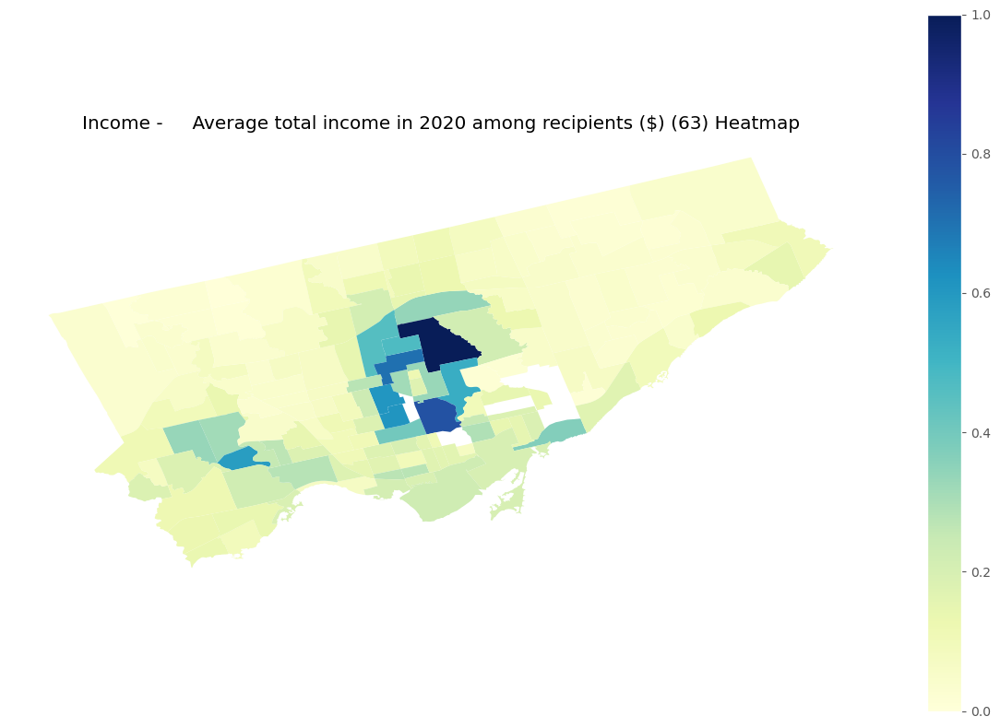

<Figure size 1200x800 with 0 Axes>

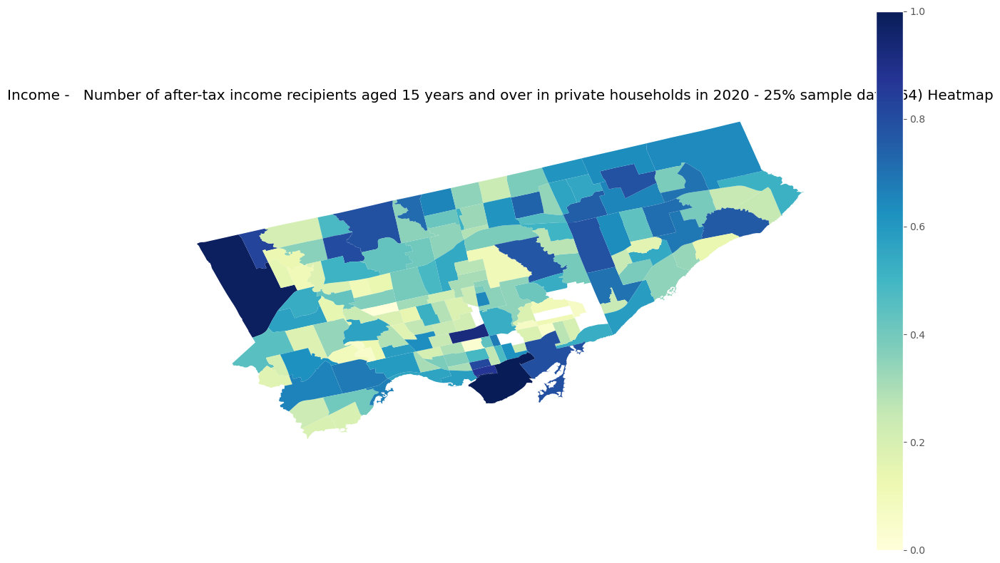

<Figure size 1200x800 with 0 Axes>

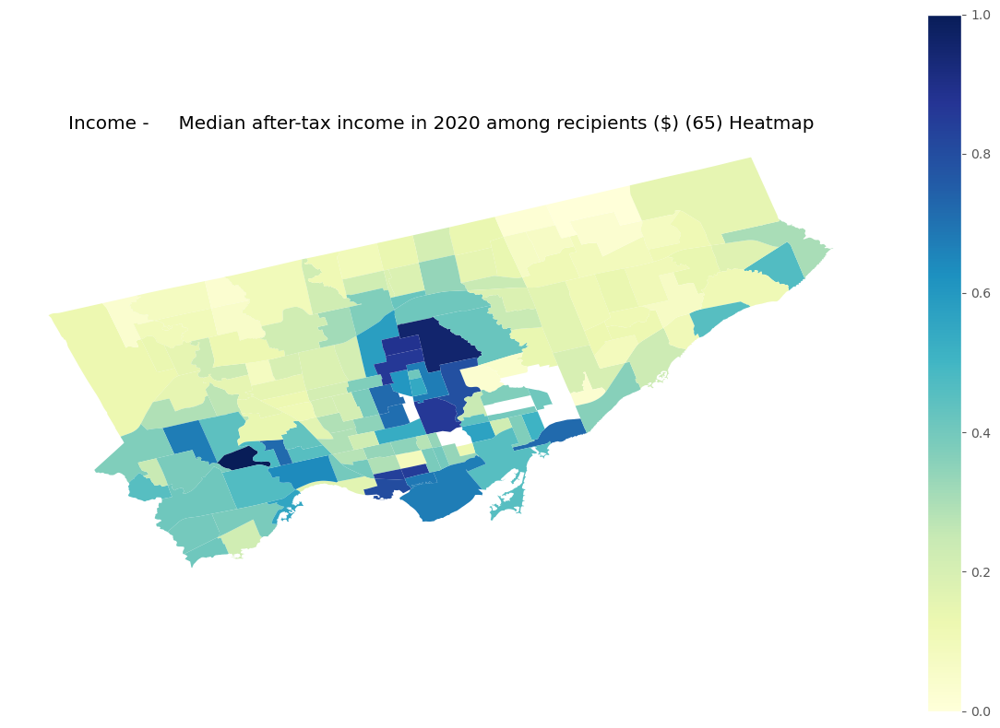

<Figure size 1200x800 with 0 Axes>

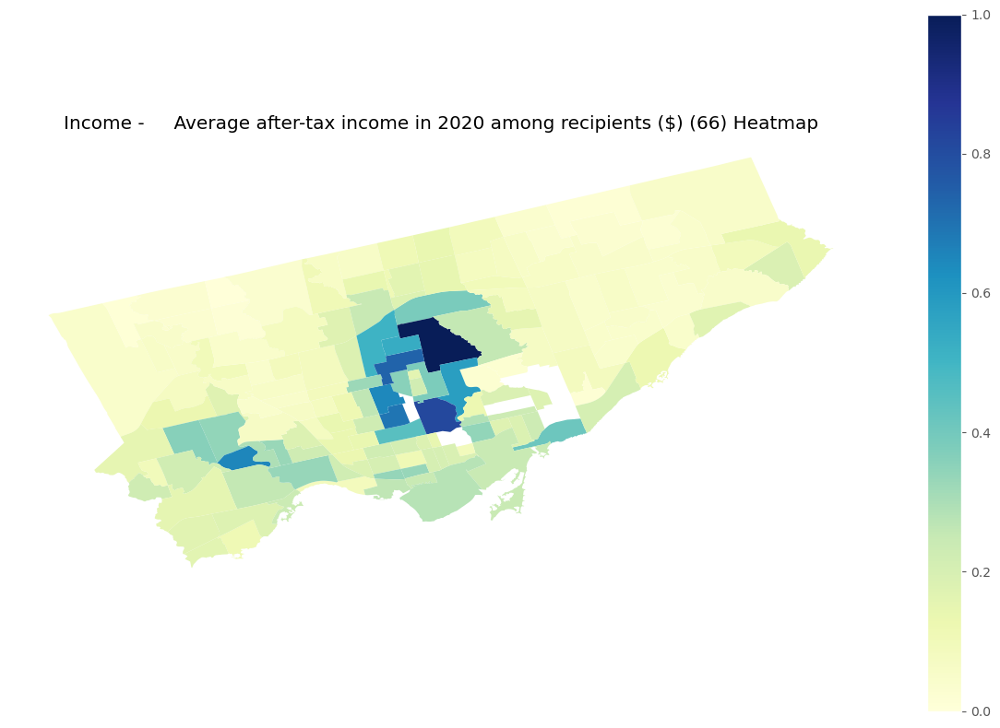

<Figure size 1200x800 with 0 Axes>

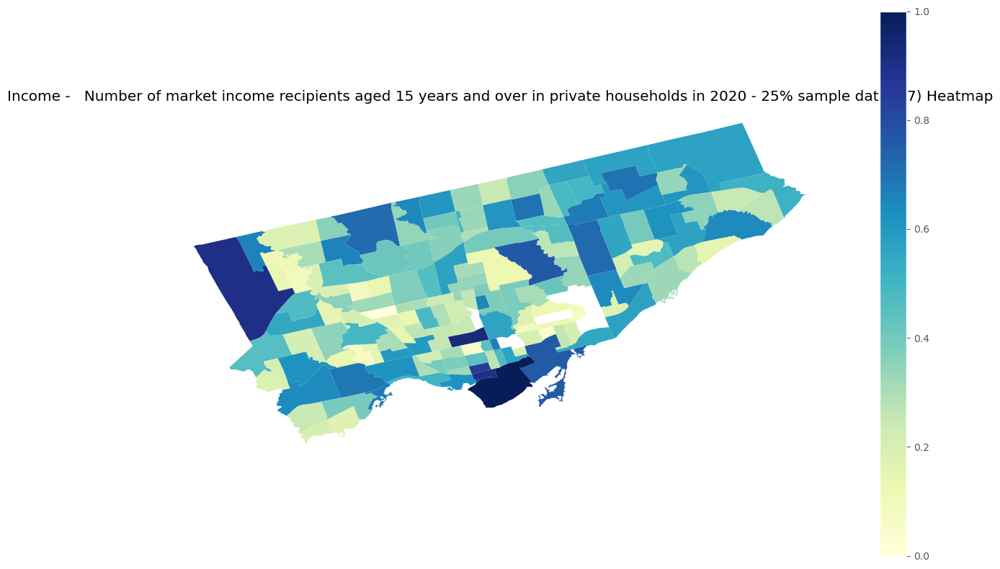

<Figure size 1200x800 with 0 Axes>

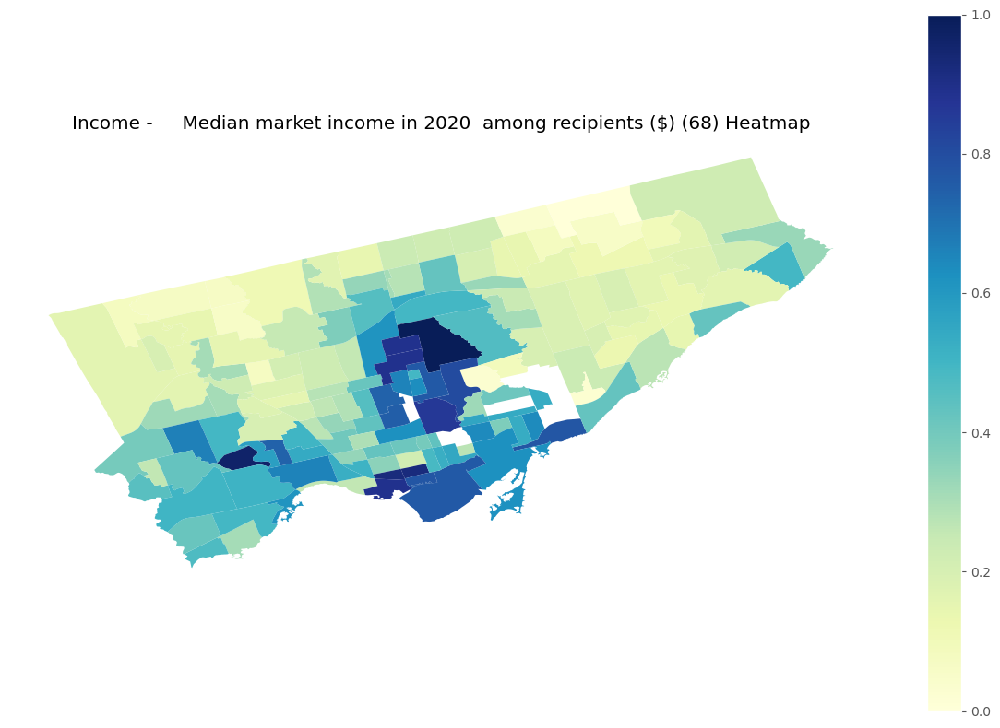

<Figure size 1200x800 with 0 Axes>

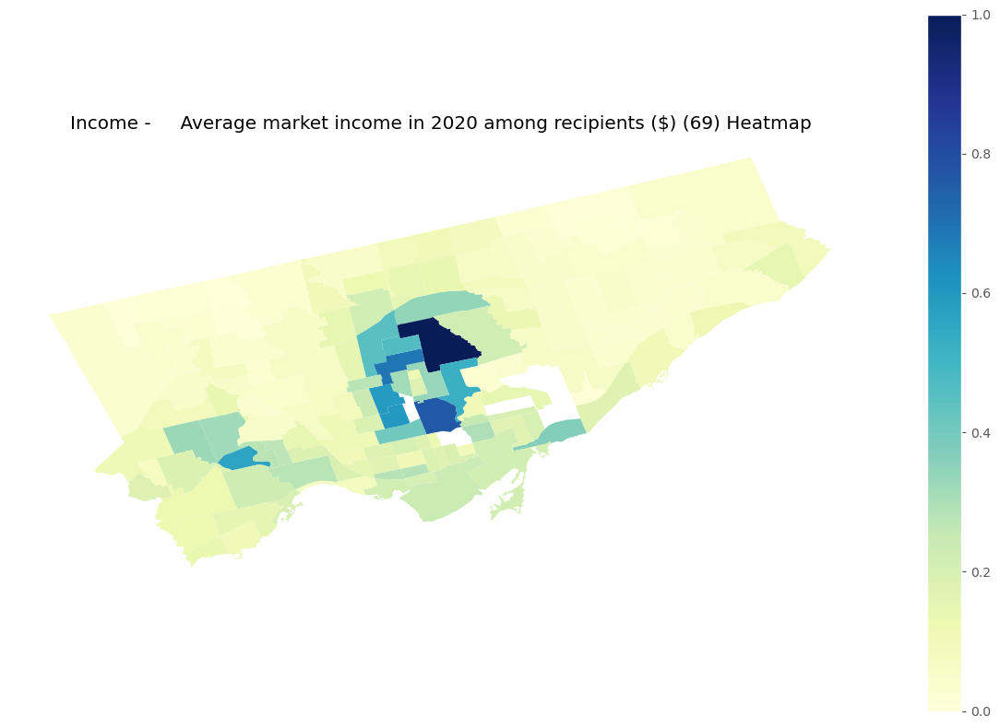

<Figure size 1200x800 with 0 Axes>

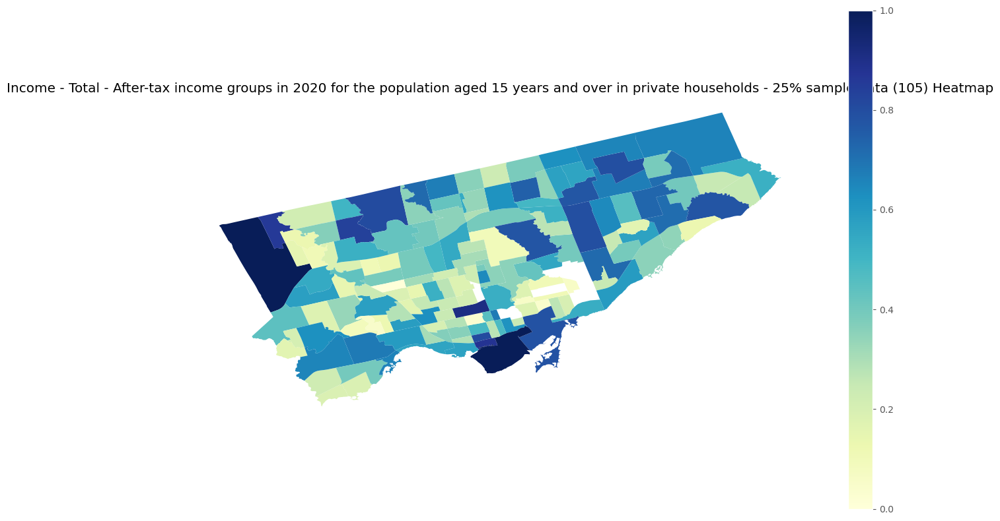

<Figure size 1200x800 with 0 Axes>

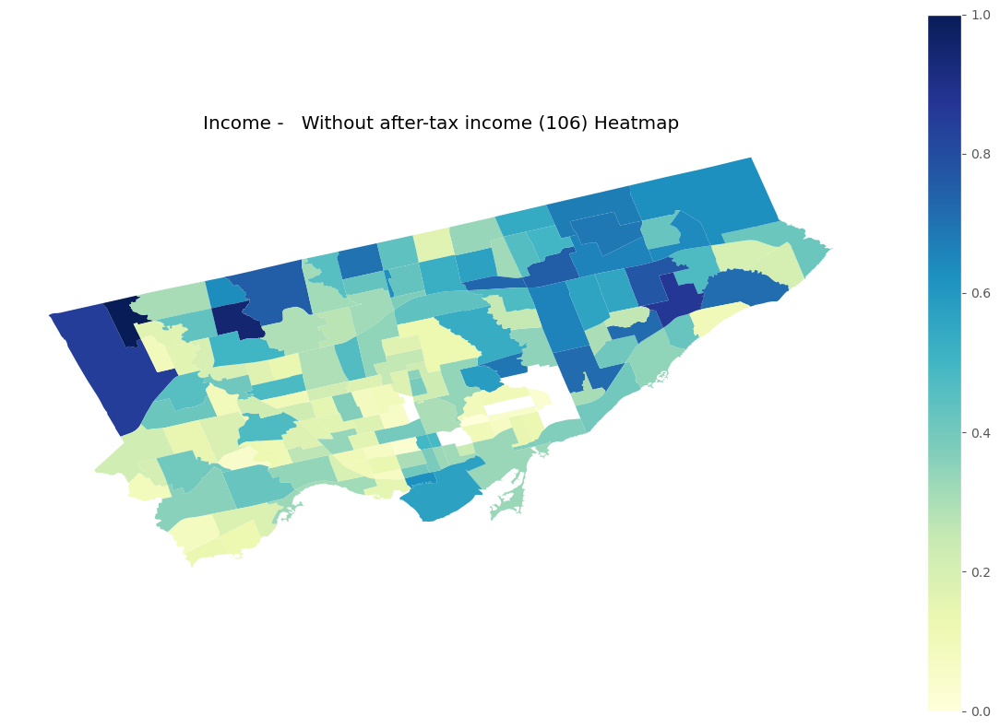

<Figure size 1200x800 with 0 Axes>

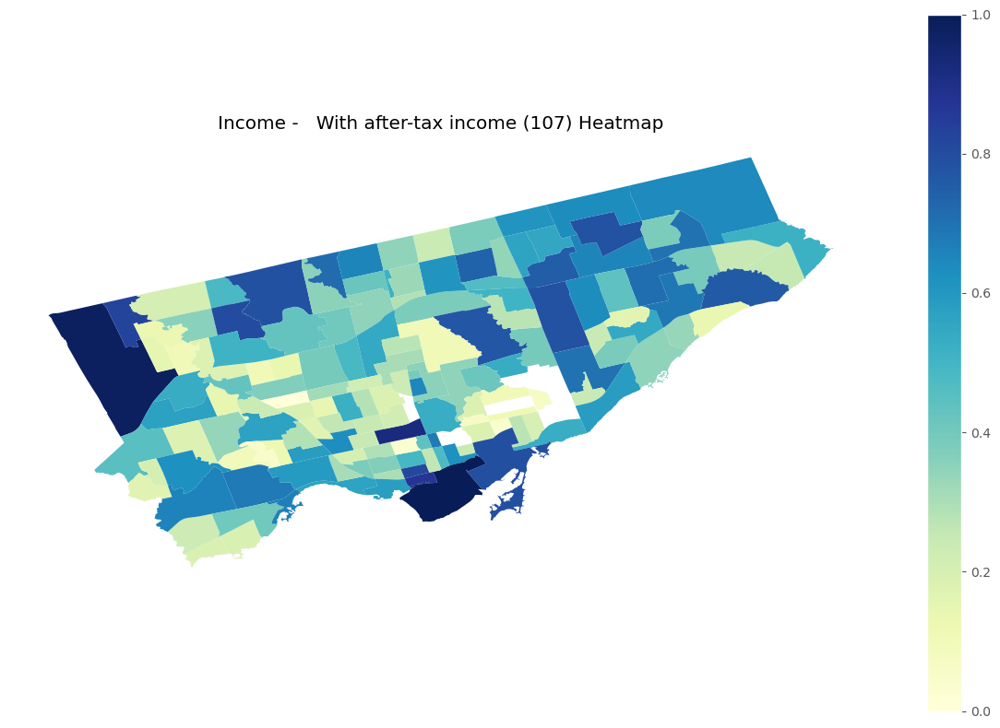

<Figure size 1200x800 with 0 Axes>

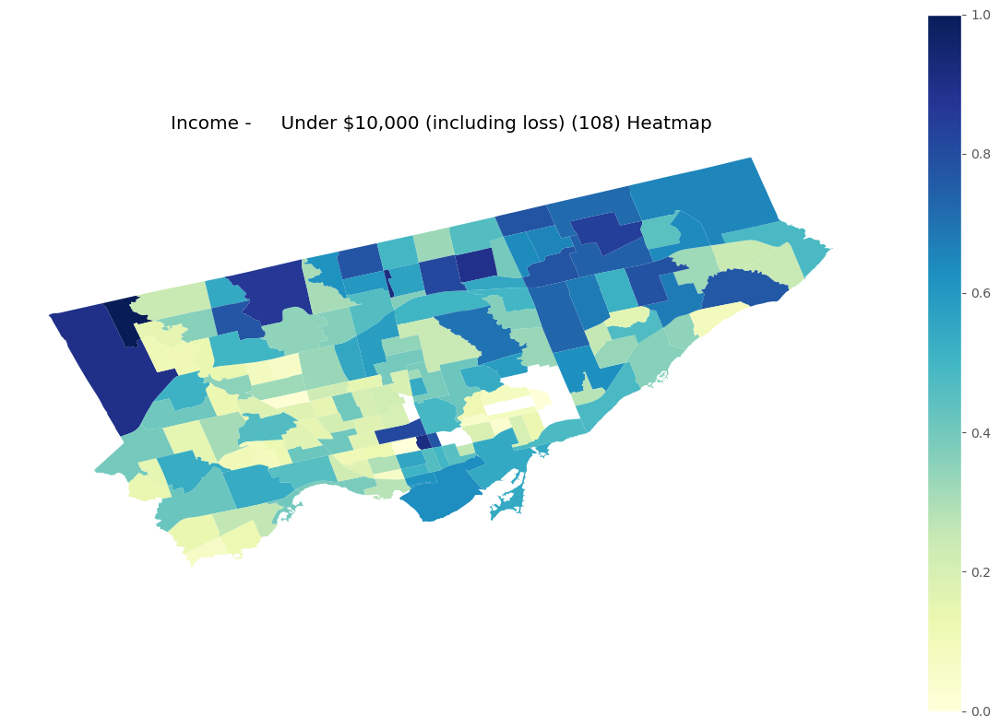

<Figure size 1200x800 with 0 Axes>

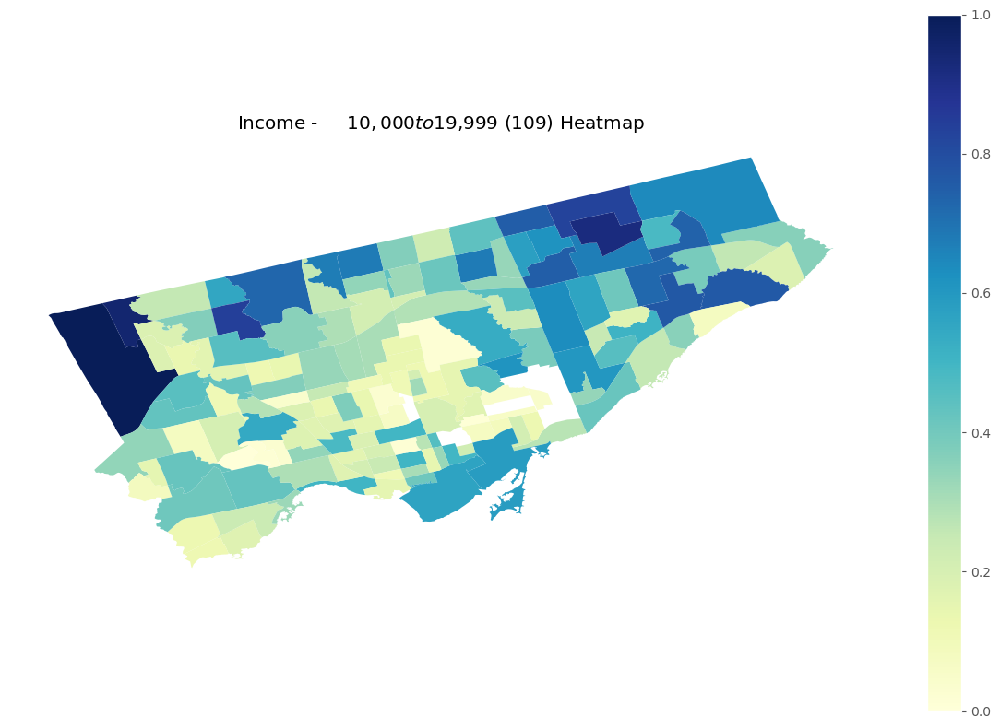

<Figure size 1200x800 with 0 Axes>

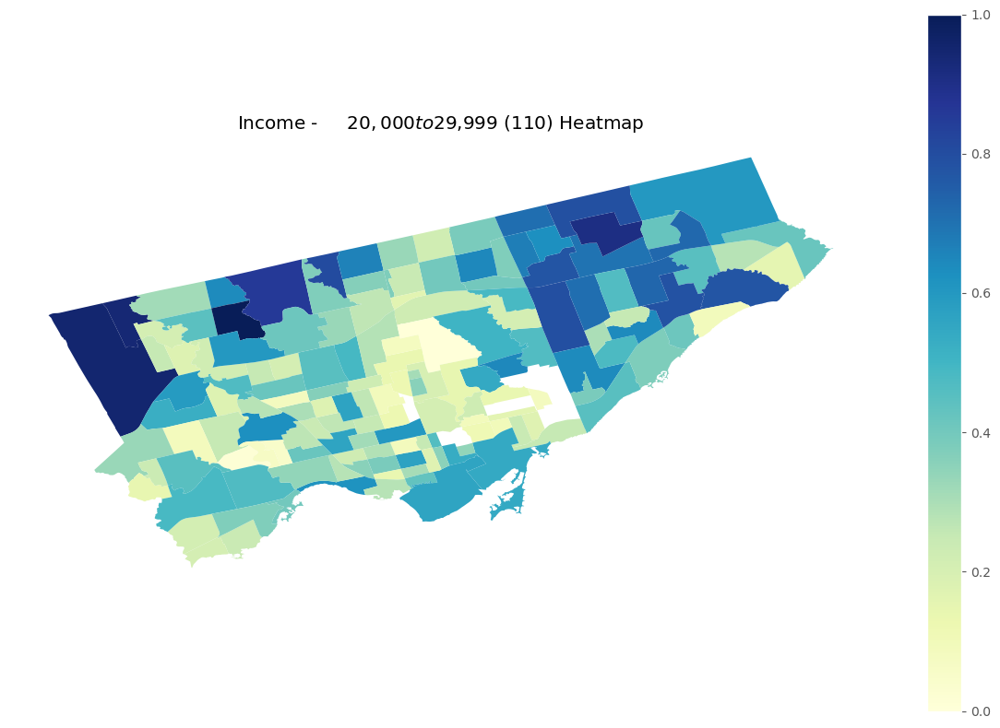

<Figure size 1200x800 with 0 Axes>

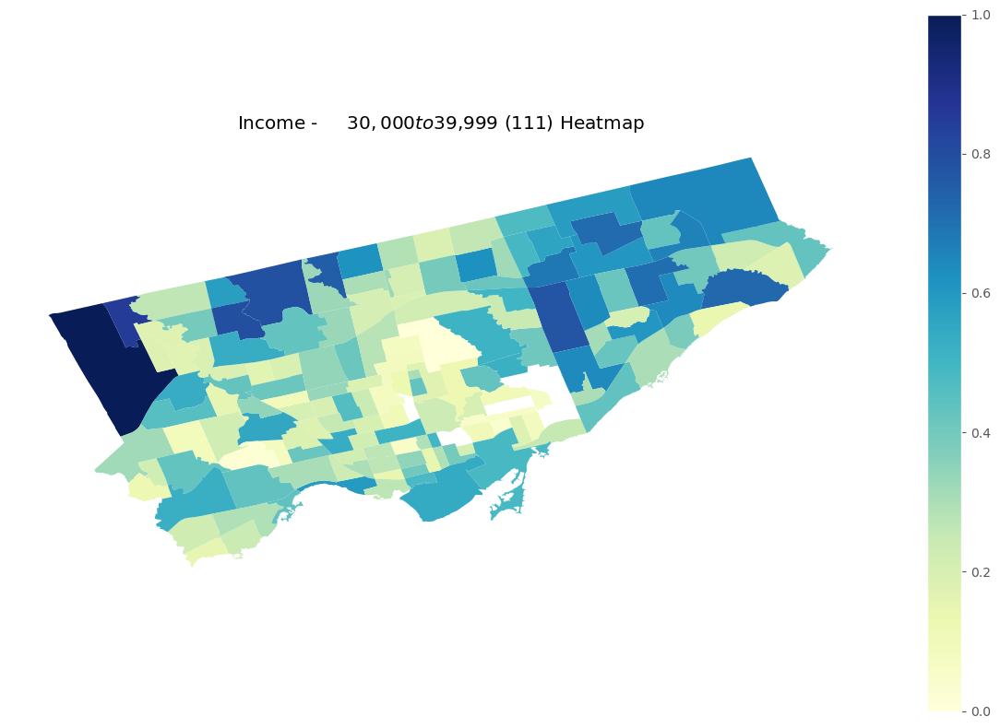

<Figure size 1200x800 with 0 Axes>

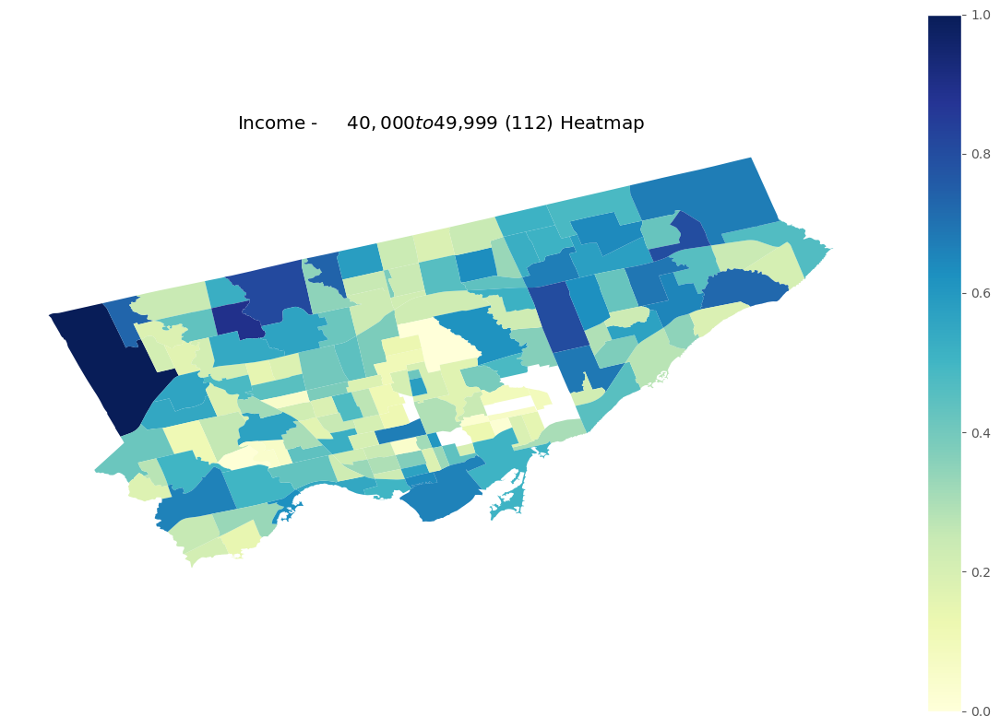

<Figure size 1200x800 with 0 Axes>

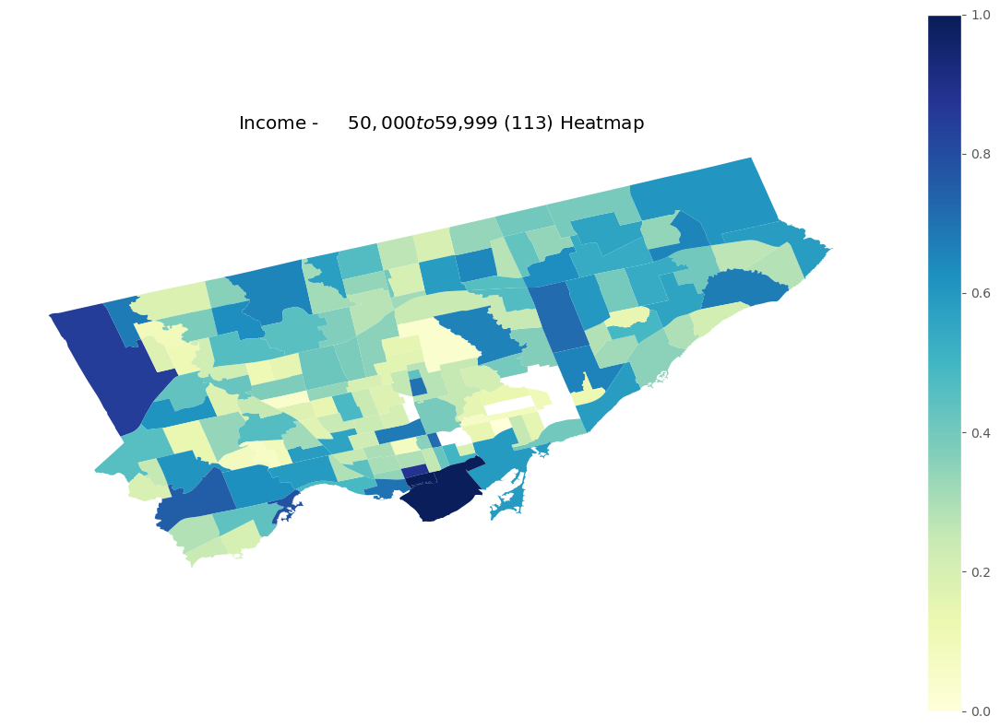

<Figure size 1200x800 with 0 Axes>

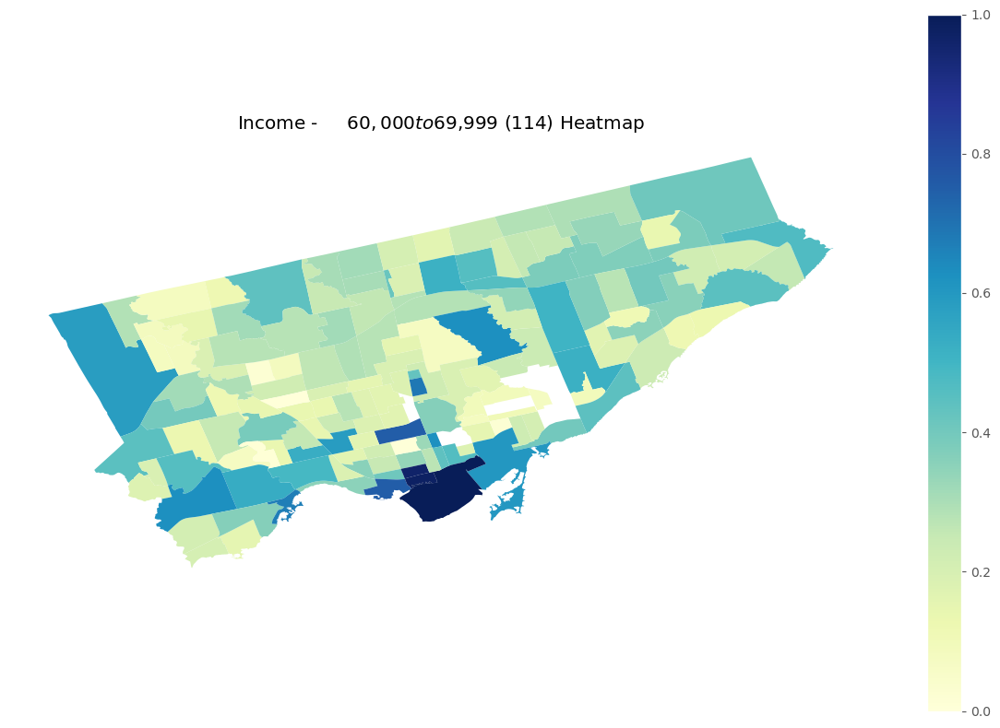

<Figure size 1200x800 with 0 Axes>

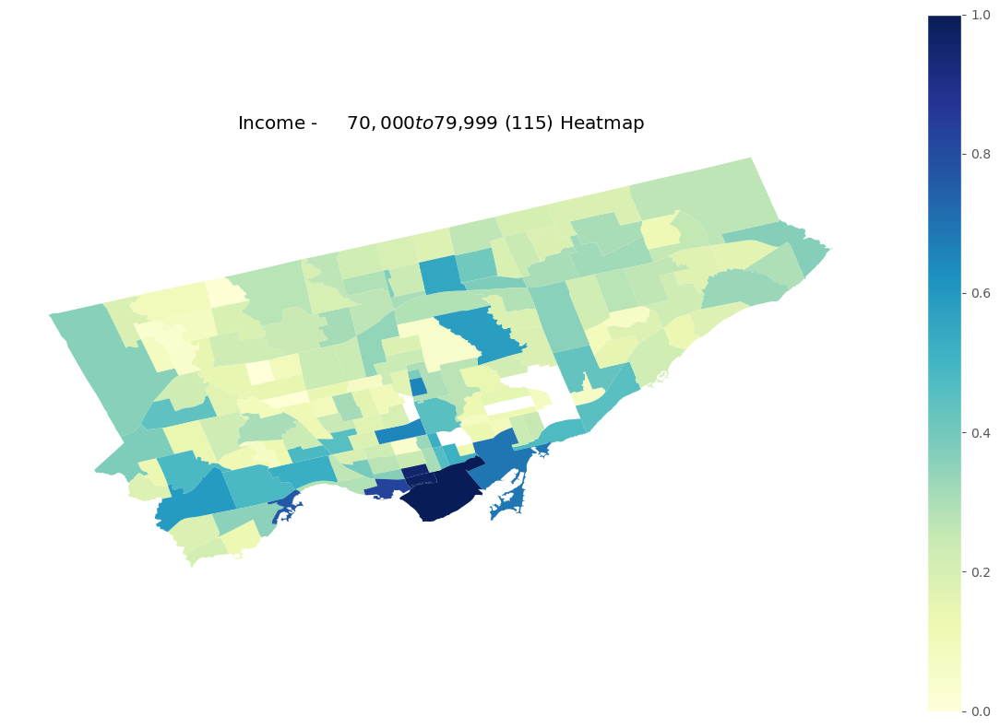

<Figure size 1200x800 with 0 Axes>

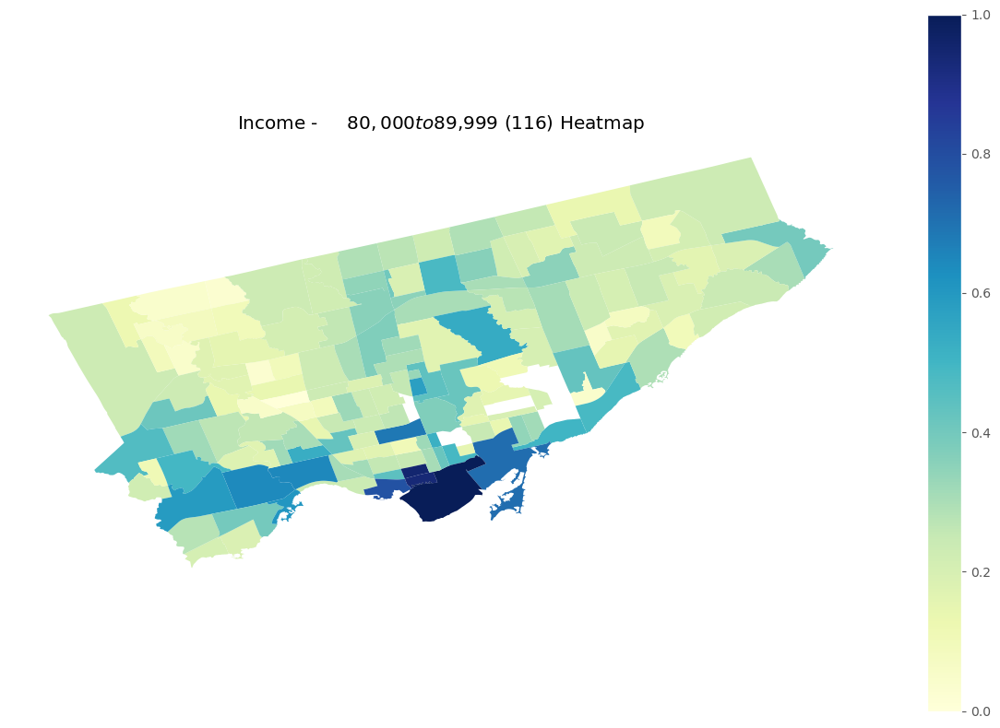

<Figure size 1200x800 with 0 Axes>

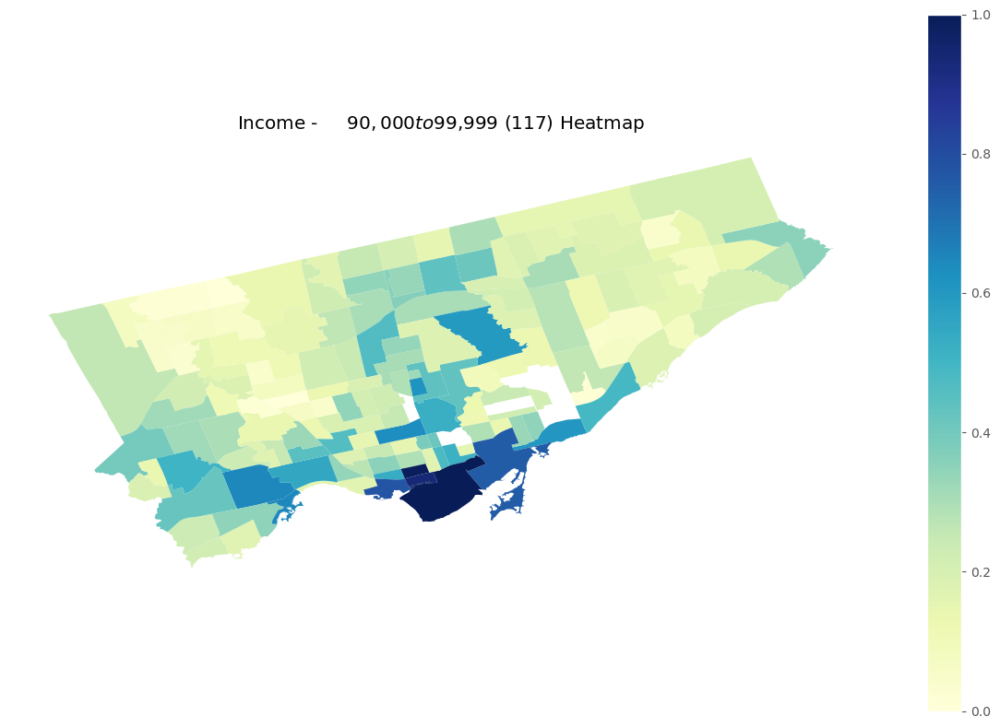

<Figure size 1200x800 with 0 Axes>

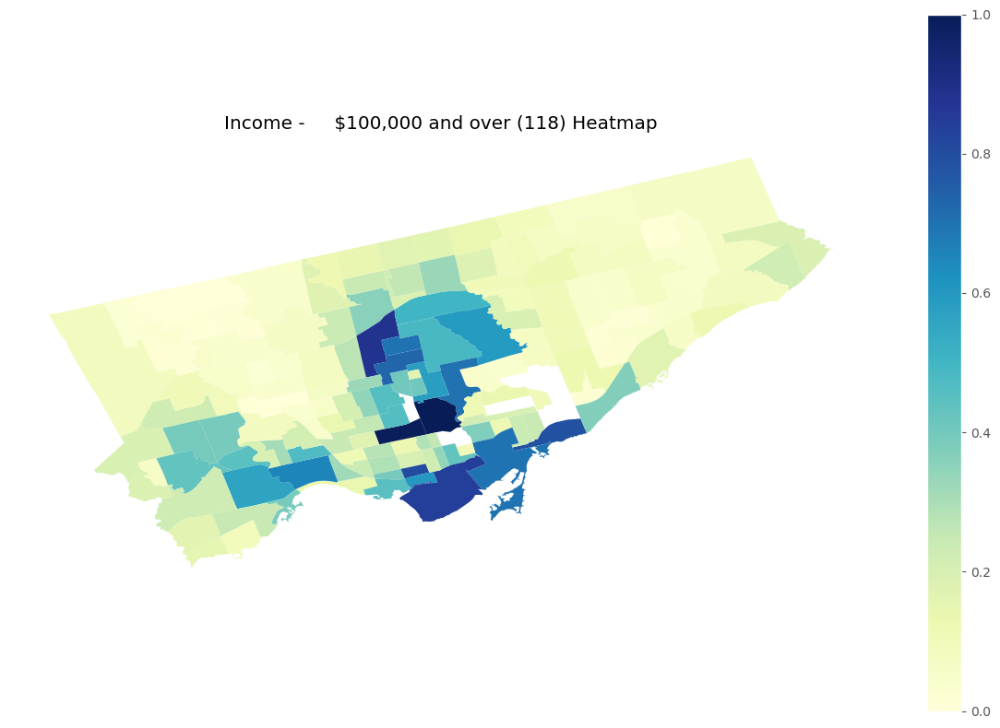

<Figure size 1200x800 with 0 Axes>

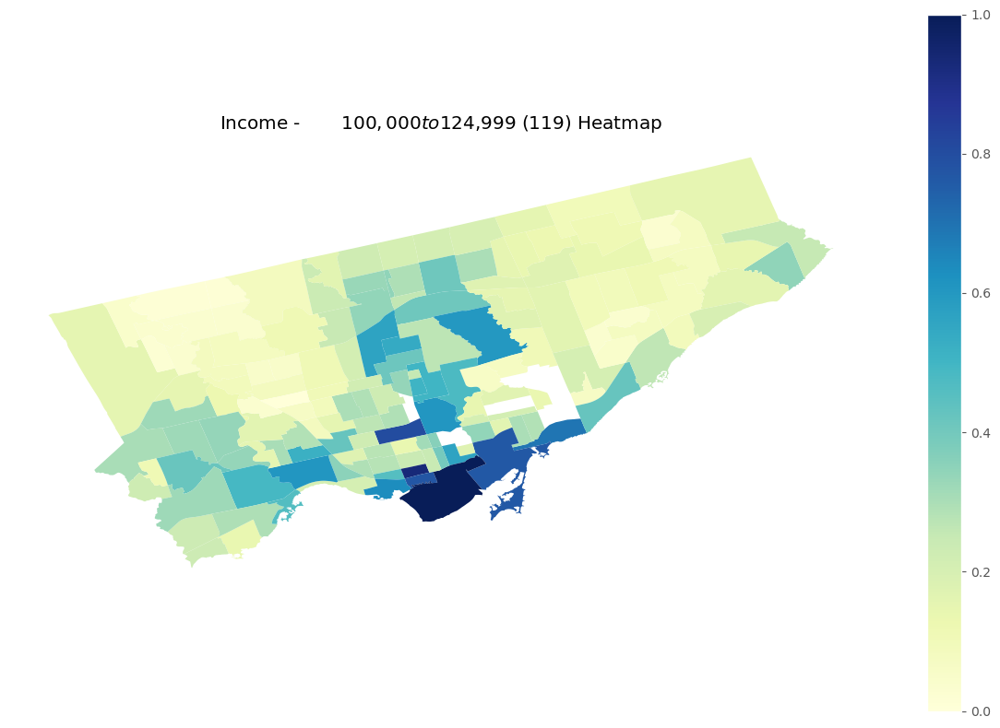

<Figure size 1200x800 with 0 Axes>

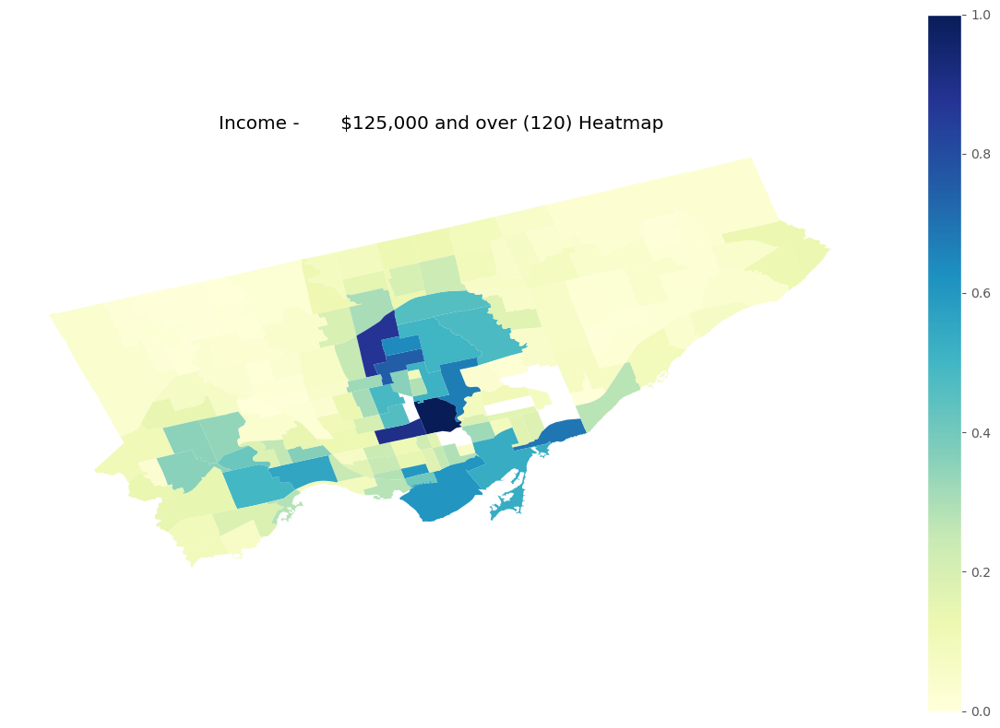

Creating choropleth map for group: Housing


<Figure size 1200x800 with 0 Axes>

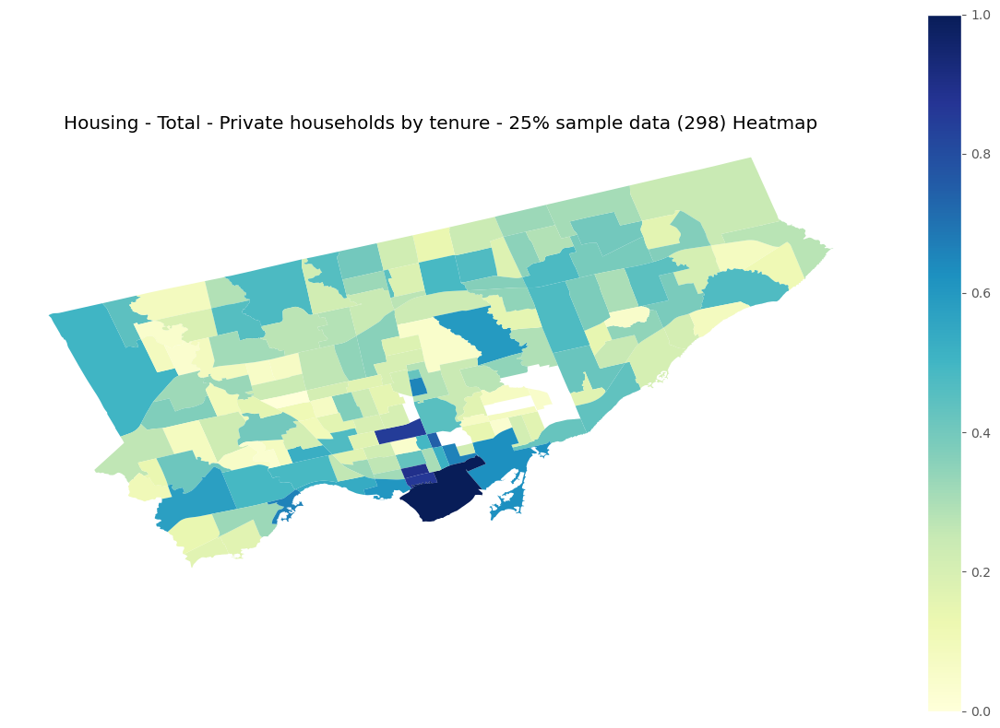

<Figure size 1200x800 with 0 Axes>

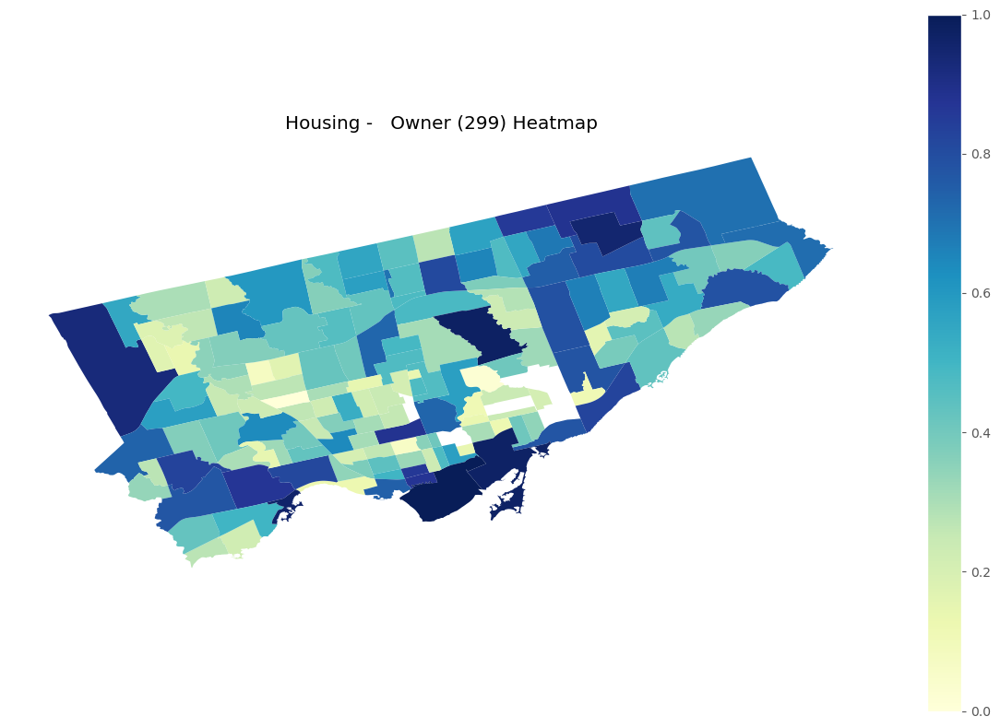

<Figure size 1200x800 with 0 Axes>

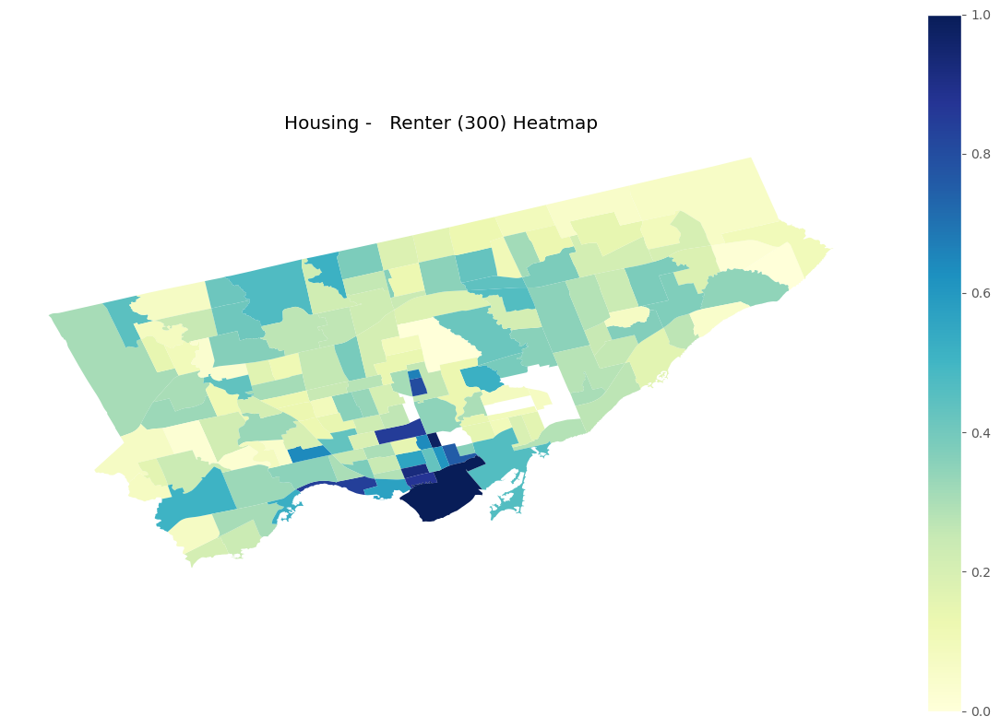

<Figure size 1200x800 with 0 Axes>

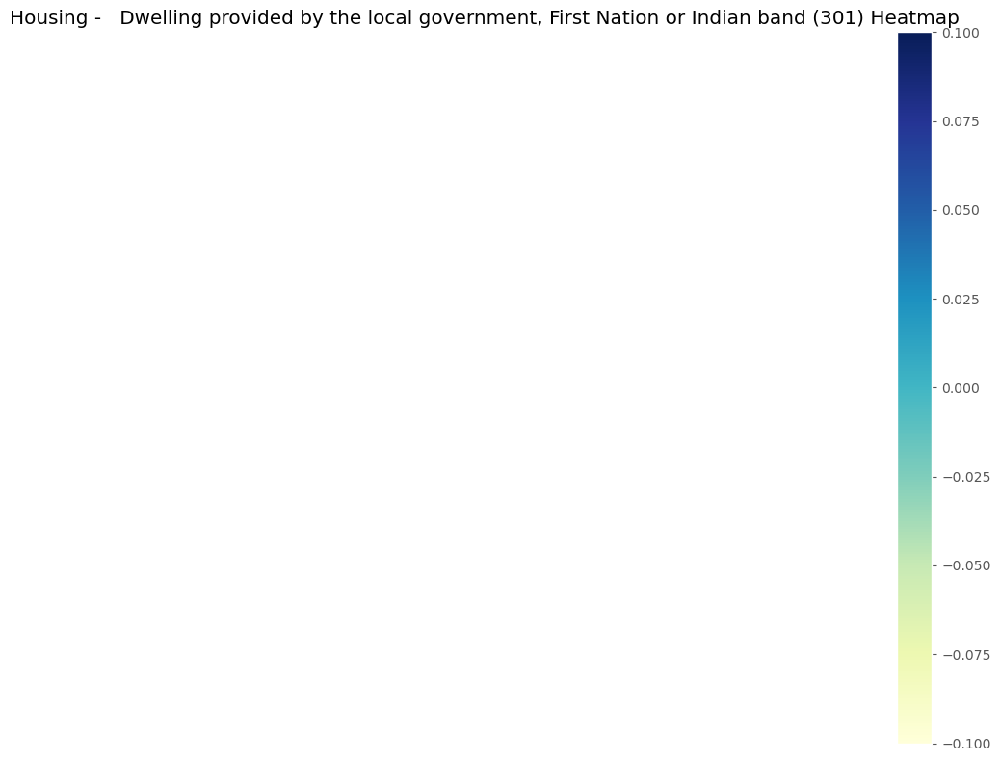

<Figure size 1200x800 with 0 Axes>

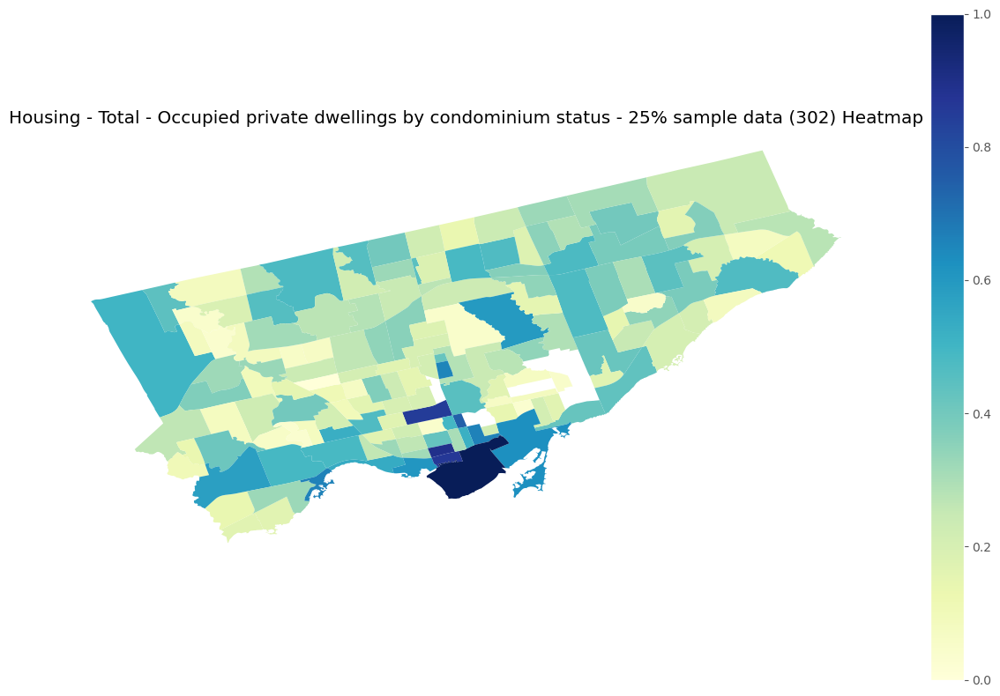

<Figure size 1200x800 with 0 Axes>

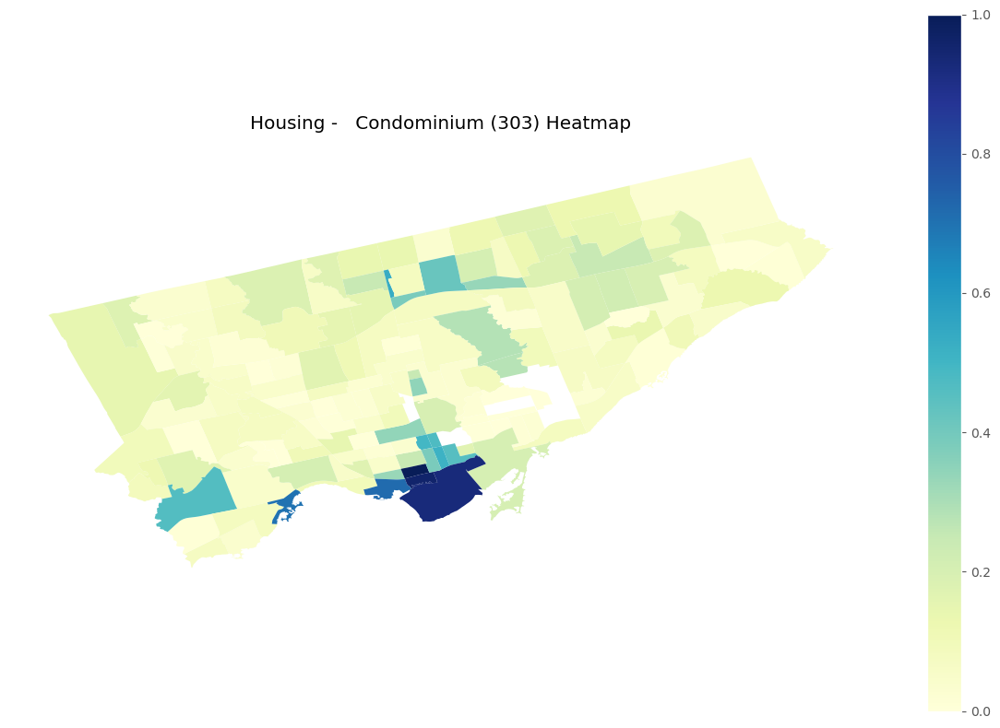

<Figure size 1200x800 with 0 Axes>

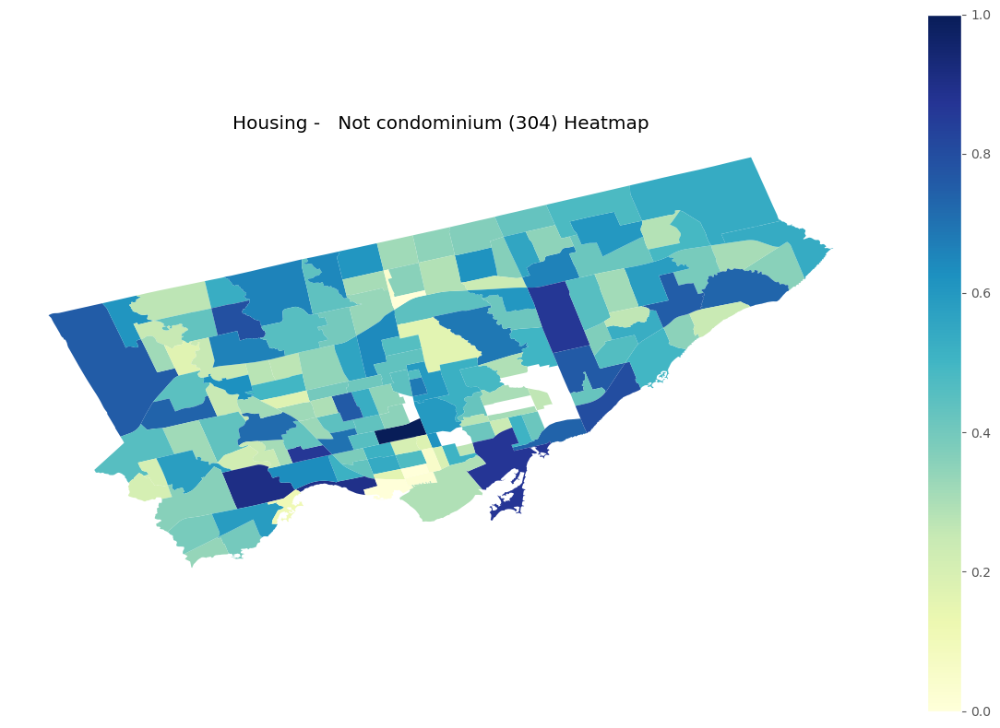

<Figure size 1200x800 with 0 Axes>

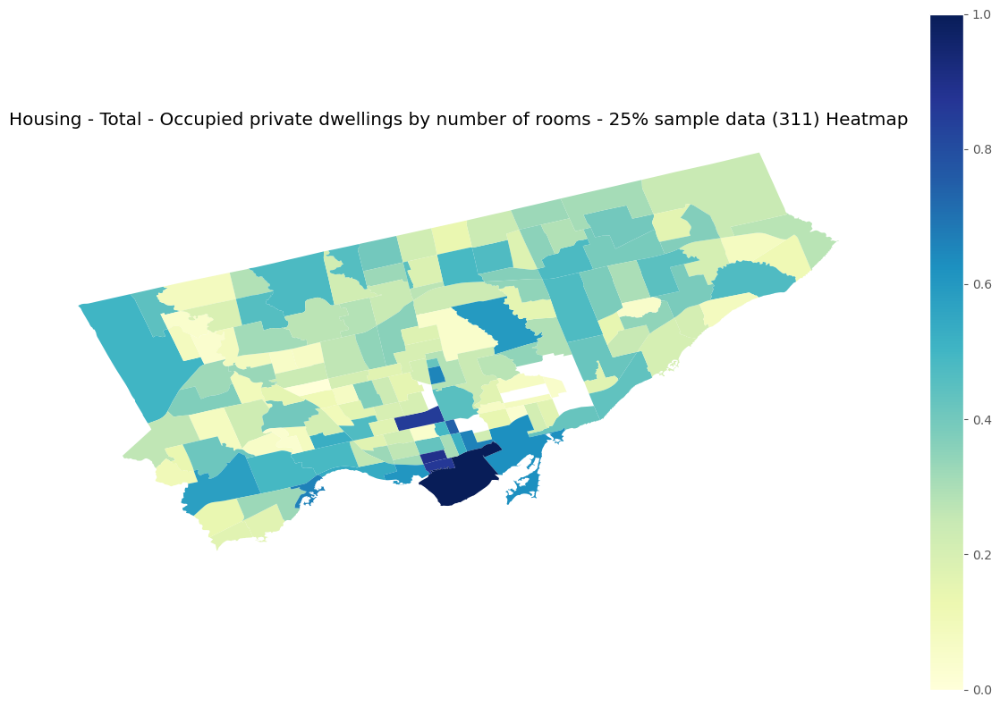

KeyboardInterrupt: 

<Figure size 1200x800 with 0 Axes>

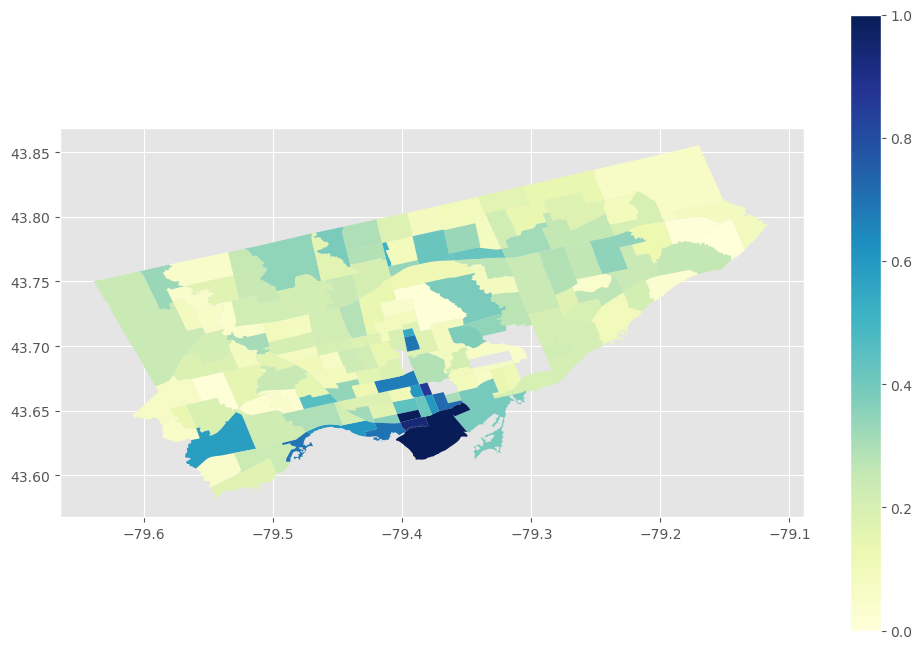

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

# Function to clean and convert columns to numeric where possible
def clean_and_convert_to_numeric(df):
    for col in df.columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')  # Convert non-numeric values to NaN
    return df

# Function to normalize data for choropleth
def normalize_data(df):
    numeric_df = df.select_dtypes(include=['number'])  # Only operate on numeric columns
    return (numeric_df - numeric_df.min()) / (numeric_df.max() - numeric_df.min())

# Function to plot heatmaps on a map
def plot_choropleths(dataframes, base_geo_column="geometry (2603)"):
    for group_name, df in dataframes.items():
        print(f"Creating choropleth map for group: {group_name}")
        
        # Convert to GeoDataFrame
        gdf = gpd.GeoDataFrame(df, geometry=df[base_geo_column])

        # Drop essential non-numeric columns
        gdf_clean = gdf.drop(columns=['Neighbourhood Number (0)', 'TSNS 2020 Designation (1)', base_geo_column], errors='ignore')

        # Clean and convert all columns to numeric
        gdf_clean = clean_and_convert_to_numeric(gdf_clean)

        # Normalize numeric data
        gdf_normalized = normalize_data(gdf_clean)

        if gdf_normalized.empty:
            print(f"No numeric data to plot for group: {group_name}")
            continue

        # Merge normalized data back to the GeoDataFrame
        gdf = pd.concat([gdf[['geometry']], gdf_normalized], axis=1)

        # Plot each column as a choropleth
        for col in gdf_normalized.columns:
            plt.figure(figsize=(12, 8))
            gdf.plot(column=col, cmap="YlGnBu", legend=True, figsize=(12, 8))
            plt.title(f"{group_name} - {col} Heatmap")
            plt.axis("off")
            plt.tight_layout()
            plt.show()

# Create choropleth maps for all groups
plot_choropleths(dataframes)
